<a href="https://colab.research.google.com/github/pooh5/Beat_classification/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mount the drive to collab so collab can access the data in the drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


# Pip install-requirements

In [ ]:


!pip install numpy
!pip install pandas
!pip install matplotlib
!pip install seaborn
!pip install librosa
!pip install scipy
!pip install pywt
!pip install pydub
!pip install scikit-posthocs
!pip install scikit-learn
!pip install xgboost
!pip install optuna
!pip install tqdm
!pip install umap-learn
!pip install IPython


ERROR: Could not find a version that satisfies the requirement pywt (from versions: none)
ERROR: No matching distribution found for pywt
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.7/242.7 kB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.7 MB/s eta 0:00:00


In [ ]:

import os
import pandas as pd

os.listdir('/content/drive/MyDrive/Neurosonic')
os.listdir('/content/drive/MyDrive/Neurosonic/Data')

df = pd.read_csv('/content/drive/MyDrive/Neurosonic/Data/Normal_timestamps.csv')



# Explore the CSV

In [ ]:
df.head()

,fname,cycle,sound event,"sample number (sampling rate = 44,100 Hz",time (s),Unnamed: 5
0,set_a/normal__201102081321.wav,1,S1,10021.0,0.227234,NaN
1,set_a/normal__201102081321.wav,1,S2,20759.0,0.470726,NaN
2,set_a/normal__201102081321.wav,2,S1,35075.0,0.795351,NaN
3,set_a/normal__201102081321.wav,2,S2,47244.0,1.071293,NaN
4,set_a/normal__201102081321.wav,3,S1,62992.0,1.428390,NaN


# Select a random file, check if mono or stereo, check sampling rate

In [ ]:
import os
import random
import librosa
from IPython.display import Audio

# Define folder path
folder_path = '/content/drive/MyDrive/Neurosonic/Data/normal/'

# List all .wav files in the folder
wav_files = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Randomly choose one file
random_file = random.choice(wav_files)
file_path = os.path.join(folder_path, random_file)

y, sr = librosa.load(file_path, sr=None, mono=False)

# Check if signal is mono or stereo
if y.ndim == 1:
    print(f"{random_file}: MONO")
else:
    print(f"{random_file}: STEREO with shape {y.shape}")

print("sampling rate", sr)
Audio(file_path)


201104122156.wav: MONO
sampling rate 44100


In [ ]:
from pydub.utils import mediainfo

info = mediainfo(file_path)
print(info)


{'index': '0', 'codec_name': 'pcm_s16le', 'codec_long_name': 'PCM signed 16-bit little-endian', 'profile': 'unknown', 'codec_type': 'audio', 'codec_tag_string': '[1][0][0][0]', 'codec_tag': '0x0001', 'sample_fmt': 's16', 'sample_rate': '44100', 'channels': '1', 'channel_layout': 'unknown', 'bits_per_sample': '16', 'id': 'N/A', 'r_frame_rate': '0/0', 'avg_frame_rate': '0/0', 'time_base': '1/44100', 'start_pts': 'N/A', 'start_time': 'N/A', 'duration_ts': '396900', 'duration': '9.000000', 'bit_rate': '705669', 'max_bit_rate': 'N/A', 'bits_per_raw_sample': 'N/A', 'nb_frames': 'N/A', 'nb_read_frames': 'N/A', 'nb_read_packets': 'N/A', 'DISPOSITION': {'default': '0', 'dub': '0', 'original': '0', 'comment': '0', 'lyrics': '0', 'karaoke': '0', 'forced': '0', 'hearing_impaired': '0', 'visual_impaired': '0', 'clean_effects': '0', 'attached_pic': '0', 'timed_thumbnails': '0'}, 'filename': '/content/drive/MyDrive/Neurosonic/Data/normal/201103101140.wav', 'nb_streams': '1', 'nb_programs': '0', 'form

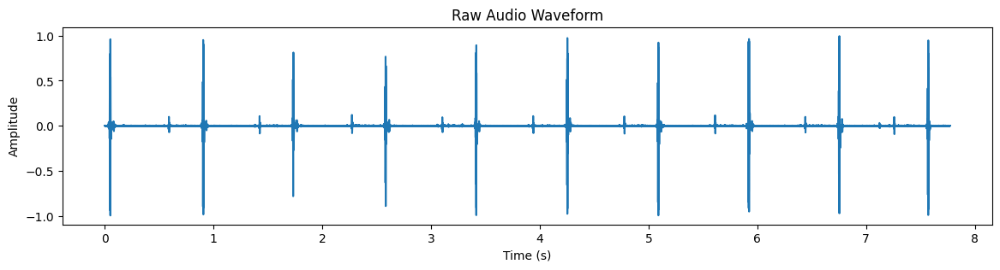

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

t = np.arange(len(y)) / sr
plt.figure(figsize=(14, 3))
plt.plot(t, y)
plt.title("Raw Audio Waveform")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.show()


# Visualize and listening to random files from each category-healthy, artifact and murmer

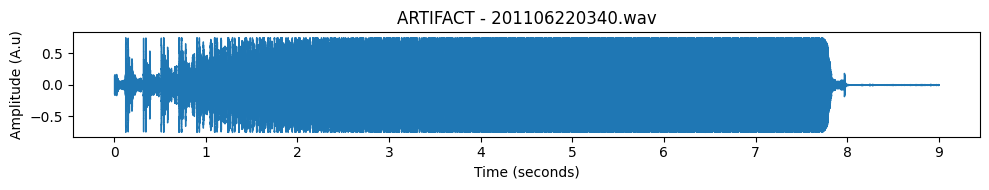

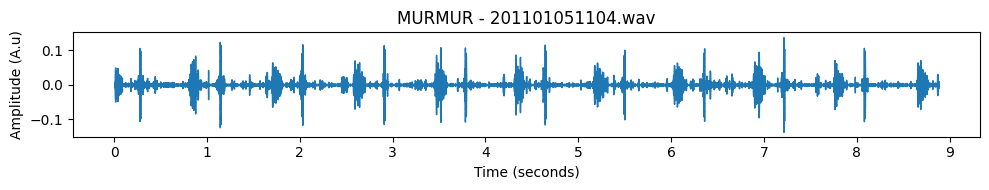

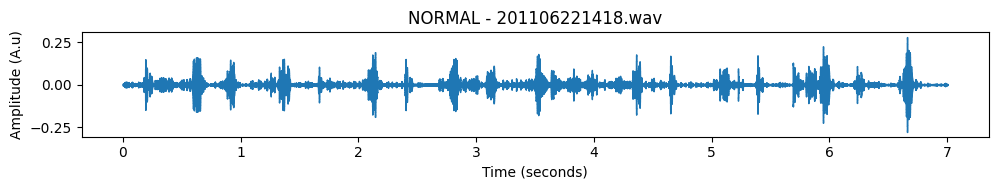


'artifact' folder: 201106212112.wav



'murmur' folder: 201108222251.wav



'normal' folder: 201102081152.wav


In [ ]:
import os
import random
from IPython.display import Audio, display

import os
import random
import librosa
import matplotlib.pyplot as plt

# Base folder path
base_path = '/content/drive/MyDrive/Neurosonic/Data'

# Folders to sample from
categories = ['artifact', 'murmur', 'normal']

# Dictionary to store one file from each
samples = {}

# Load one random .wav file from each folder
for category in categories:
    folder_path = os.path.join(base_path, category)
    wav_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.wav')]
    if wav_files:
        chosen_file = random.choice(wav_files)
        full_path = os.path.join(folder_path, chosen_file)
        y, sr = librosa.load(full_path, sr=None)
        samples[category] = (y, sr, chosen_file)

# Plot waveforms
for category, (y, sr, fname) in samples.items():
    plt.figure(figsize=(10, 2))
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"{category.upper()} - {fname}")
    plt.xlabel("Time (seconds)")
    plt.ylabel("Amplitude (A.u)")
    plt.tight_layout()
    plt.show()



# Randomly pick and play one .wav file from each category
for category in categories:
    folder_path = os.path.join(base_path, category)
    wav_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.wav')]

    if wav_files:
        chosen_file = random.choice(wav_files)
        full_path = os.path.join(folder_path, chosen_file)
        print(f"\n'{category}' folder: {chosen_file}")
        display(Audio(full_path))
    else:
        print(f"No .wav files found in {category}")

# FFT visualization-artifact, murmur, normal

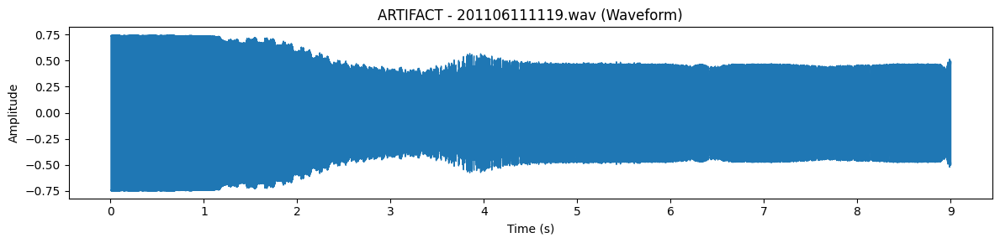

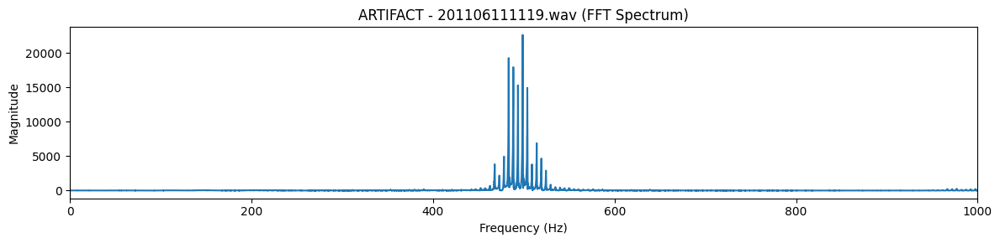

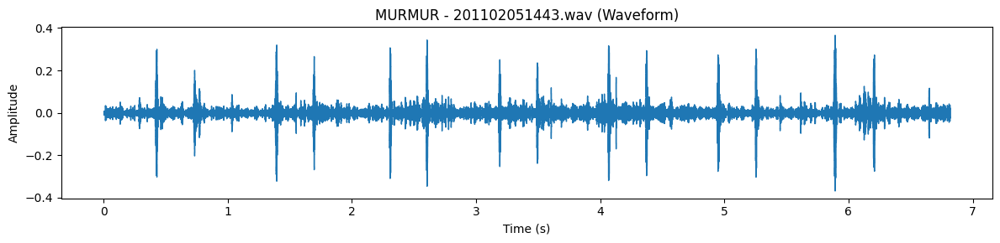

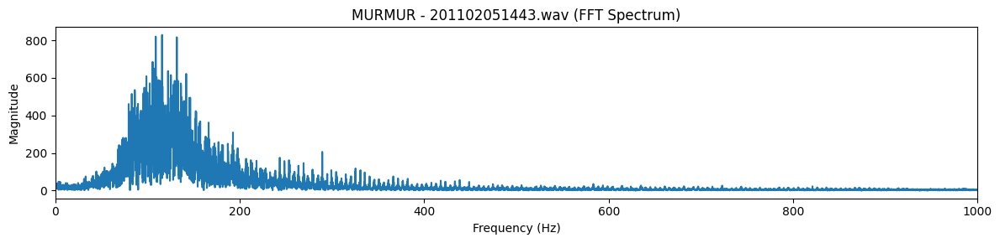

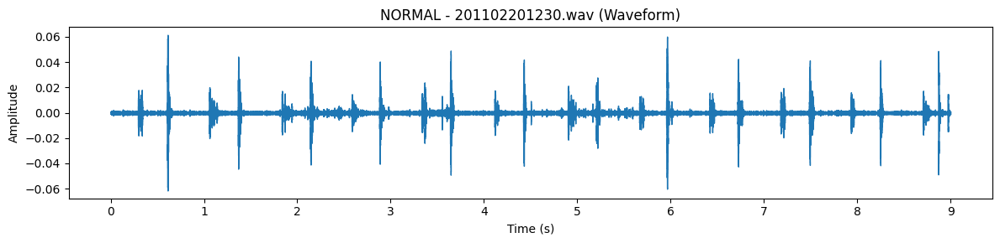

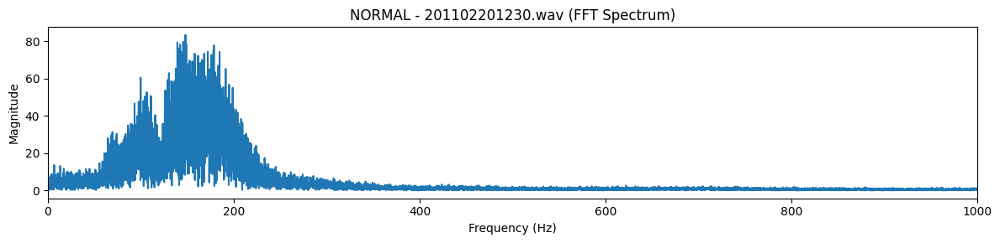

In [ ]:
import numpy as np

# Plot waveforms and FFTs
for category, (y, sr, fname) in samples.items():
    t = np.arange(len(y)) / sr

    # Waveform plot
    plt.figure(figsize=(12, 3))
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"{category.upper()} - {fname} (Waveform)")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.tight_layout()
    plt.show()

    # FFT plot
    Y = np.abs(np.fft.rfft(y))
    freqs = np.fft.rfftfreq(len(y), 1 / sr)

    plt.figure(figsize=(12, 3))
    plt.plot(freqs, Y)
    plt.title(f"{category.upper()} - {fname} (FFT Spectrum)")
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.xlim(0, 1000)  # Limit to 0–1000 Hz for better resolution in heart sound range
    plt.tight_layout()
    plt.show()

# Objective 1 : Experimenting with Shannon, Hilbert and wavelet transforms to detect the envelopes in a random file from normal folder

Selected file: 201103140822.wav


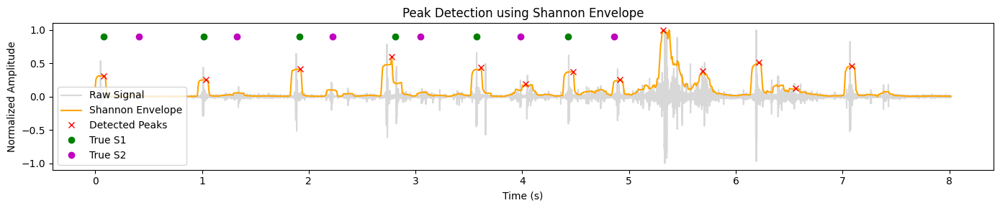

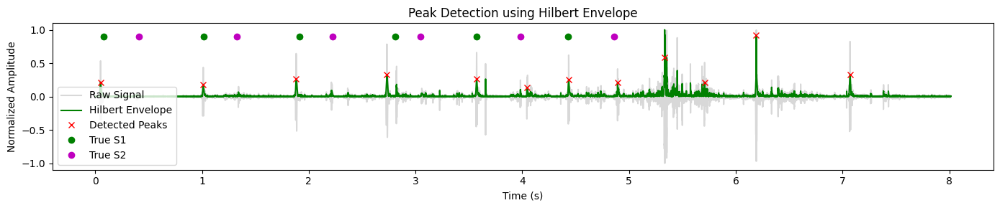

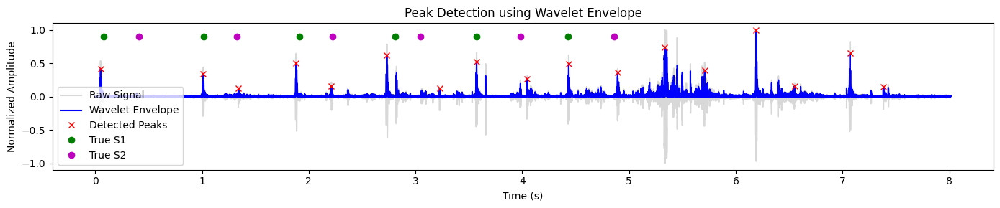


 Shannon Envelope:
Matched S1: 5 / 6
Matched S2: 0 / 6

 Hilbert Envelope:
Matched S1: 5 / 6
Matched S2: 1 / 6

 Wavelet Envelope:
Matched S1: 5 / 6
Matched S2: 3 / 6


In [ ]:
import os
import random
import numpy as np
import pandas as pd
import librosa
import matplotlib.pyplot as plt
from scipy.signal import hilbert, find_peaks
import pywt

# Location of the data
normal_folder = '/content/drive/MyDrive/Neurosonic/Data/normal'
csv_path = '/content/drive/MyDrive/Neurosonic/Data/Normal_timestamps.csv'

# Load the CSB
df = pd.read_csv(csv_path)
df.columns = df.columns.str.strip()
df['fname'] = df['fname'].astype(str).str.replace('set_a/normal__', '', regex=False).str.strip()
df['sound event'] = df['sound event'].astype(str).str.strip().str.upper()

## Helper functions ##
#Get the envelops
def get_all_envelopes_and_peaks(y, sr):
    # Shannon envelope
    energy = y**2
    energy[energy == 0] = 1e-10
    shannon = -energy * np.log(energy)
    kernel = np.ones(int(0.1 * sr)) / int(0.1 * sr)
    shannon_env = np.convolve(shannon, kernel, mode='same')
    shannon_env /= np.max(shannon_env)
    peaks_shannon, _ = find_peaks(shannon_env, distance=int(0.25 * sr), height=0.1)

    # Hilbert envelope
    hilbert_env = np.abs(hilbert(y))
    hilbert_env /= np.max(hilbert_env)
    peaks_hilbert, _ = find_peaks(hilbert_env, distance=int(0.25 * sr), height=0.1)

    # Wavelet envelope (db4, level 4)
    coeffs = pywt.wavedec(y, 'db4', level=4)
    approx = coeffs[0]
    wavelet_env = np.abs(pywt.upcoef('a', approx, 'db4', level=4, take=len(y)))
    wavelet_env /= np.max(wavelet_env)
    peaks_wavelet, _ = find_peaks(wavelet_env, distance=int(0.25 * sr), height=0.1)

    return {
        'Shannon': shannon_env,
        'Hilbert': hilbert_env,
        'Wavelet': wavelet_env
    }, {
        'Shannon': peaks_shannon / sr,
        'Hilbert': peaks_hilbert / sr,
        'Wavelet': peaks_wavelet / sr
    }

# Plotting functions
def plot_with_true_events(y, sr, s1_times, s2_times, env_dict, peaks_dict):
    t = np.arange(len(y)) / sr
    colors = {'Shannon': 'orange', 'Hilbert': 'green', 'Wavelet': 'blue'}

    for label in ['Shannon', 'Hilbert', 'Wavelet']:
        env = env_dict[label]
        peaks = peaks_dict[label]

        plt.figure(figsize=(14, 3))
        plt.plot(t, y / np.max(np.abs(y)), alpha=0.3, label='Raw Signal', color='gray')
        plt.plot(t, env, label=f'{label} Envelope', color=colors[label])
        plt.plot(peaks, env[(peaks * sr).astype(int)], 'rx', label='Detected Peaks')
        plt.plot(s1_times, np.ones_like(s1_times) * 0.9, 'go', label='True S1')
        plt.plot(s2_times, np.ones_like(s2_times) * 0.9, 'mo', label='True S2')
        plt.title(f"Peak Detection using {label} Envelope")
        plt.xlabel("Time (s)")
        plt.ylabel("Normalized Amplitude")
        plt.legend()
        plt.tight_layout()
        plt.show()

# Helper: Match true events to predicted
def match_peaks(true_times, detected, tolerance=0.04):
    return [tt for tt in true_times if np.any(np.abs(detected - tt) <= tolerance)]

## Main: Random file selection, envelop detection and olotting
all_files = [f for f in os.listdir(normal_folder) if f.endswith('.wav')]
file = random.choice(all_files)
print(f"Selected file: {file}")

file_path = os.path.join(normal_folder, file)
y, sr = librosa.load(file_path, sr=44100)

# Load true S1 and S2 times
events = df[df['fname'] == file]
s1 = events[events['sound event'] == 'S1']['time (s)'].values
s2 = events[events['sound event'] == 'S2']['time (s)'].values

# Get envelopes and peak detections
envelopes, peaks = get_all_envelopes_and_peaks(y, sr)

# Plot all envelopes with ground truth
plot_with_true_events(y, sr, s1, s2, envelopes, peaks)

# Print matching stats
for method in peaks:
    matched_s1 = match_peaks(s1, peaks[method])
    matched_s2 = match_peaks(s2, peaks[method])
    print(f"\n {method} Envelope:")
    print(f"Matched S1: {len(matched_s1)} / {len(s1)}")
    print(f"Matched S2: {len(matched_s2)} / {len(s2)}")


# Objective 1: Results.                                               Experiments with Hilbert- on normal files, tuned distance between the peaks and the min height, F1 Score     : 0.8639 on normal files. MAE= 0.0106 s. Used normal files that had the timing info s1 and s2 in csv

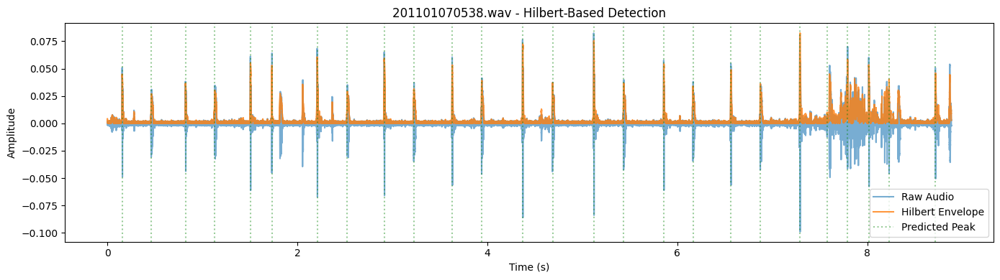

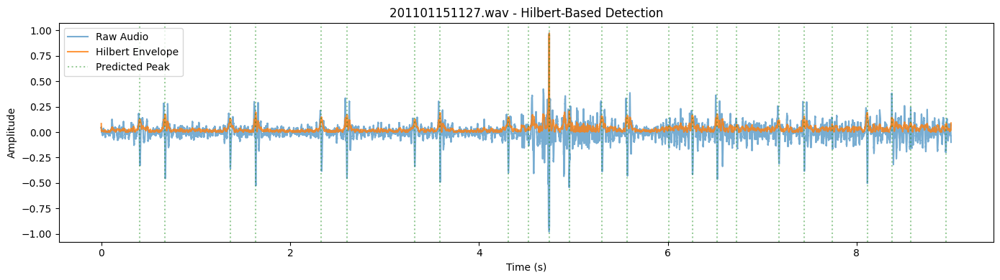

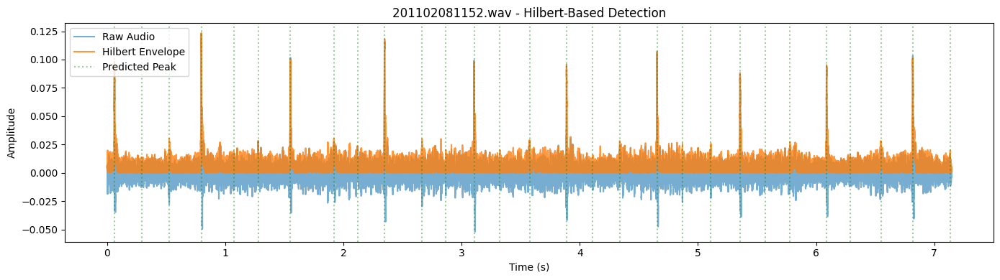

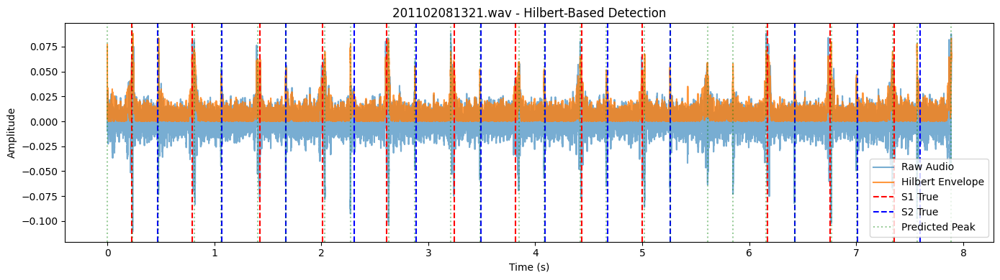

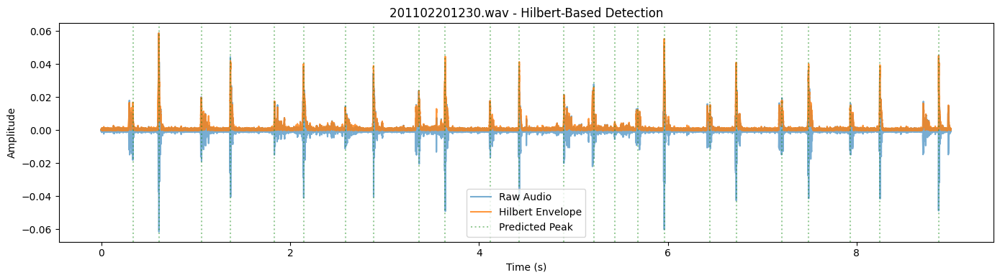

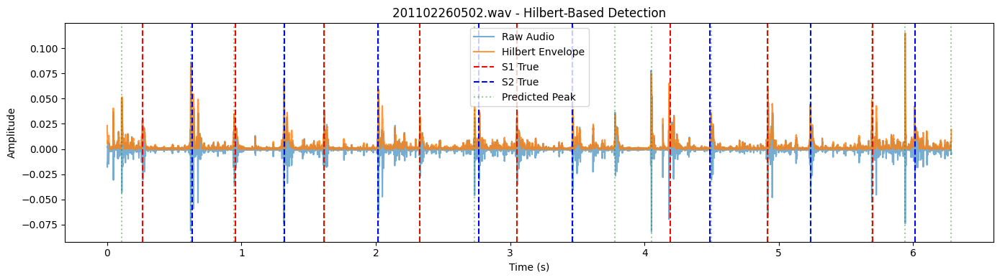

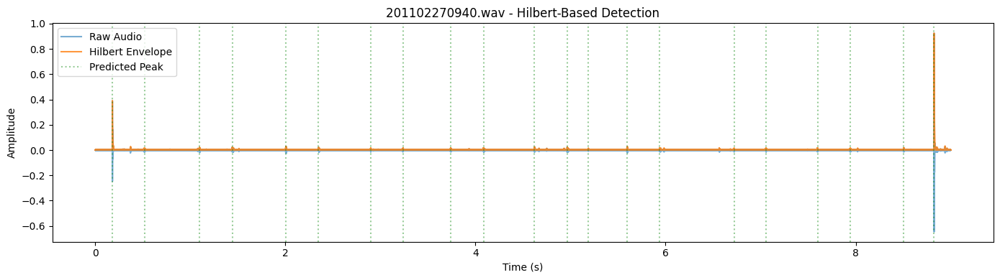

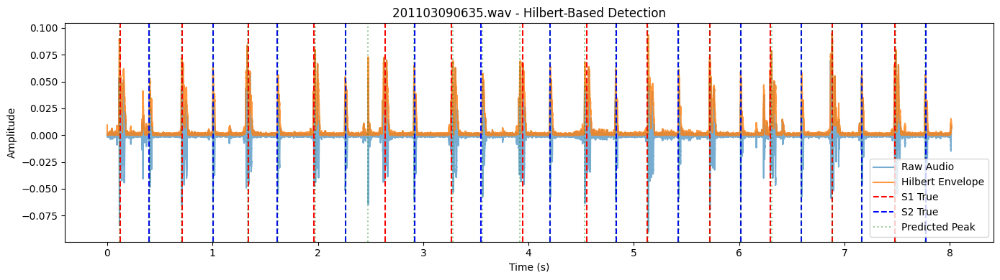

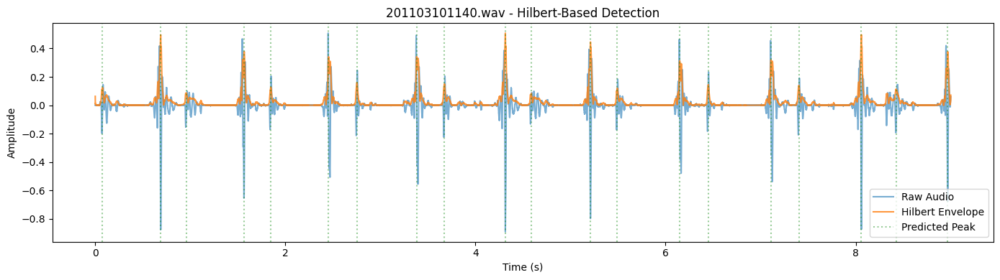

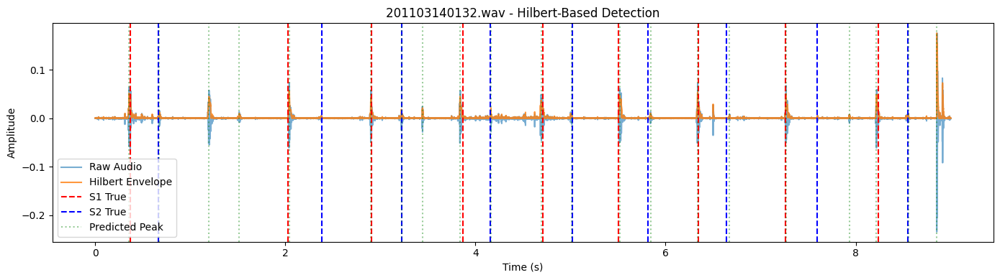

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


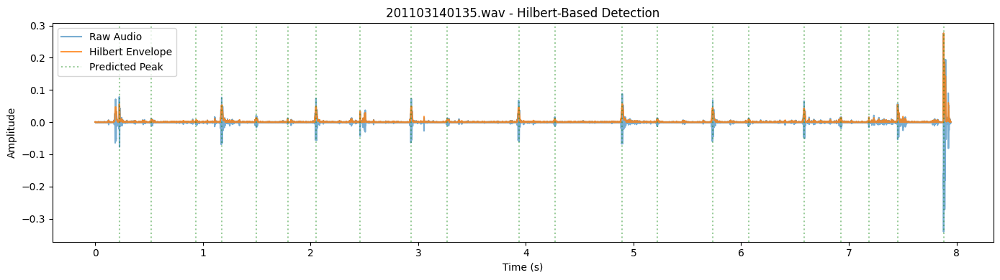

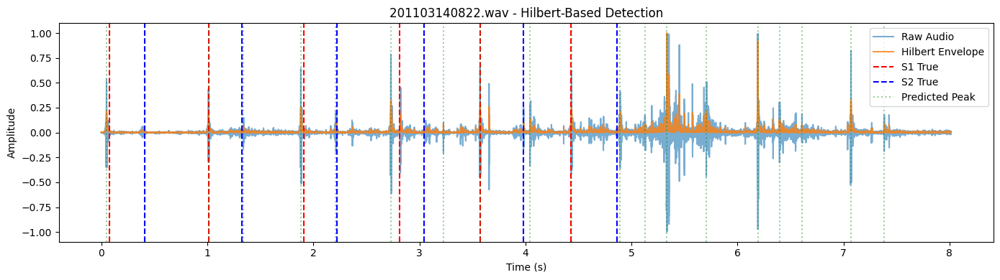

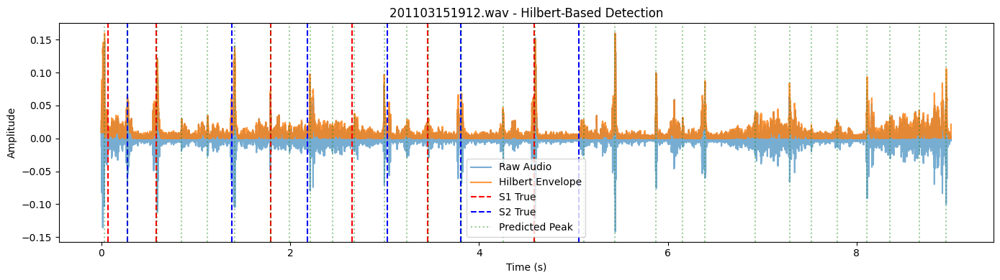

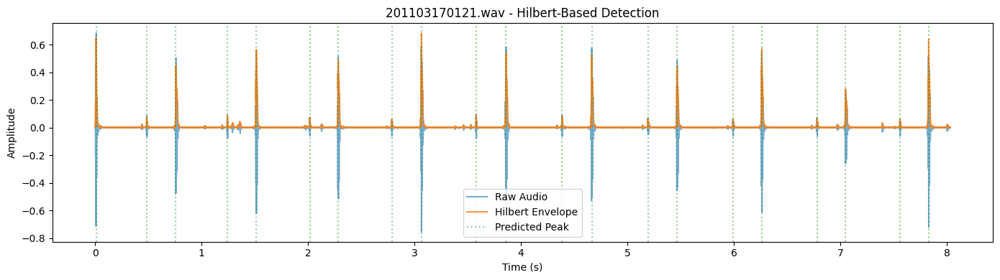

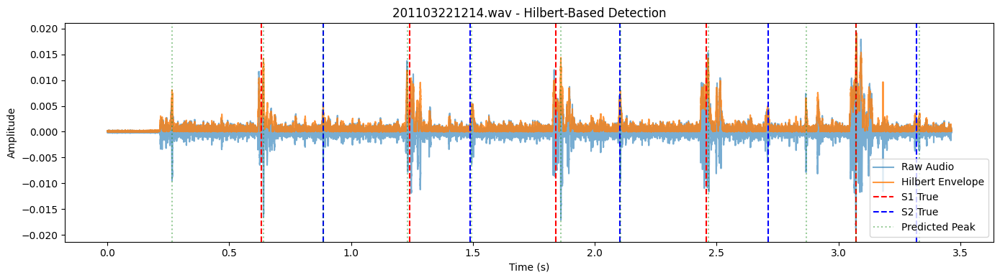

...

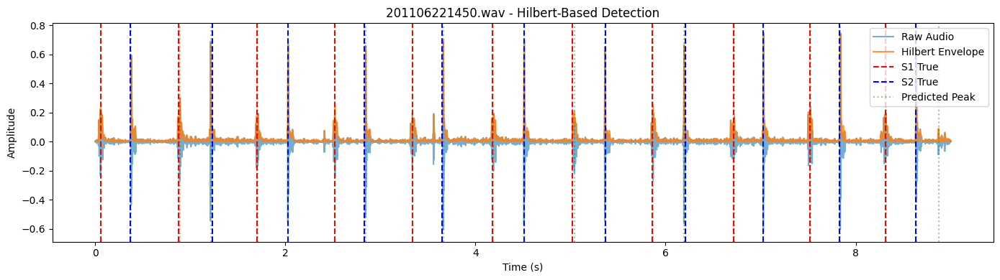

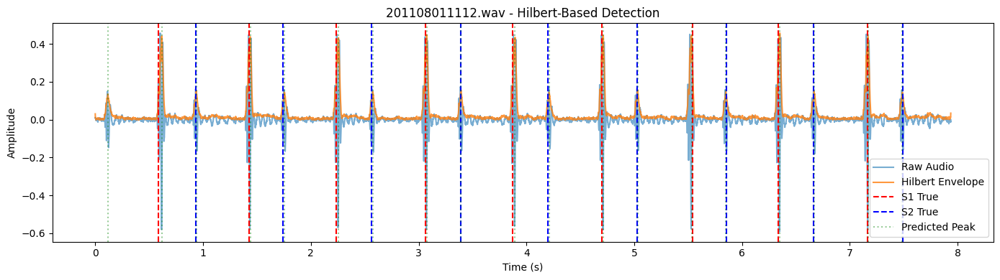

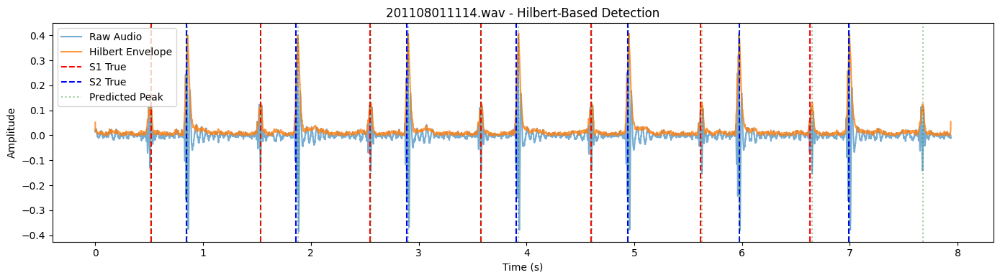

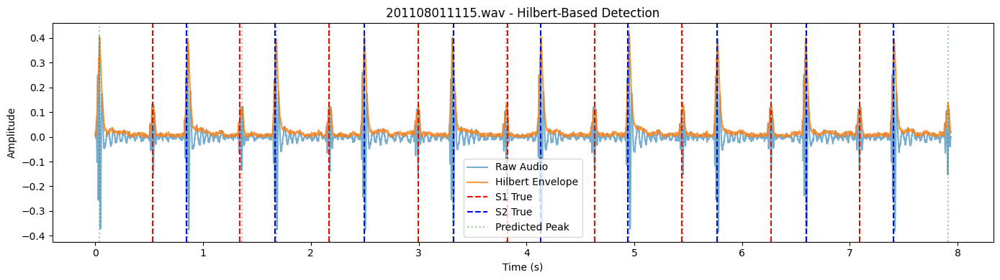

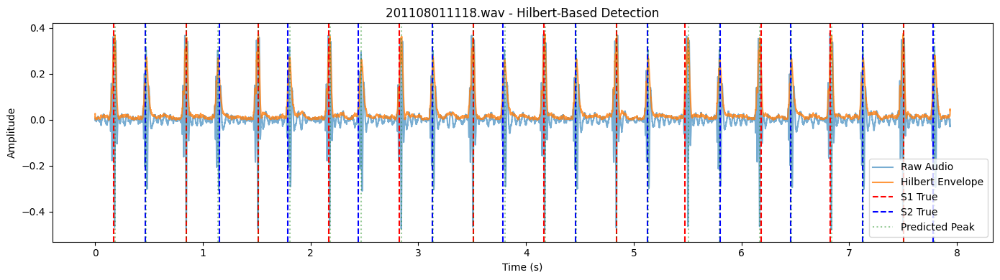


 Filtered Performance (Files with Ground Truth Only):
Matched S1: 184/195 (94.36%)
Matched S2: 181/195 (92.82%)

 Timing Error Summary:
S1 MAE: 0.0109 s | STD: 0.0085 s
S2 MAE: 0.0103 s | STD: 0.0087 s

 Overall Performance Metrics:
Accuracy     : 0.7604
Precision    : 0.8022
Recall       : 0.9359
F1 Score     : 0.8639
MAE          : 0.0106 s
RMSE         : 0.0137 s
Median Error : 0.0088 s
Std. Deviation: 0.0086 s


In [ ]:
import os
import numpy as np
import pandas as pd
import librosa
import matplotlib.pyplot as plt
from scipy.signal import hilbert, find_peaks

# Paths
normal_folder = '/content/drive/MyDrive/Neurosonic/Data/normal'
csv_path = '/content/drive/MyDrive/Neurosonic/Data/Normal_timestamps.csv'

# Load and clean the CSV
df = pd.read_csv(csv_path)
df.columns = df.columns.str.strip()
df['fname'] = df['fname'].astype(str).str.replace('set_a/normal__', '', regex=False).str.strip()
df['sound event'] = df['sound event'].astype(str).str.strip().str.upper()

# Matching function with timing error
def match_peaks(true_times, detected, tolerance=0.04):
    matched = []
    errors = []
    for tt in true_times:
        diffs = np.abs(detected - tt)
        if len(diffs) > 0:
            min_diff = np.min(diffs)
            if min_diff <= tolerance:
                matched.append(tt)
                errors.append(min_diff)
    return matched, errors

# Hilbert-based envelope and peak detection
def detect_peaks_from_audio(y, sr):
    analytic = hilbert(y)
    envelope = np.abs(analytic)
    envelope = envelope / np.max(envelope)

    min_distance = int(0.20 * sr)
    # min_height = 0.07
    threshold = np.mean(envelope) + 0.6 * np.std(envelope)
    peaks, _ = find_peaks(envelope, distance=min_distance, height=threshold)
    # peaks, _ = find_peaks(envelope, distance=min_distance, height=min_height)
    return peaks / sr, envelope

# Evaluation and plotting loop
results = []
s1_errors_all = []
s2_errors_all = []

all_files = [f for f in os.listdir(normal_folder) if f.endswith('.wav')]

for file_id in sorted(all_files):
    file_path = os.path.join(normal_folder, file_id)
    try:
        y, sr = librosa.load(file_path, sr=44100)
        peak_times, envelope = detect_peaks_from_audio(y, sr)

        events = df[df['fname'] == file_id]
        s1_times = events[events['sound event'] == 'S1']['time (s)'].values
        s2_times = events[events['sound event'] == 'S2']['time (s)'].values

        matched_s1, s1_errors = match_peaks(s1_times, peak_times)
        matched_s2, s2_errors = match_peaks(s2_times, peak_times)

        results.append({
            'file': file_id,
            'true_s1': len(s1_times),
            'true_s2': len(s2_times),
            'pred_peaks': len(peak_times),
            'matched_s1': len(matched_s1),
            'matched_s2': len(matched_s2)
        })

        s1_errors_all.extend(s1_errors)
        s2_errors_all.extend(s2_errors)

        # Plot
        time_axis = np.arange(len(y)) / sr
        plt.figure(figsize=(14, 4))
        plt.plot(time_axis, y, label='Raw Audio', alpha=0.6)
        plt.plot(time_axis, envelope * max(y), label='Hilbert Envelope', alpha=0.8)

        for t in s1_times:
            plt.axvline(t, color='red', linestyle='--', label='S1 True' if 'S1 True' not in plt.gca().get_legend_handles_labels()[1] else "")
        for t in s2_times:
            plt.axvline(t, color='blue', linestyle='--', label='S2 True' if 'S2 True' not in plt.gca().get_legend_handles_labels()[1] else "")
        for t in peak_times:
            plt.axvline(t, color='green', linestyle=':', alpha=0.4, label='Predicted Peak' if 'Predicted Peak' not in plt.gca().get_legend_handles_labels()[1] else "")

        plt.title(f'{file_id} - Hilbert-Based Detection')
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.legend()
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Error procesing {file_id}: {e}")

# Summary
df_results = pd.DataFrame(results)

# Filter files with ground truth S1 and S2
df_eval = df_results[(df_results['true_s1'] > 0) & (df_results['true_s2'] > 0)]

# Accuracy
total_s1 = df_eval['true_s1'].sum()
total_s2 = df_eval['true_s2'].sum()
total_matched_s1 = df_eval['matched_s1'].sum()
total_matched_s2 = df_eval['matched_s2'].sum()

print("\n Filtered Performance (Files with Ground Truth Only):")
print(f"Matched S1: {total_matched_s1}/{total_s1} ({(total_matched_s1/total_s1)*100:.2f}%)")
print(f"Matched S2: {total_matched_s2}/{total_s2} ({(total_matched_s2/total_s2)*100:.2f}%)")

# Timing error
s1_mae = np.mean(s1_errors_all)
s1_std = np.std(s1_errors_all)
s2_mae = np.mean(s2_errors_all)
s2_std = np.std(s2_errors_all)

print("\n Timing Error Summary:")
print(f"S1 MAE: {s1_mae:.4f} s | STD: {s1_std:.4f} s")
print(f"S2 MAE: {s2_mae:.4f} s | STD: {s2_std:.4f} s")



# Total predicted = number of detected peaks
total_predicted = df_eval['pred_peaks'].sum()
true_positives = total_matched_s1 + total_matched_s2
false_positives = total_predicted - true_positives
false_negatives = (total_s1 + total_s2) - true_positives

# Precision, Recall, Accuracy, F1
precision = true_positives / (true_positives + false_positives + 1e-10)
recall = true_positives / (true_positives + false_negatives + 1e-10)
accuracy = true_positives / (true_positives + false_positives + false_negatives + 1e-10)
f1_score = 2 * precision * recall / (precision + recall + 1e-10)

# Timing error metrics
all_errors = np.array(s1_errors_all + s2_errors_all)
mae = np.mean(all_errors)
rmse = np.sqrt(np.mean(all_errors**2))
median_error = np.median(all_errors)
std_dev = np.std(all_errors)

# Print the summary
print("\n Overall Performance Metrics:")
print(f"Accuracy     : {accuracy:.4f}")
print(f"Precision    : {precision:.4f}")
print(f"Recall       : {recall:.4f}")
print(f"F1 Score     : {f1_score:.4f}")
print(f"MAE          : {mae:.4f} s")
print(f"RMSE         : {rmse:.4f} s")
print(f"Median Error : {median_error:.4f} s")
print(f"Std. Deviation: {std_dev:.4f} s")



# Testing the hilbert on artifact and murmur files- Good for S1 and S2 timings on murmur too, messed up for artifacts

 Murmur files:


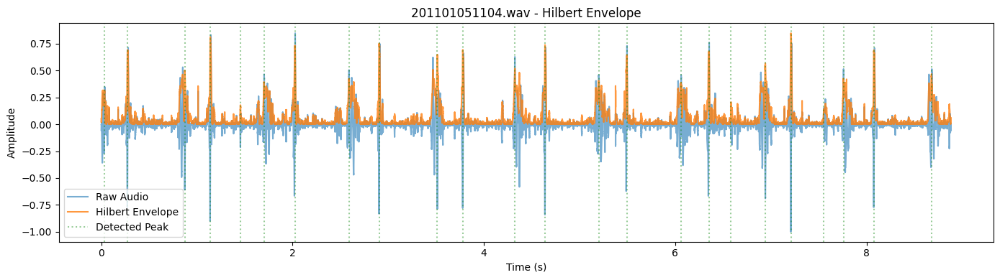

201101051104.wav - First 10 peak times (s): [0.034 0.275 0.873 1.14  1.455 1.702 2.026 2.589 2.906 3.514]


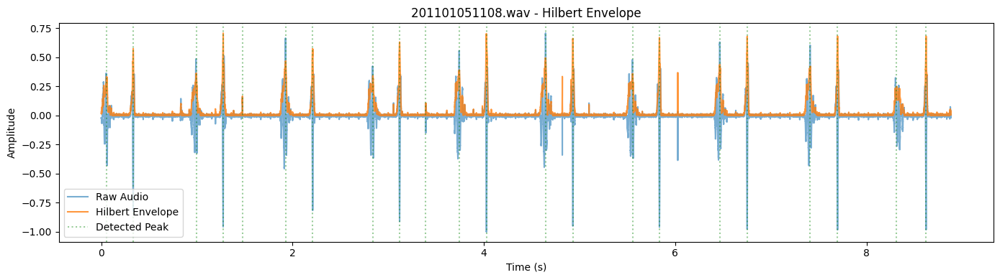

201101051108.wav - First 10 peak times (s): [0.055 0.334 0.993 1.275 1.476 1.928 2.209 2.839 3.119 3.393]


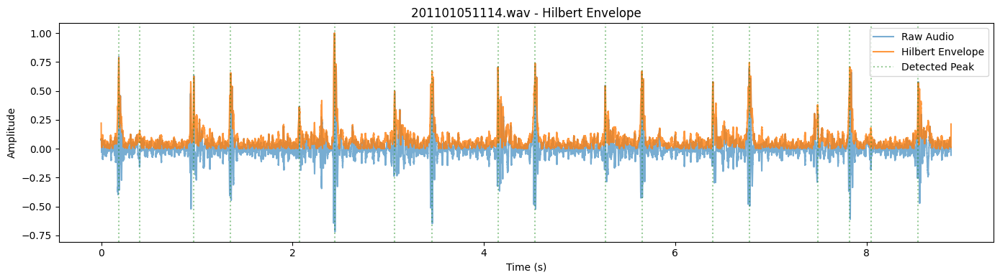

201101051114.wav - First 10 peak times (s): [0.184 0.402 0.969 1.354 2.07  2.439 3.067 3.458 4.148 4.537]


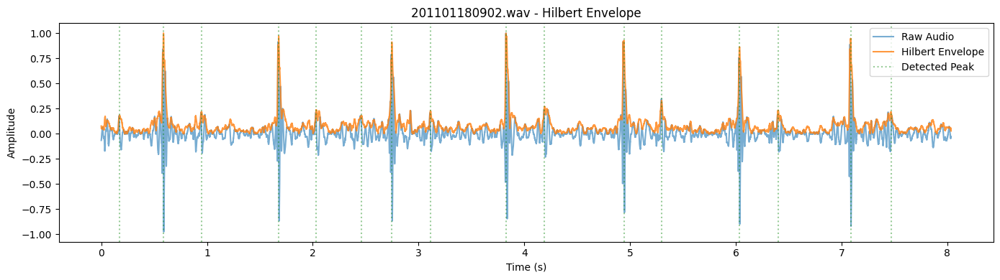

201101180902.wav - First 10 peak times (s): [0.173 0.588 0.948 1.677 2.033 2.46  2.747 3.112 3.826 4.192]


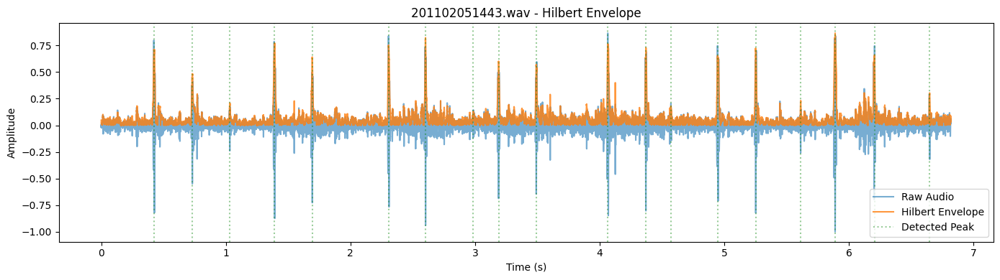

201102051443.wav - First 10 peak times (s): [0.423 0.731 1.031 1.391 1.693 2.306 2.602 2.985 3.189 3.491]


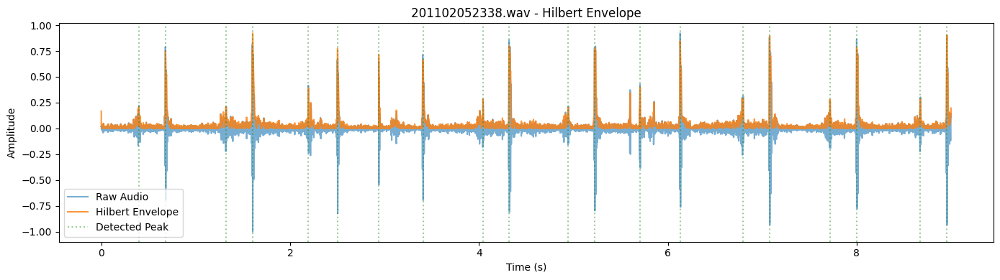

201102052338.wav - First 10 peak times (s): [0.398 0.68  1.32  1.603 2.194 2.503 2.94  3.408 4.042 4.321]


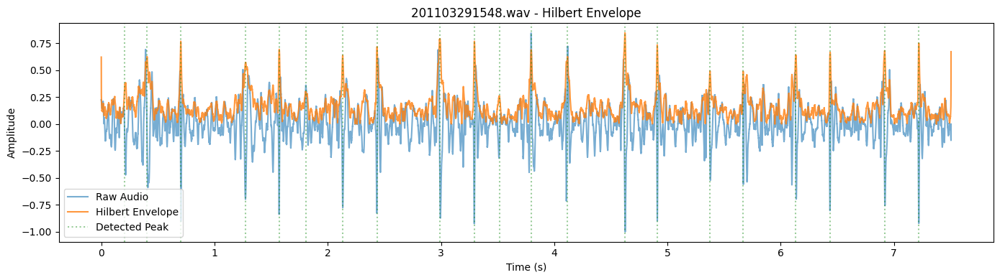

201103291548.wav - First 10 peak times (s): [0.205 0.405 0.702 1.275 1.572 1.805 2.132 2.435 2.991 3.295]


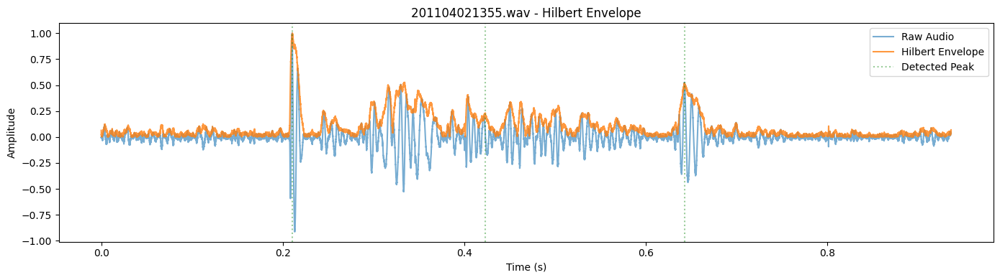

201104021355.wav - First 10 peak times (s): [0.211 0.423 0.642]


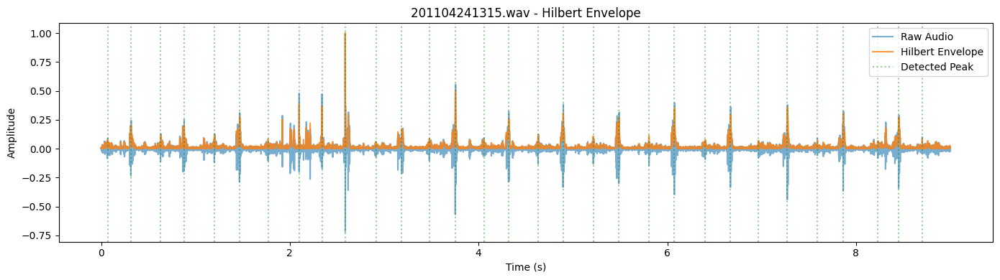

201104241315.wav - First 10 peak times (s): [0.071 0.317 0.631 0.879 1.202 1.467 1.769 2.099 2.341 2.587]


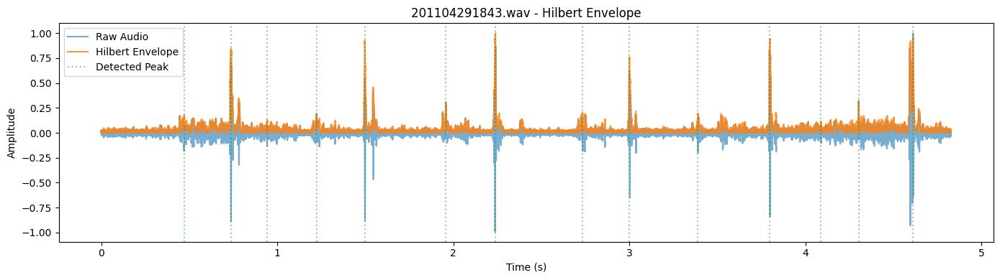

201104291843.wav - First 10 peak times (s): [0.471 0.737 0.942 1.223 1.497 1.957 2.239 2.733 3.    3.389]


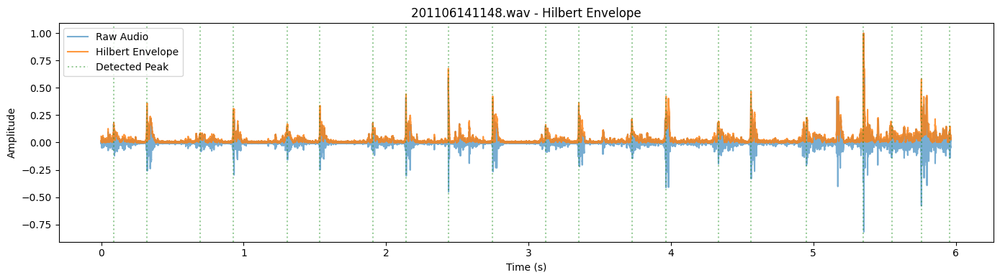

201106141148.wav - First 10 peak times (s): [0.089 0.322 0.696 0.928 1.306 1.536 1.908 2.14  2.437 2.749]


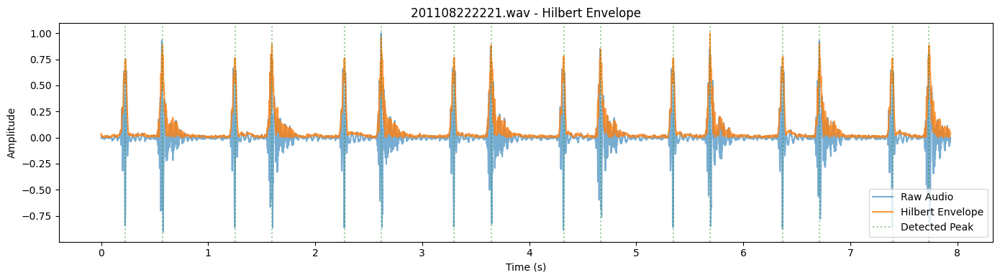

201108222221.wav - First 10 peak times (s): [0.228 0.574 1.252 1.596 2.275 2.617 3.299 3.645 4.323 4.667]


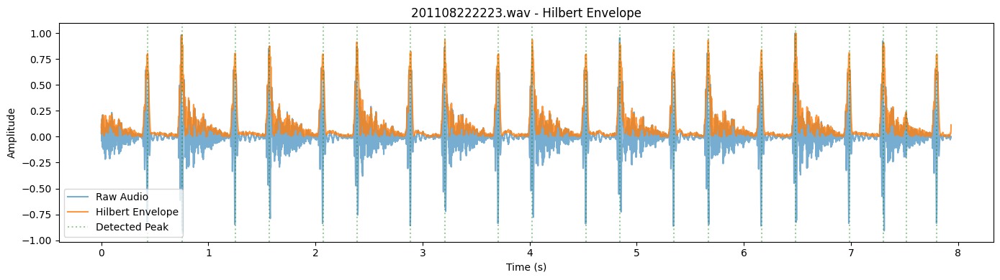

201108222223.wav - First 10 peak times (s): [0.433 0.754 1.251 1.571 2.071 2.386 2.89  3.209 3.709 4.025]


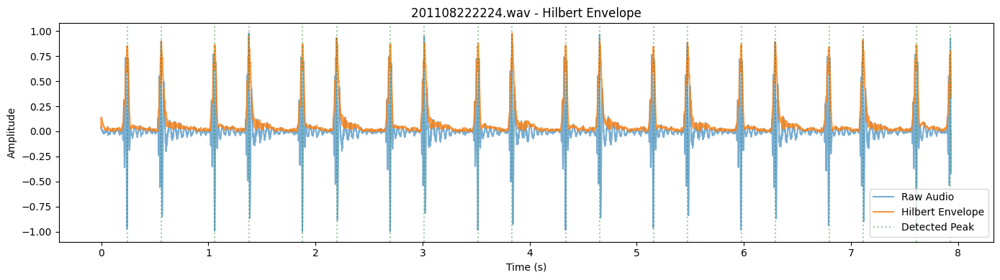

201108222224.wav - First 10 peak times (s): [0.244 0.56  1.058 1.379 1.877 2.198 2.701 3.017 3.52  3.836]


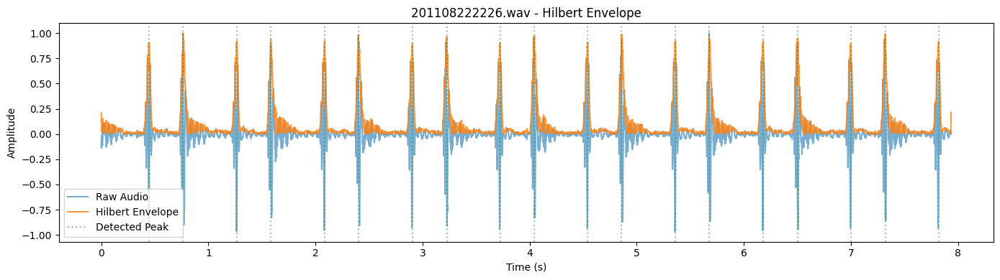

201108222226.wav - First 10 peak times (s): [0.448 0.763 1.267 1.583 2.086 2.401 2.905 3.227 3.724 4.045]


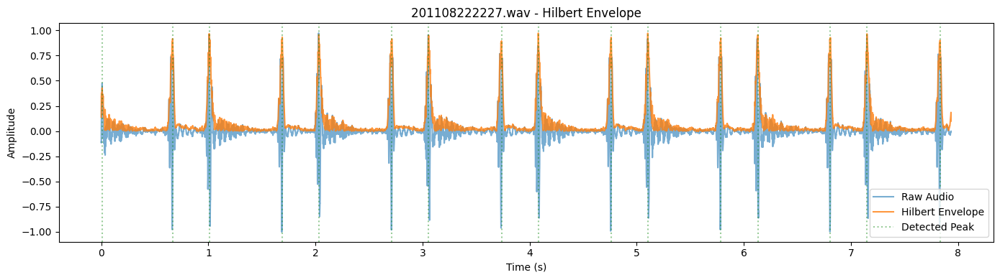

201108222227.wav - First 10 peak times (s): [0.008 0.666 1.008 1.69  2.031 2.714 3.058 3.737 4.081 4.761]


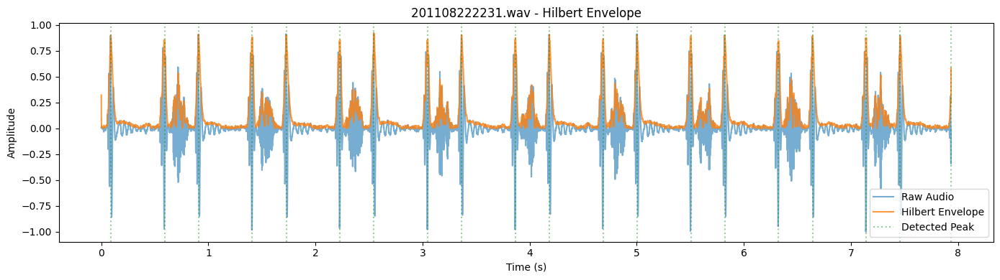

201108222231.wav - First 10 peak times (s): [0.089 0.591 0.908 1.41  1.727 2.229 2.546 3.048 3.365 3.868]


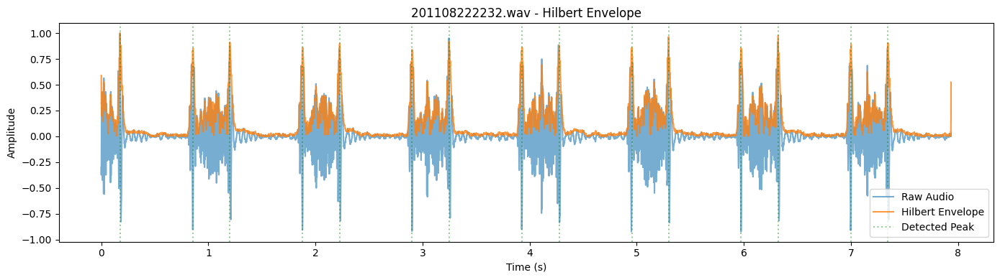

201108222232.wav - First 10 peak times (s): [0.176 0.857 1.2   1.881 2.226 2.901 3.248 3.93  4.277 4.954]


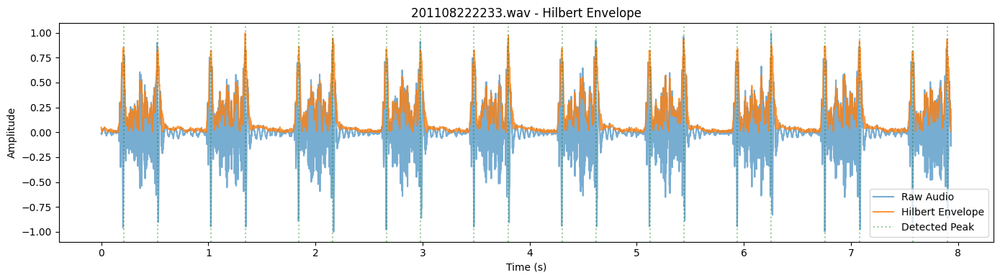

201108222233.wav - First 10 peak times (s): [0.207 0.527 1.026 1.344 1.845 2.162 2.664 2.98  3.479 3.801]


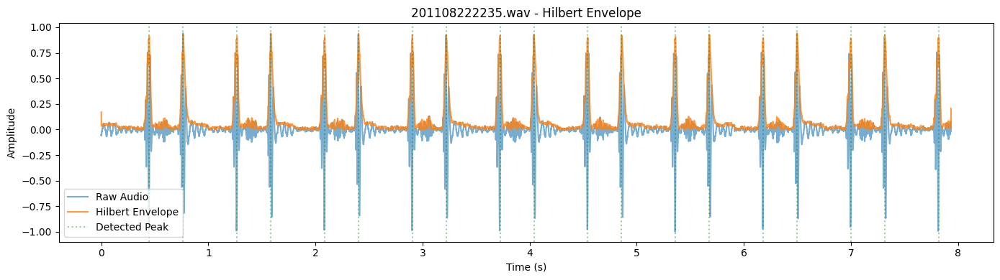

201108222235.wav - First 10 peak times (s): [0.448 0.764 1.267 1.584 2.086 2.403 2.905 3.222 3.724 4.041]


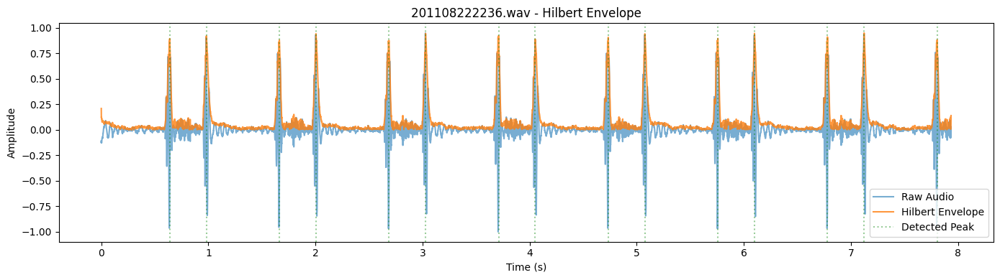

201108222236.wav - First 10 peak times (s): [0.639 0.981 1.663 2.005 2.687 3.028 3.71  4.053 4.734 5.076]


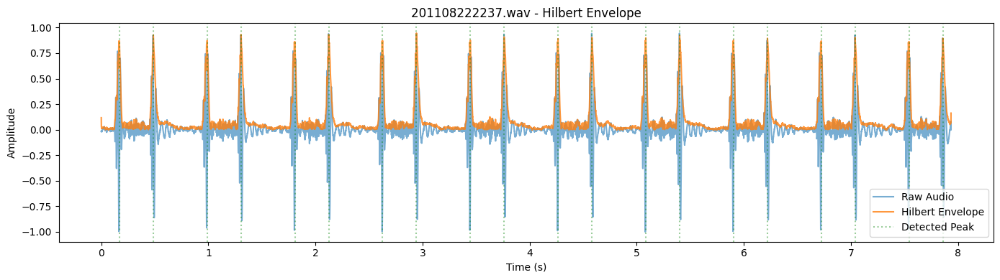

201108222237.wav - First 10 peak times (s): [0.169 0.486 0.988 1.305 1.808 2.124 2.627 2.944 3.446 3.763]


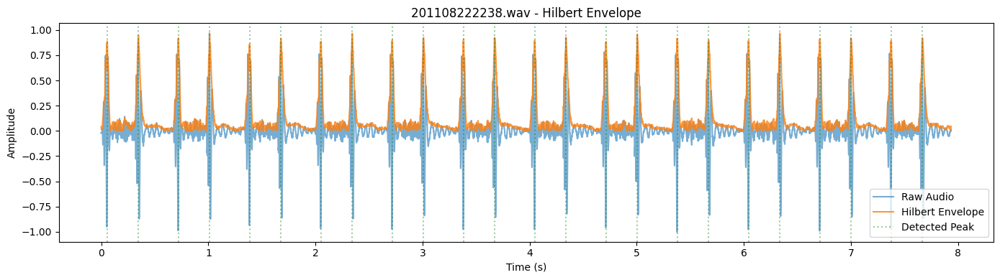

201108222238.wav - First 10 peak times (s): [0.055 0.347 0.721 1.011 1.387 1.678 2.052 2.344 2.718 3.009]


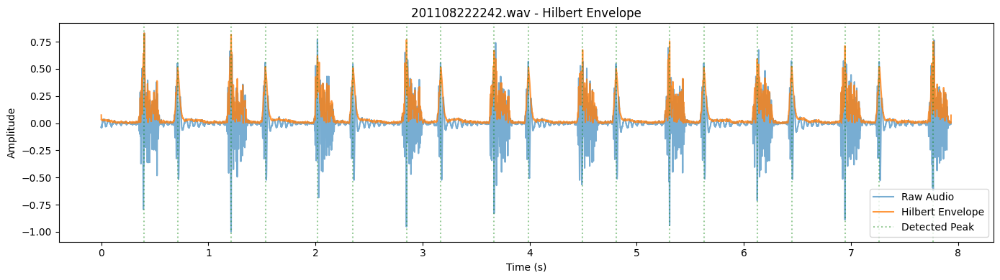

201108222242.wav - First 10 peak times (s): [0.401 0.713 1.213 1.533 2.019 2.351 2.85  3.17  3.668 3.99 ]


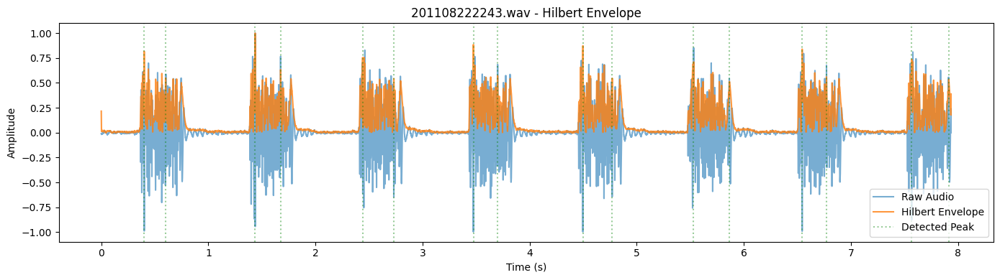

201108222243.wav - First 10 peak times (s): [0.401 0.601 1.437 1.675 2.441 2.732 3.475 3.701 4.498 4.772]


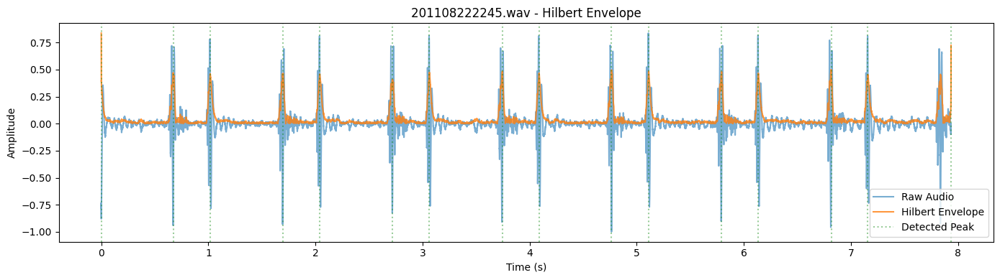

201108222245.wav - First 10 peak times (s): [0.    0.672 1.017 1.698 2.04  2.721 3.065 3.745 4.089 4.764]


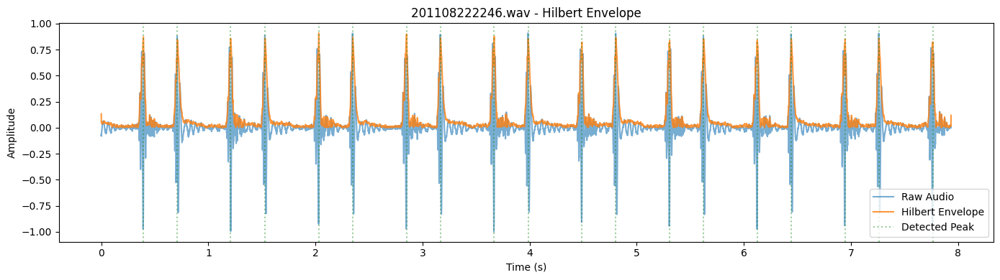

201108222246.wav - First 10 peak times (s): [0.393 0.71  1.208 1.53  2.032 2.348 2.851 3.168 3.669 3.986]


<ipython-input-50-2865518297>:42: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


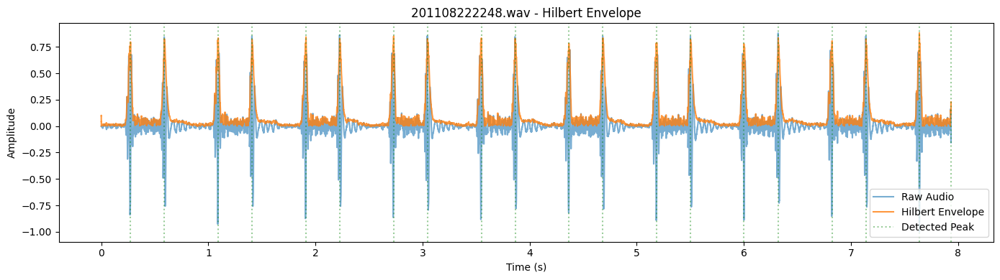

201108222248.wav - First 10 peak times (s): [0.273 0.589 1.092 1.408 1.912 2.227 2.73  3.046 3.549 3.865]


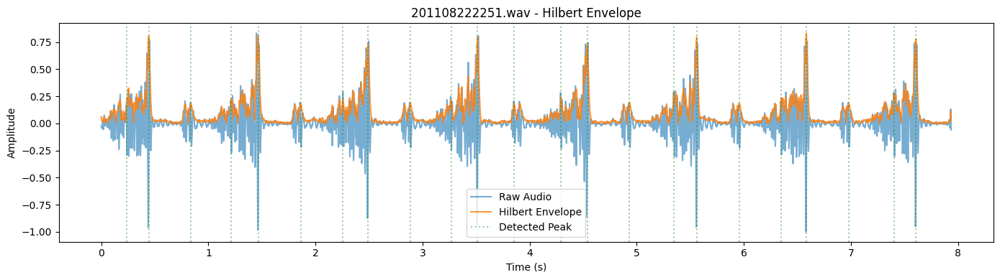

201108222251.wav - First 10 peak times (s): [0.239 0.443 0.837 1.213 1.466 1.862 2.256 2.49  2.885 3.267]


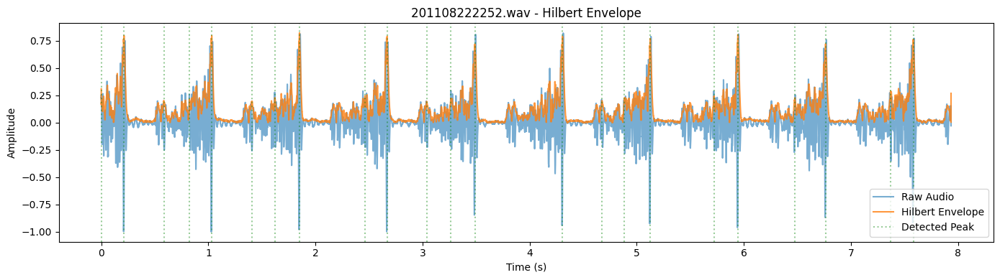

201108222252.wav - First 10 peak times (s): [0.    0.213 0.584 0.823 1.032 1.408 1.622 1.851 2.462 2.669]


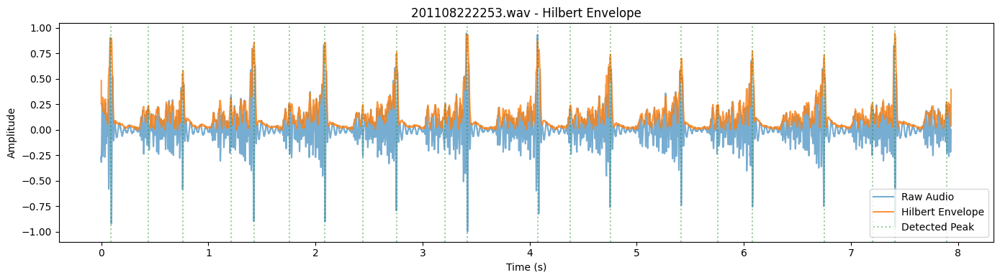

201108222253.wav - First 10 peak times (s): [0.092 0.441 0.763 1.211 1.428 1.755 2.088 2.443 2.759 3.211]


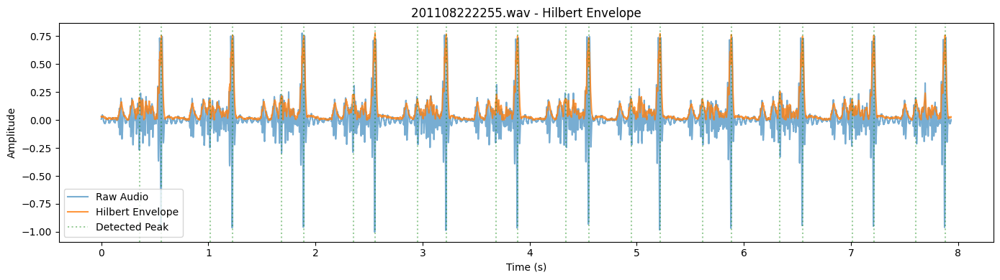

201108222255.wav - First 10 peak times (s): [0.355 0.561 1.014 1.226 1.684 1.891 2.353 2.557 2.952 3.222]


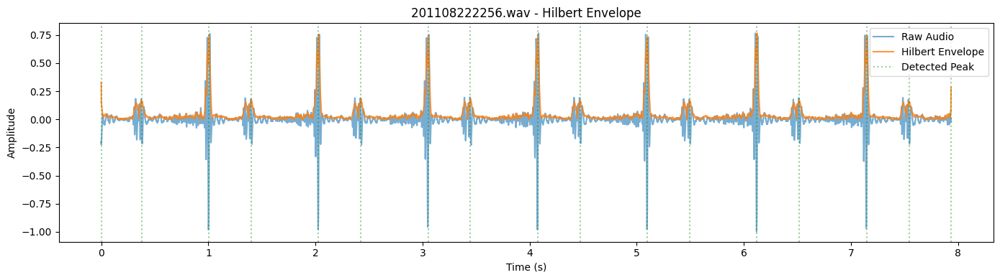

201108222256.wav - First 10 peak times (s): [0.    0.377 1.005 1.401 2.029 2.424 3.053 3.448 4.076 4.471]


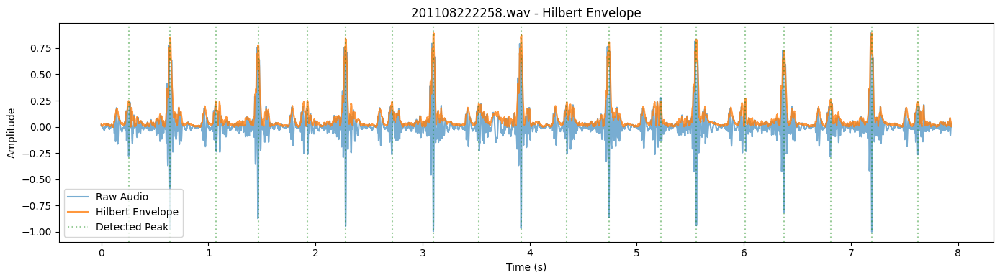

201108222258.wav - First 10 peak times (s): [0.255 0.644 1.069 1.468 1.925 2.281 2.715 3.105 3.525 3.924]

 Artifact files:


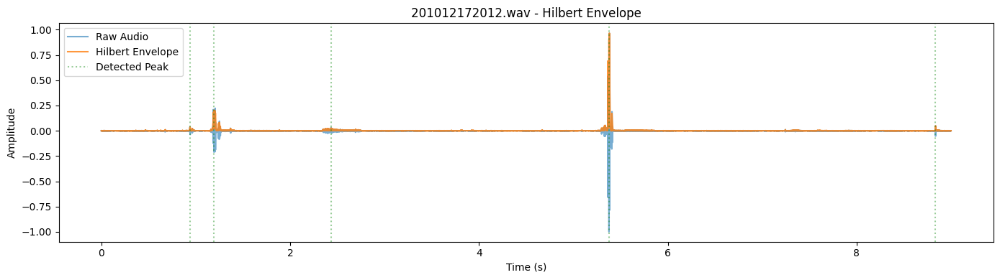

201012172012.wav - First 10 peak times (s): [0.94  1.194 2.433 5.381 8.836]


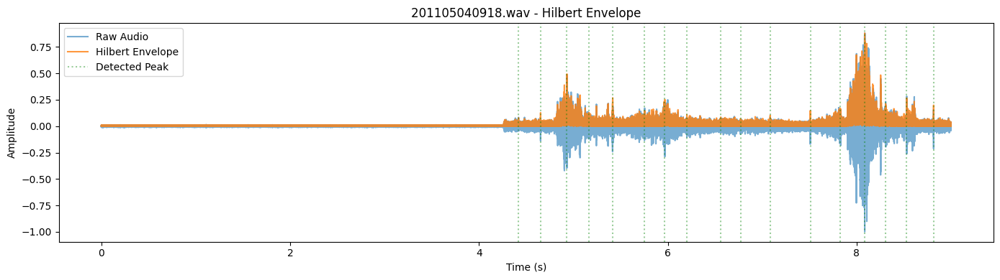

201105040918.wav - First 10 peak times (s): [4.419 4.653 4.932 5.166 5.417 5.755 5.969 6.202 6.561 6.77 ]


<ipython-input-50-2865518297>:28: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sr, y = wavfile.read(file_path)


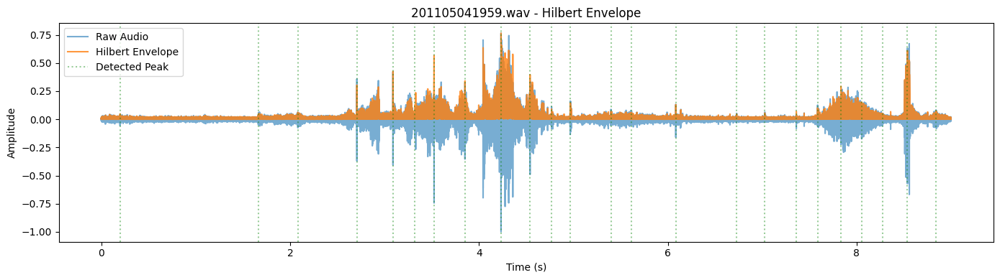

201105041959.wav - First 10 peak times (s): [0.199 1.667 2.082 2.707 3.09  3.322 3.525 3.852 4.234 4.541]


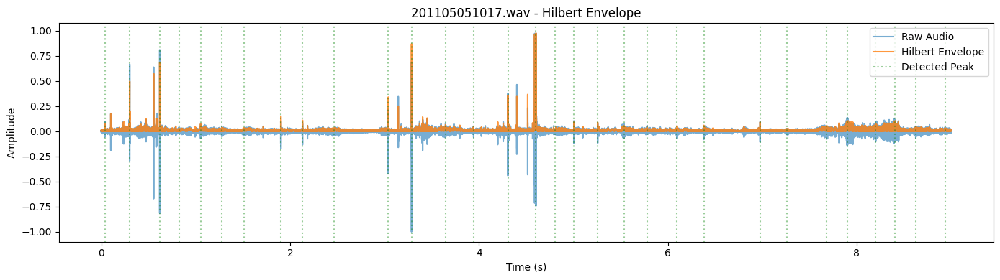

201105051017.wav - First 10 peak times (s): [0.038 0.301 0.619 0.829 1.052 1.279 1.511 1.902 2.132 2.469]


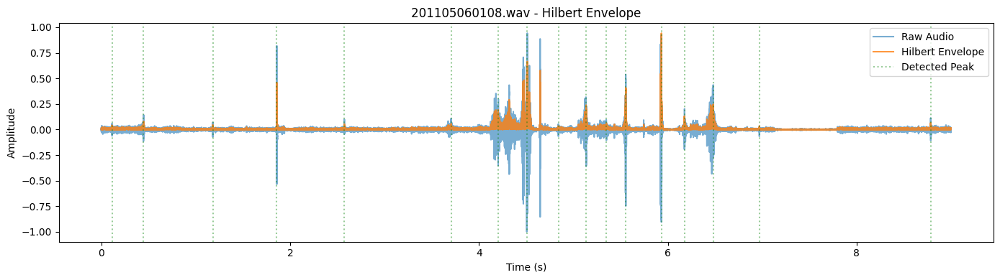

201105060108.wav - First 10 peak times (s): [0.114 0.448 1.181 1.859 2.575 3.705 4.204 4.512 4.841 5.135]


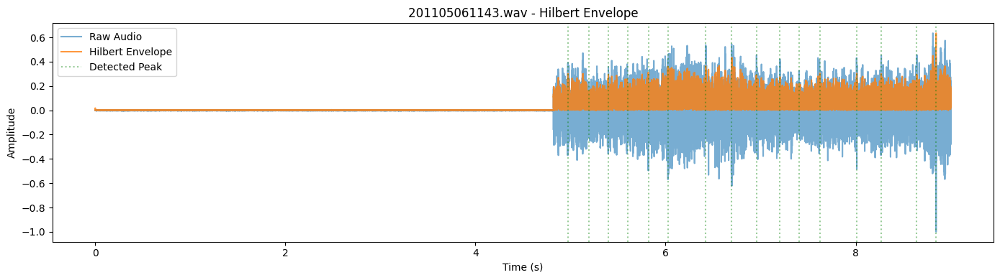

201105061143.wav - First 10 peak times (s): [4.974 5.196 5.398 5.602 5.818 6.025 6.422 6.697 6.956 7.203]


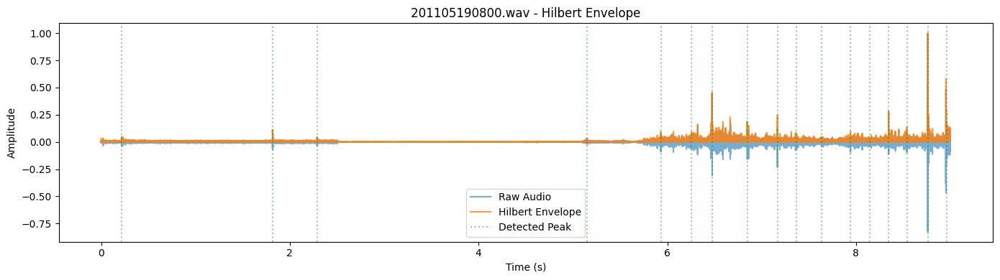

201105190800.wav - First 10 peak times (s): [0.217 1.817 2.289 5.148 5.932 6.258 6.475 6.848 7.167 7.371]


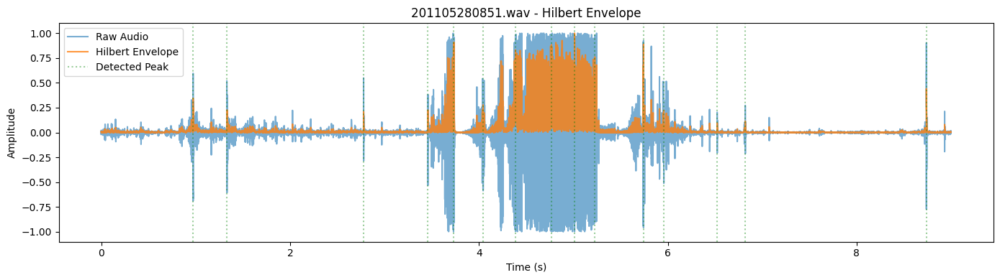

201105280851.wav - First 10 peak times (s): [0.973 1.332 2.778 3.46  3.735 4.044 4.387 4.768 5.013 5.227]


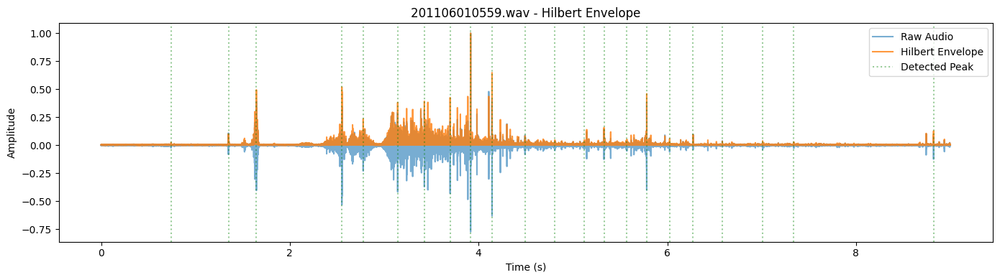

201106010559.wav - First 10 peak times (s): [0.741 1.35  1.645 2.551 2.777 3.143 3.426 3.699 3.916 4.143]


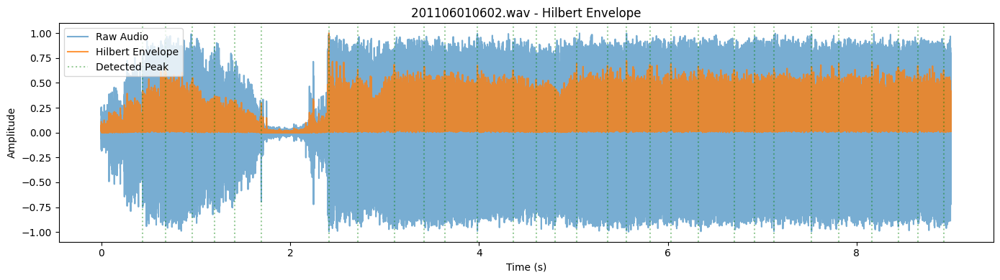

201106010602.wav - First 10 peak times (s): [0.439 0.682 0.967 1.199 1.415 1.695 2.412 2.717 3.102 3.422]


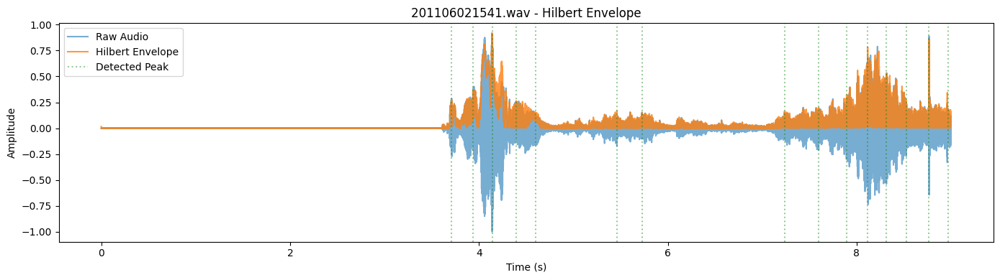

201106021541.wav - First 10 peak times (s): [3.711 3.937 4.139 4.394 4.599 5.461 5.727 7.236 7.598 7.894]


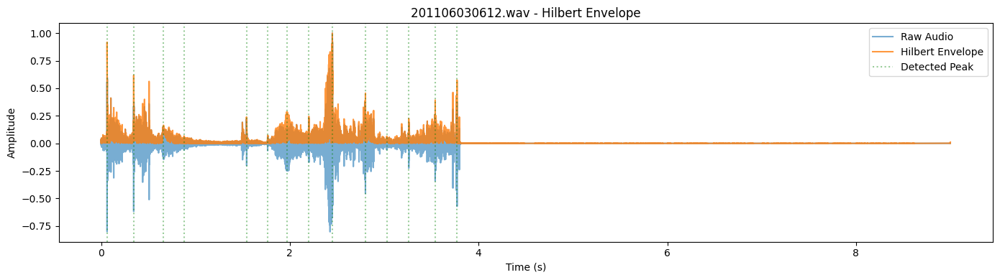

201106030612.wav - First 10 peak times (s): [0.063 0.345 0.661 0.879 1.541 1.766 1.971 2.201 2.451 2.801]


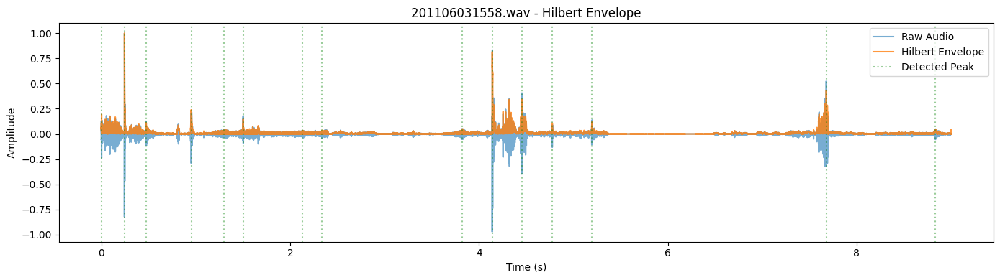

201106031558.wav - First 10 peak times (s): [3.000e-03 2.460e-01 4.740e-01 9.540e-01 1.298e+00 1.502e+00 2.133e+00
 2.338e+00 3.821e+00 4.141e+00]


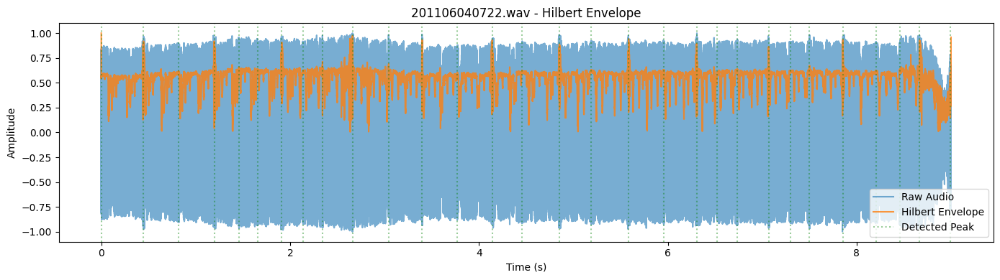

201106040722.wav - First 10 peak times (s): [0.    0.447 0.819 1.196 1.458 1.659 1.912 2.137 2.343 2.66 ]


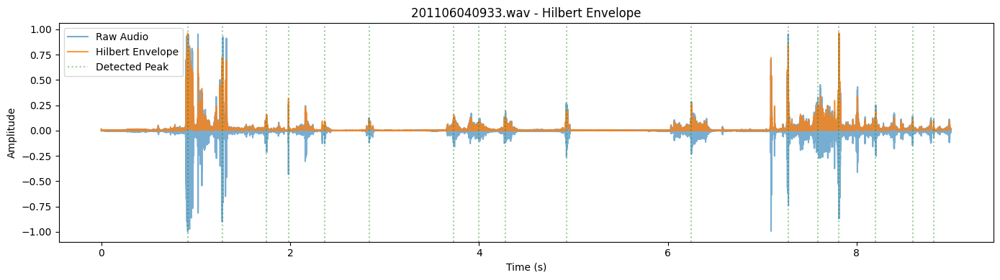

201106040933.wav - First 10 peak times (s): [0.916 1.28  1.752 1.983 2.367 2.836 3.732 4.002 4.282 4.925]


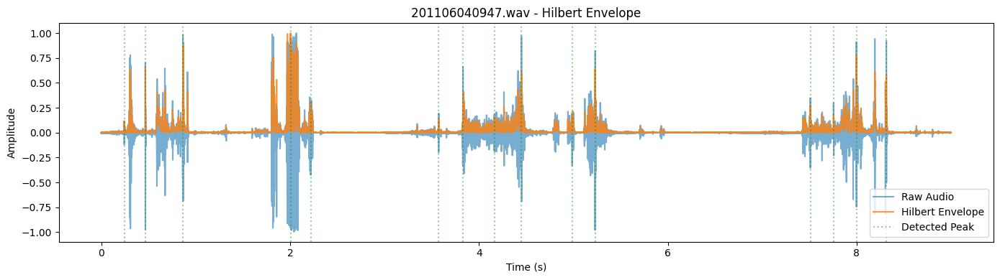

201106040947.wav - First 10 peak times (s): [0.243 0.467 0.868 2.004 2.218 3.574 3.831 4.166 4.451 4.987]


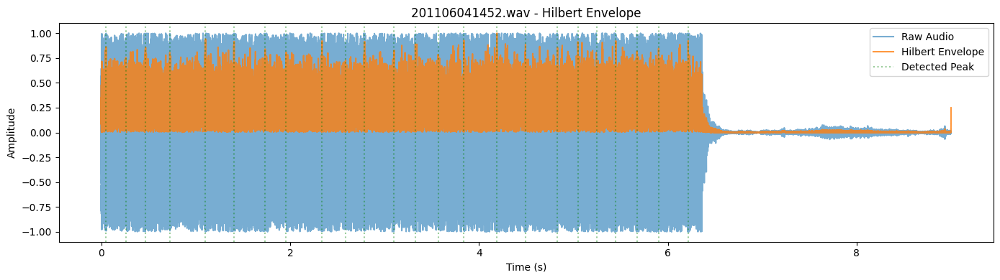

201106041452.wav - First 10 peak times (s): [0.051 0.26  0.47  0.725 1.104 1.407 1.736 1.958 2.338 2.588]


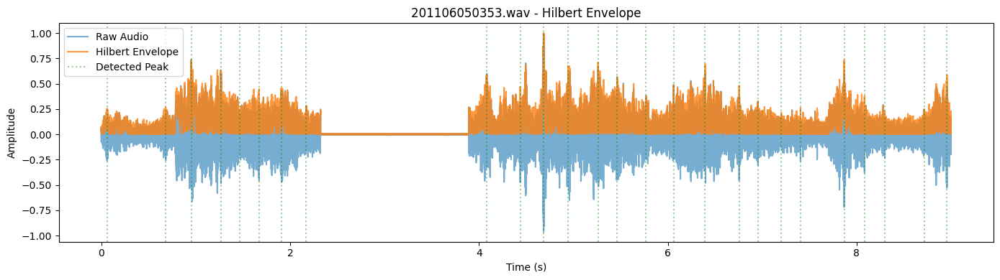

201106050353.wav - First 10 peak times (s): [0.062 0.683 0.953 1.265 1.466 1.671 1.91  2.172 4.084 4.437]


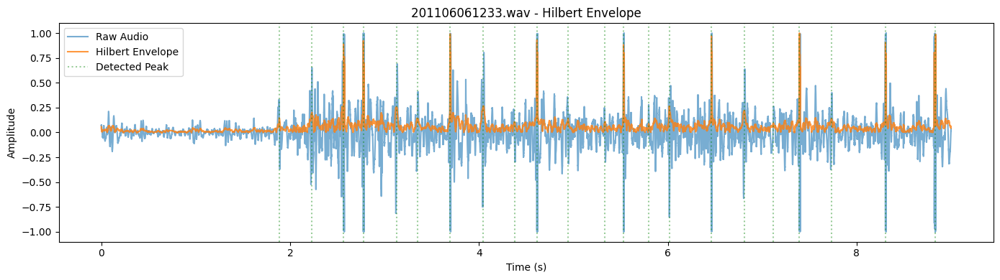

201106061233.wav - First 10 peak times (s): [1.886 2.231 2.566 2.776 3.127 3.347 3.695 4.046 4.379 4.614]


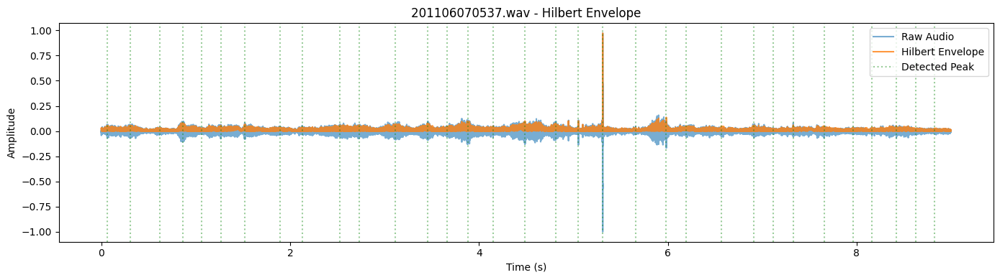

201106070537.wav - First 10 peak times (s): [0.064 0.308 0.62  0.862 1.063 1.266 1.519 1.894 2.127 2.529]


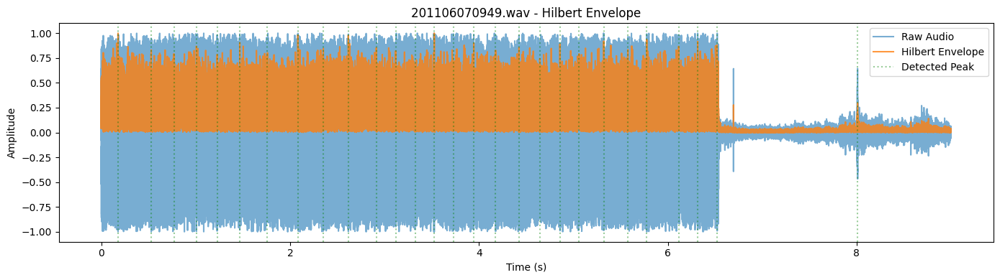

201106070949.wav - First 10 peak times (s): [0.178 0.529 0.769 1.008 1.227 1.467 1.76  2.083 2.351 2.617]


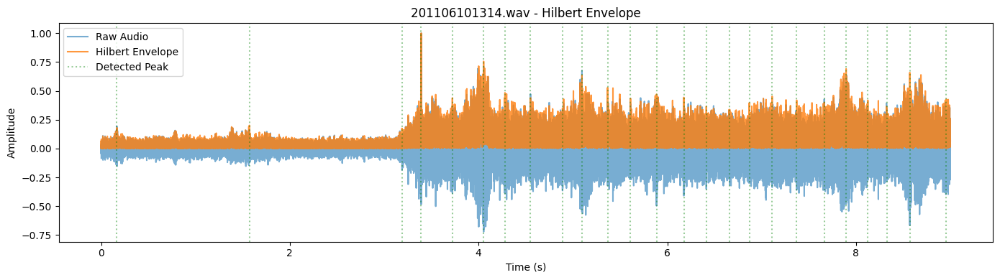

201106101314.wav - First 10 peak times (s): [0.167 1.572 3.189 3.392 3.723 4.054 4.28  4.55  4.89  5.096]


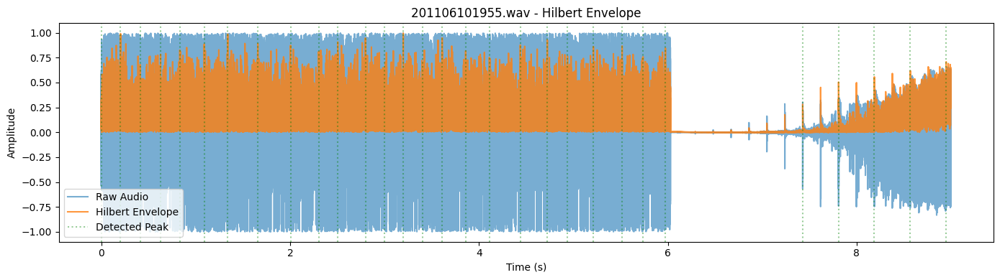

201106101955.wav - First 10 peak times (s): [0.004 0.204 0.411 0.628 0.832 1.09  1.34  1.659 2.005 2.302]


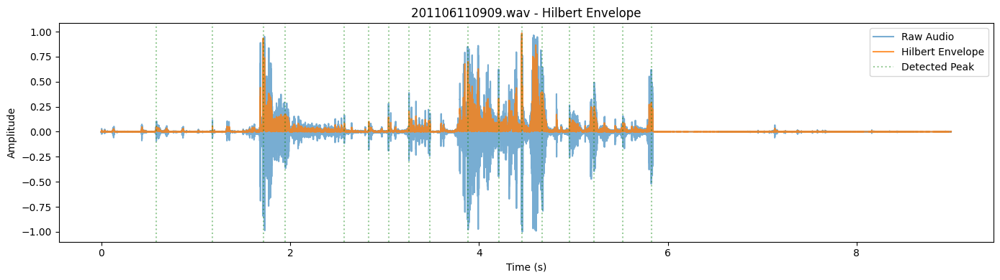

201106110909.wav - First 10 peak times (s): [0.584 1.177 1.715 1.947 2.574 2.834 3.042 3.259 3.478 3.885]


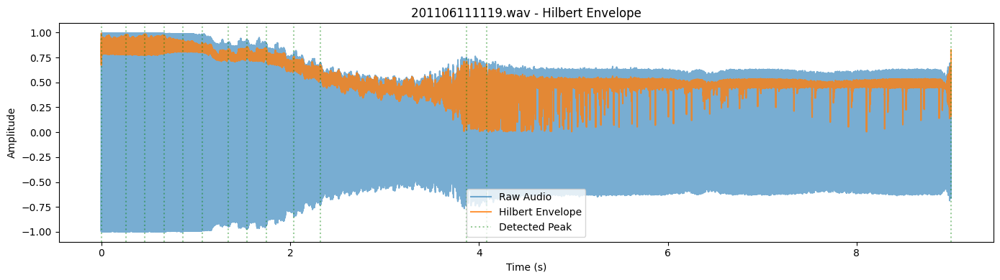

201106111119.wav - First 10 peak times (s): [1.000e-03 2.620e-01 4.630e-01 6.640e-01 8.670e-01 1.068e+00 1.346e+00
 1.546e+00 1.749e+00 2.040e+00]


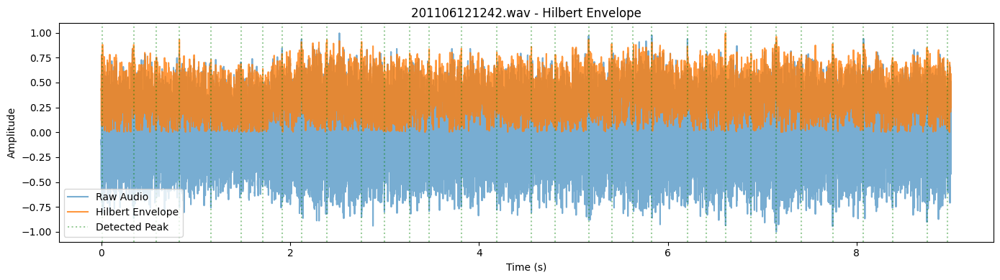

201106121242.wav - First 10 peak times (s): [0.013 0.344 0.584 0.827 1.162 1.48  1.711 1.915 2.12  2.39 ]


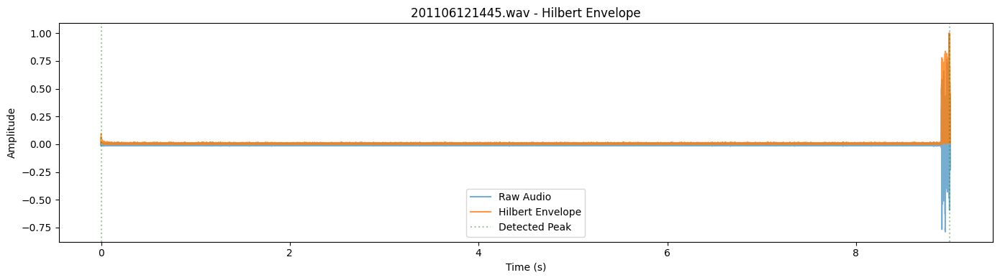

201106121445.wav - First 10 peak times (s): [0.    8.989]


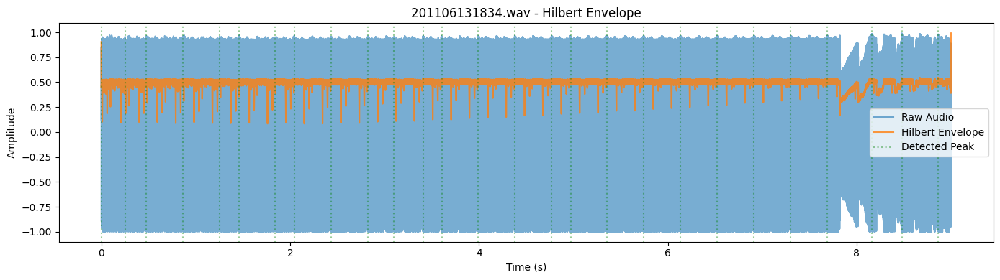

201106131834.wav - First 10 peak times (s): [0.    0.251 0.478 0.867 1.254 1.461 1.839 2.044 2.433 2.823]


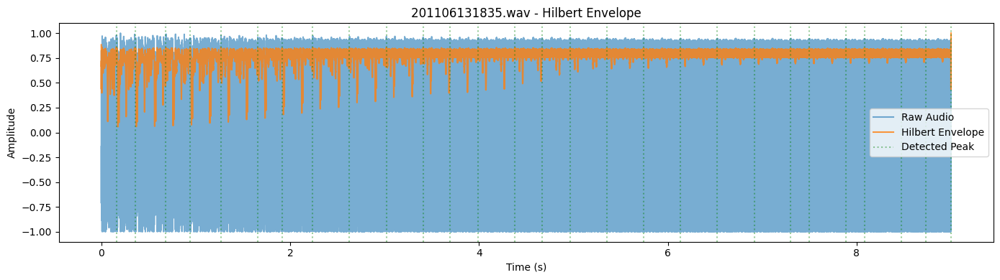

201106131835.wav - First 10 peak times (s): [0.159 0.363 0.685 0.94  1.268 1.657 1.918 2.24  2.629 3.019]


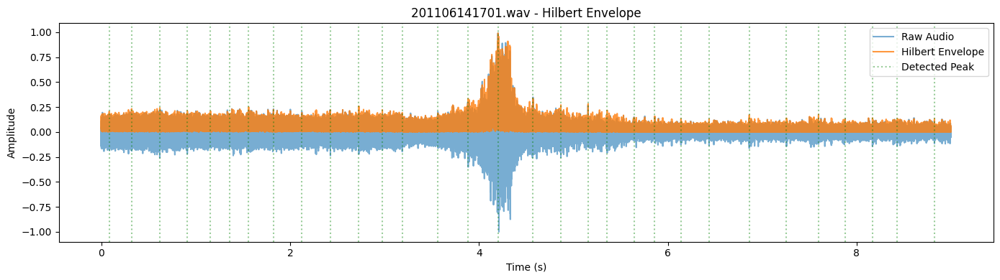

201106141701.wav - First 10 peak times (s): [0.084 0.322 0.62  0.911 1.157 1.357 1.561 1.824 2.124 2.427]


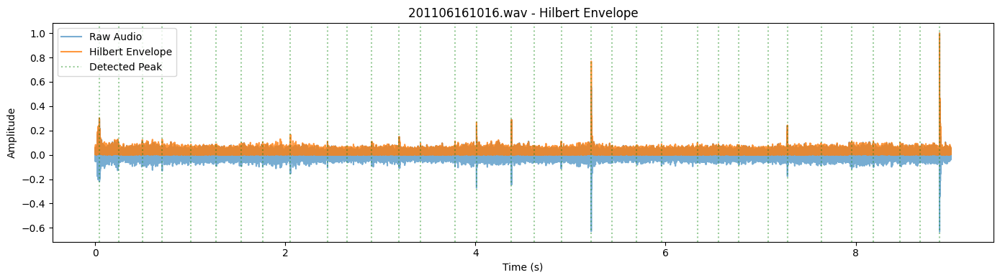

201106161016.wav - First 10 peak times (s): [0.043 0.244 0.495 0.704 1.007 1.268 1.538 1.762 2.054 2.444]


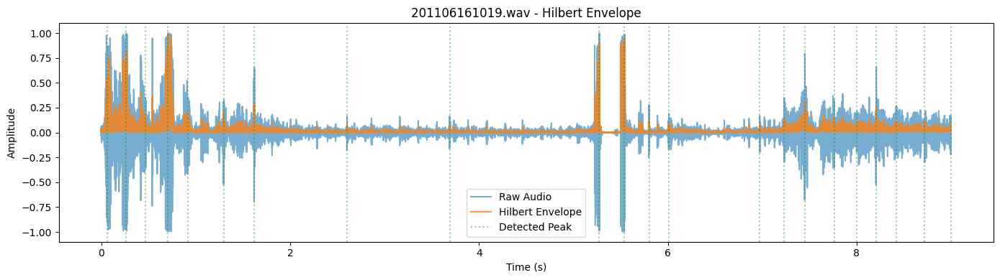

201106161019.wav - First 10 peak times (s): [0.064 0.265 0.465 0.705 0.916 1.296 1.62  2.603 3.69  5.274]


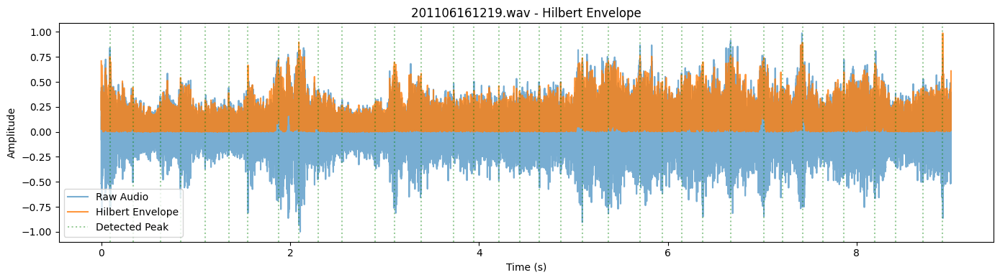

201106161219.wav - First 10 peak times (s): [0.092 0.335 0.624 0.84  1.1   1.349 1.554 1.877 2.092 2.294]


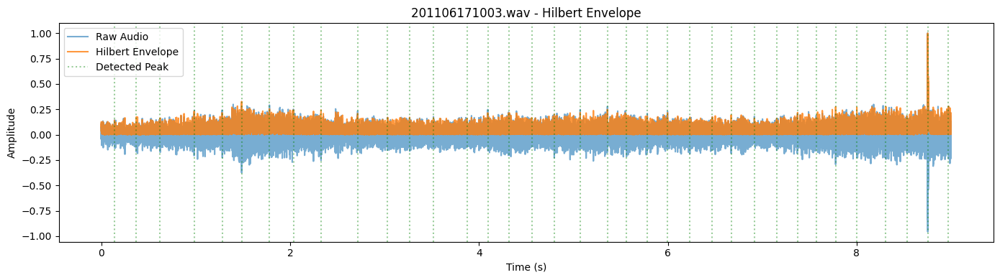

201106171003.wav - First 10 peak times (s): [0.14  0.372 0.624 0.984 1.28  1.486 1.781 2.035 2.328 2.715]


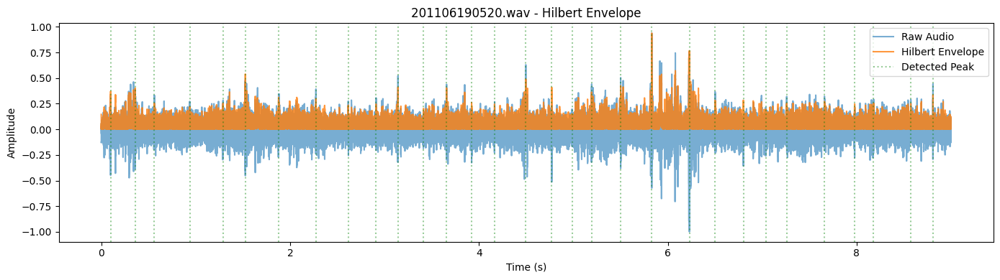

201106190520.wav - First 10 peak times (s): [0.099 0.359 0.562 0.937 1.289 1.525 1.878 2.273 2.616 2.91 ]


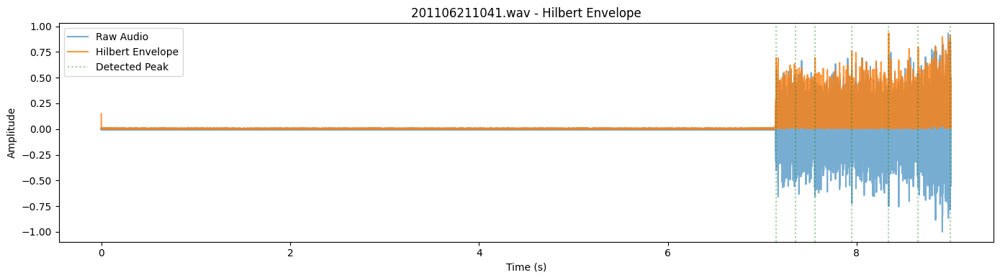

201106211041.wav - First 10 peak times (s): [7.147 7.351 7.559 7.95  8.34  8.652 8.99 ]


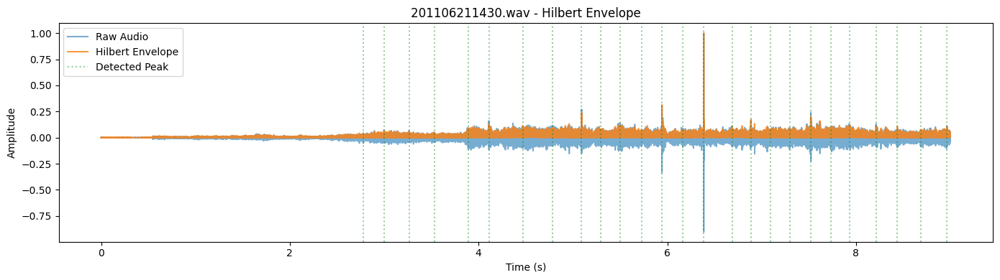

201106211430.wav - First 10 peak times (s): [2.778 2.998 3.264 3.534 3.89  4.11  4.468 4.783 5.092 5.295]


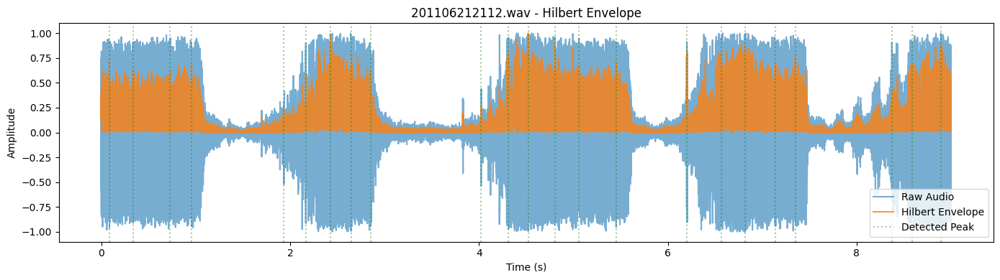

201106212112.wav - First 10 peak times (s): [0.086 0.338 0.728 0.956 1.935 2.166 2.427 2.65  2.851 4.024]


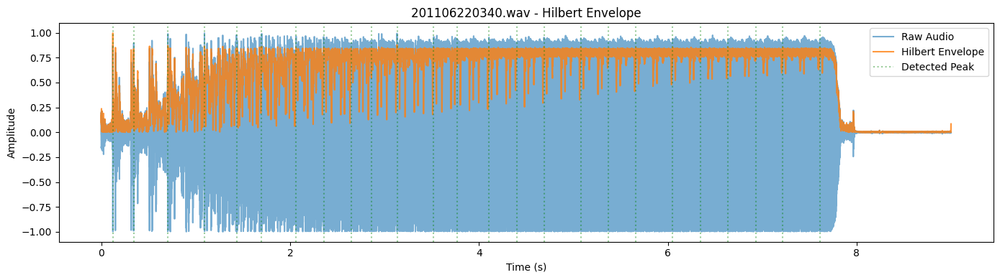

201106220340.wav - First 10 peak times (s): [0.123 0.343 0.705 1.092 1.435 1.699 2.062 2.356 2.646 2.866]


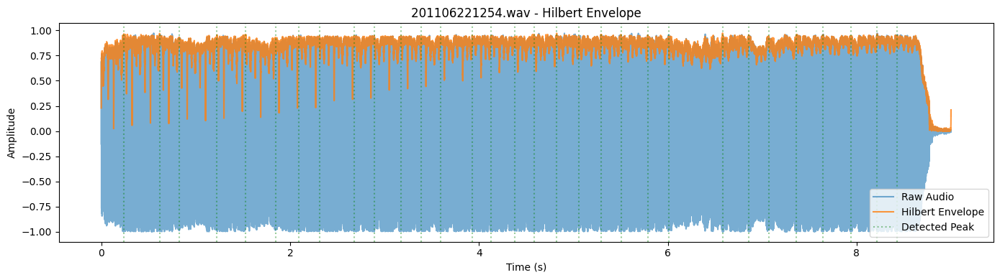

201106221254.wav - First 10 peak times (s): [0.239 0.618 0.825 1.226 1.525 1.845 2.094 2.31  2.676 2.891]


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import hilbert, find_peaks
from scipy.io import wavfile

# Paths
murmur_folder = '/content/drive/MyDrive/Neurosonic/Data/murmur'
artifact_folder = '/content/drive/MyDrive/Neurosonic/Data/artifact'

# Peak detection
def detect_peaks_from_audio(y, sr):
    if y.ndim > 1:
        y = y[:, 0]  # Use first channel if stereo
    y = y.astype(np.float32)
    y = y - np.mean(y)
    y = y / np.max(np.abs(y))
    analytic = hilbert(y)
    envelope = np.abs(analytic)
    envelope = envelope / np.max(envelope)
    min_distance = int(0.20 * sr)
    threshold = np.mean(envelope) + 0.6 * np.std(envelope)
    peaks, _ = find_peaks(envelope, distance=min_distance, height=threshold)
    return peaks / sr, envelope, y

# Plotting function
def plot_audio_with_peaks(file_path):
    sr, y = wavfile.read(file_path)
    peak_times, envelope, y_norm = detect_peaks_from_audio(y, sr)
    time_axis = np.arange(len(y_norm)) / sr

    plt.figure(figsize=(14, 4))
    plt.plot(time_axis, y_norm, label='Raw Audio', alpha=0.6)
    plt.plot(time_axis, envelope * np.max(y_norm), label='Hilbert Envelope', alpha=0.8)
    for t in peak_times:
        plt.axvline(t, color='green', linestyle=':', alpha=0.4,
                    label='Detected Peak' if 'Detected Peak' not in plt.gca().get_legend_handles_labels()[1] else "")
    plt.title(f'{os.path.basename(file_path)} - Hilbert Envelope')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.tight_layout()
    plt.show()
    return peak_times

# Process all murmur files
print(" Murmur files:")
for filename in sorted(os.listdir(murmur_folder)):
    if filename.endswith('.wav'):
        filepath = os.path.join(murmur_folder, filename)
        peaks = plot_audio_with_peaks(filepath)
        print(f"{filename} - First 10 peak times (s):", np.round(peaks[:10], 3))

# Process all artifact files
print("\n Artifact files:")
for filename in sorted(os.listdir(artifact_folder)):
    if filename.endswith('.wav'):
        filepath = os.path.join(artifact_folder, filename)
        peaks = plot_audio_with_peaks(filepath)
        print(f"{filename} - First 10 peak times (s):", np.round(peaks[:10], 3))


# Objective 2:

# Feature Engineering: analyzing which features are different across each class


murmur: 100%|██████████| 35/35 [00:26<00:00,  1.30it/s]


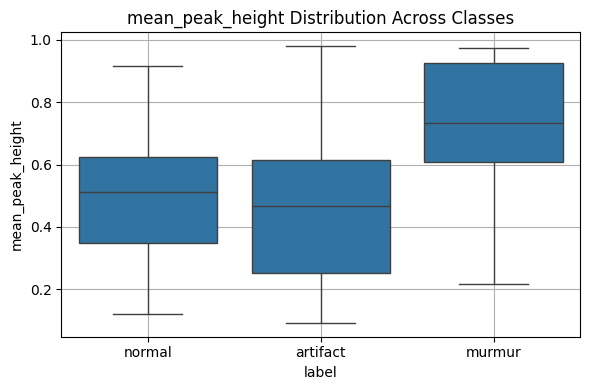

mean_peak_height: p = 0.00000


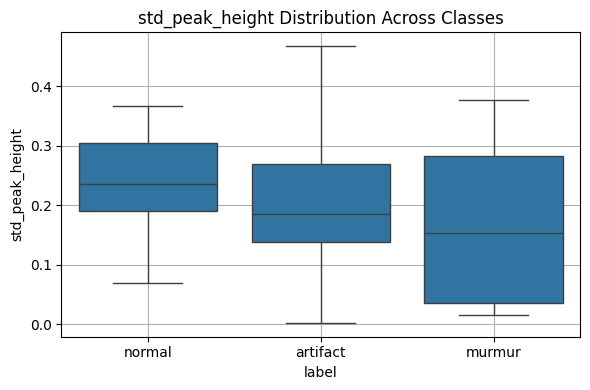

std_peak_height: p = 0.03480


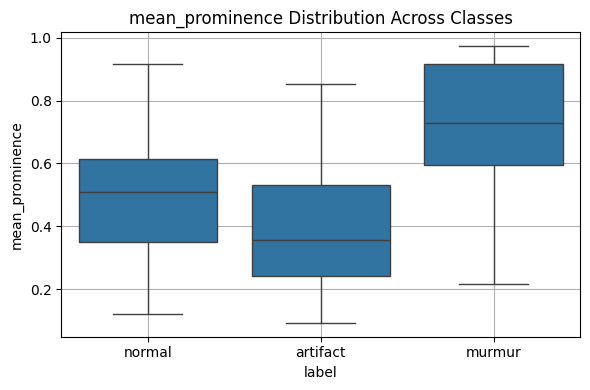

mean_prominence: p = 0.00000


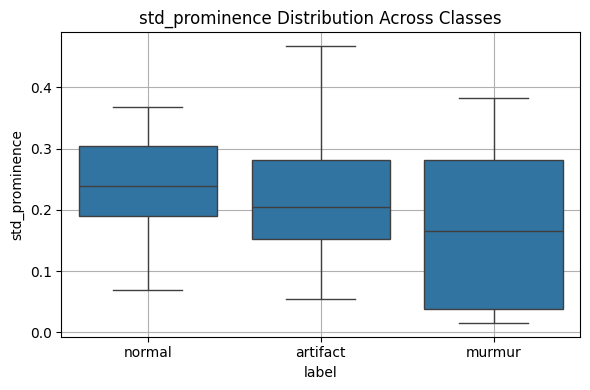

std_prominence: p = 0.05342


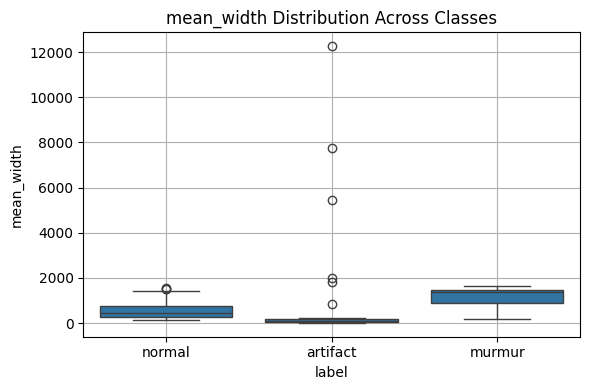

mean_width: p = 0.00000


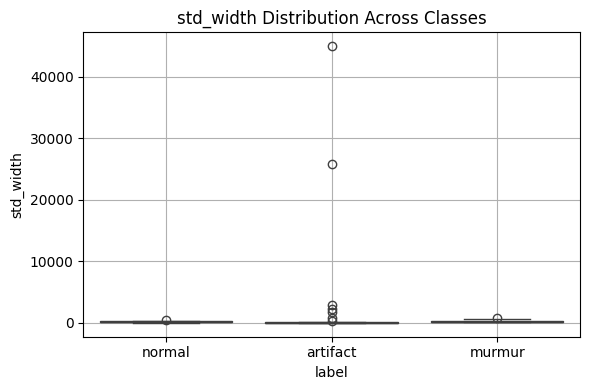

std_width: p = 0.00001


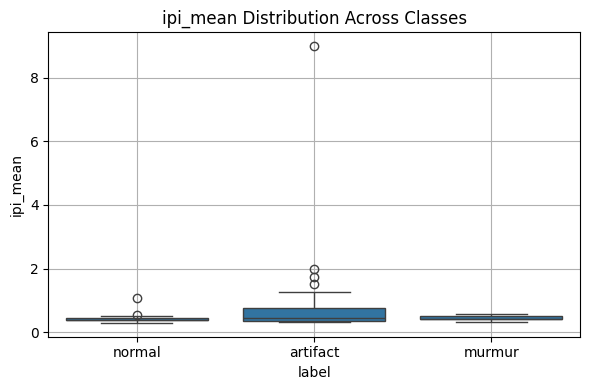

ipi_mean: p = 0.03230


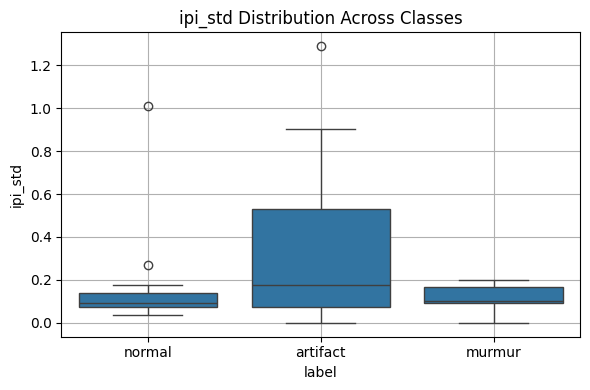

ipi_std: p = 0.02857


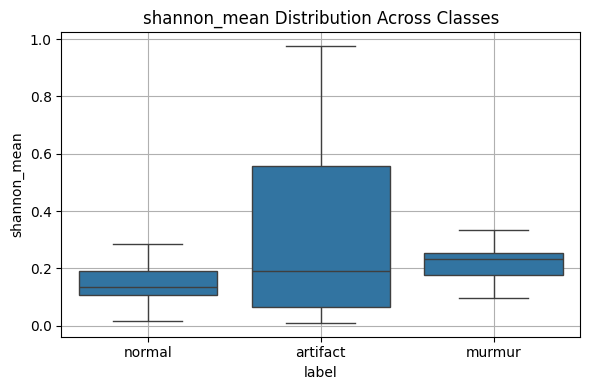

shannon_mean: p = 0.00616


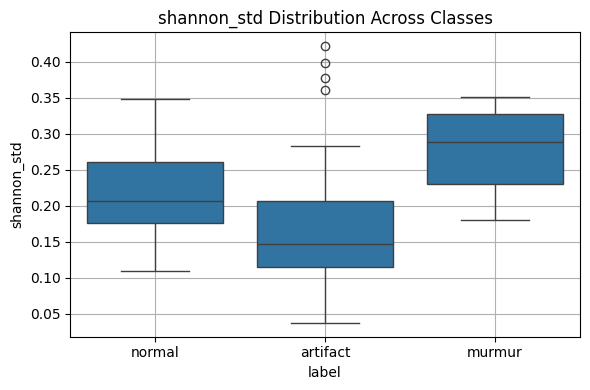

shannon_std: p = 0.00000


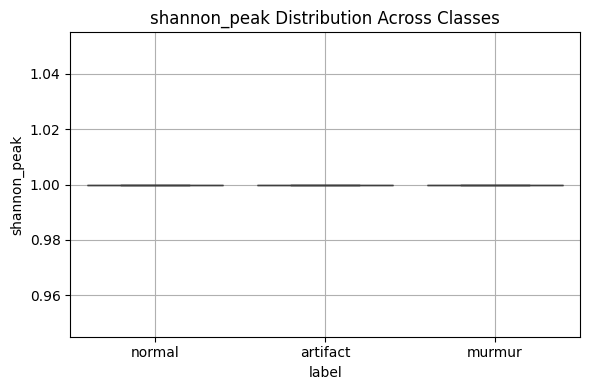

shannon_peak: skipped (All numbers are identical in kruskal)


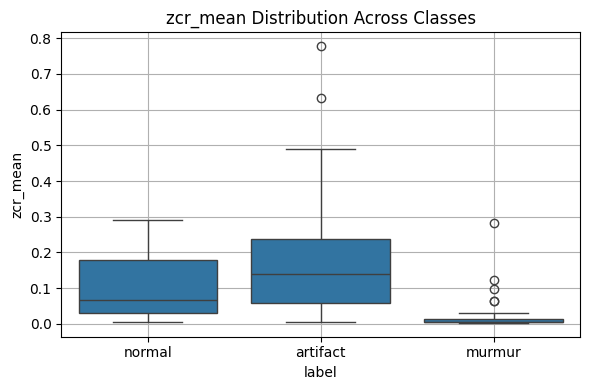

zcr_mean: p = 0.00000


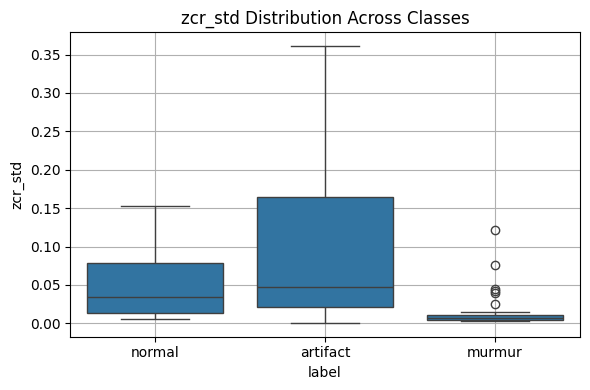

zcr_std: p = 0.00000


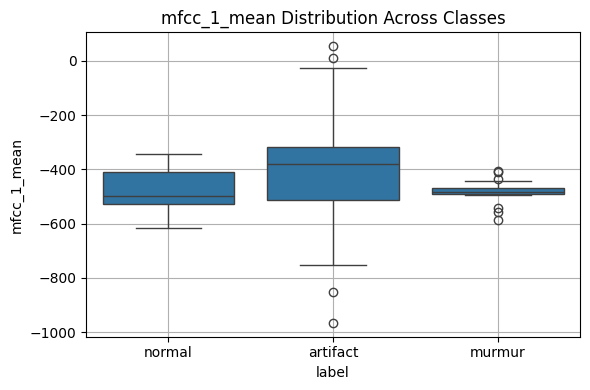

mfcc_1_mean: p = 0.00497


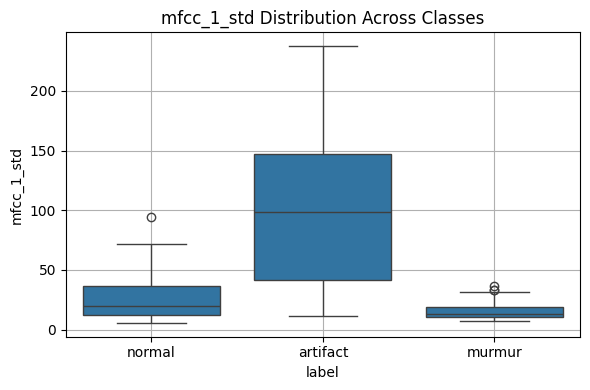

mfcc_1_std: p = 0.00000


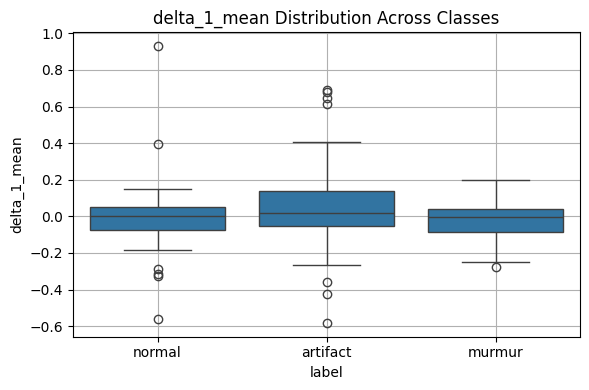

delta_1_mean: p = 0.41650


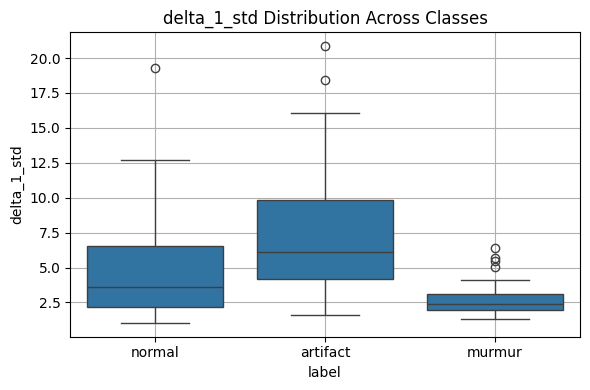

delta_1_std: p = 0.00001


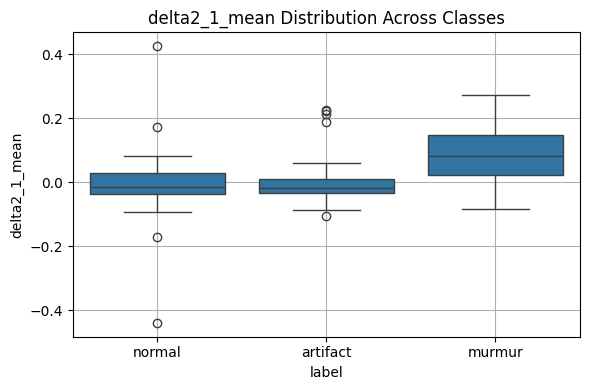

delta2_1_mean: p = 0.00001


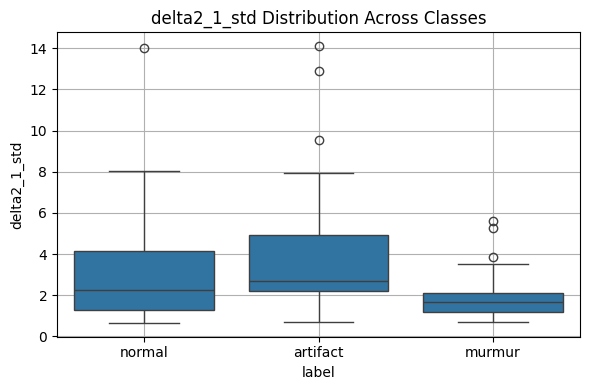

delta2_1_std: p = 0.00083


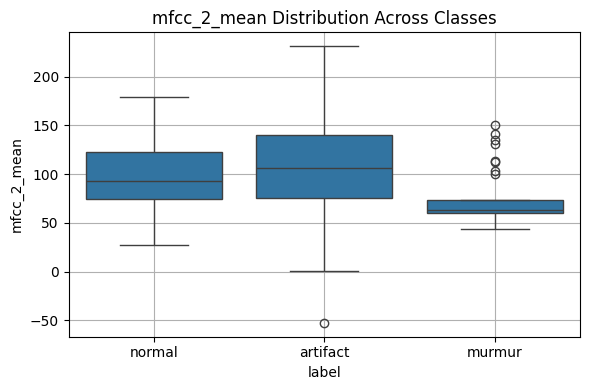

mfcc_2_mean: p = 0.00095


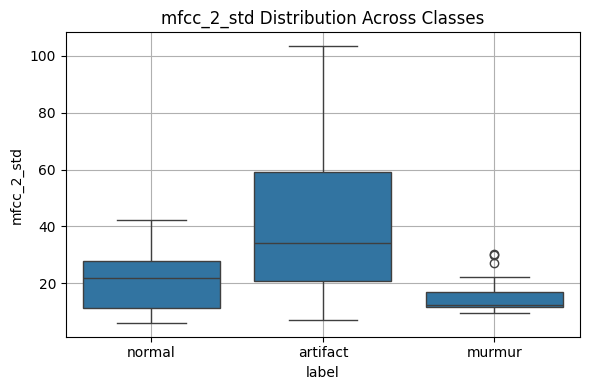

mfcc_2_std: p = 0.00000


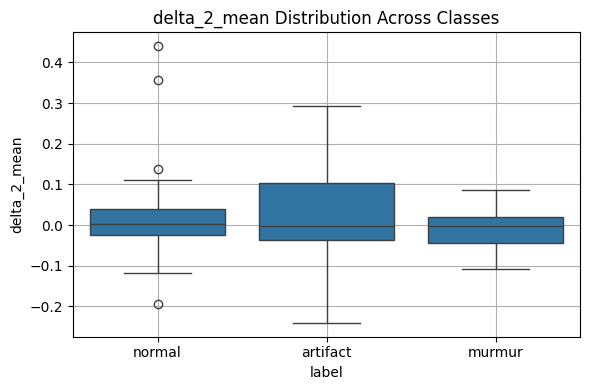

delta_2_mean: p = 0.53157


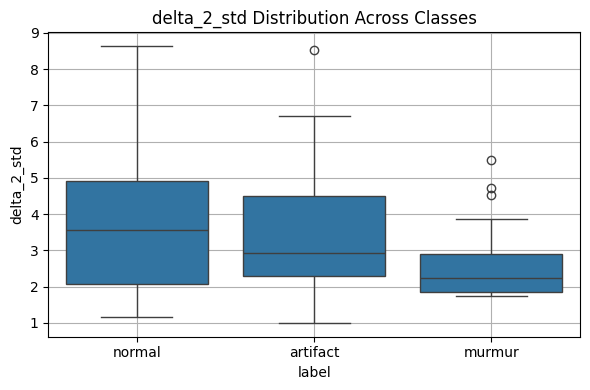

delta_2_std: p = 0.01096


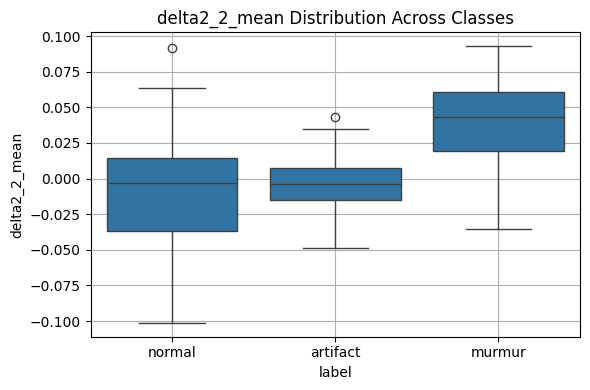

delta2_2_mean: p = 0.00000


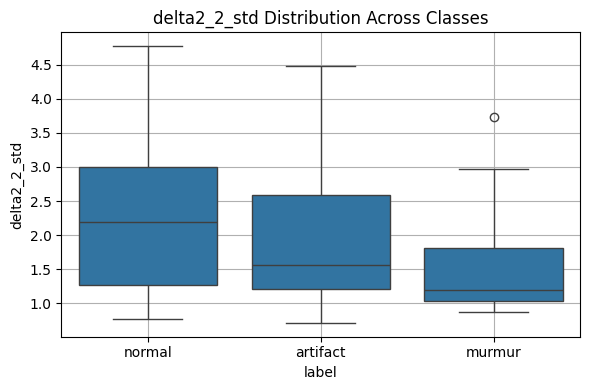

delta2_2_std: p = 0.00849


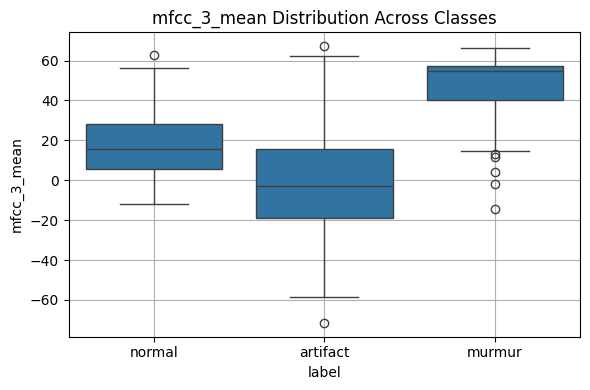

mfcc_3_mean: p = 0.00000


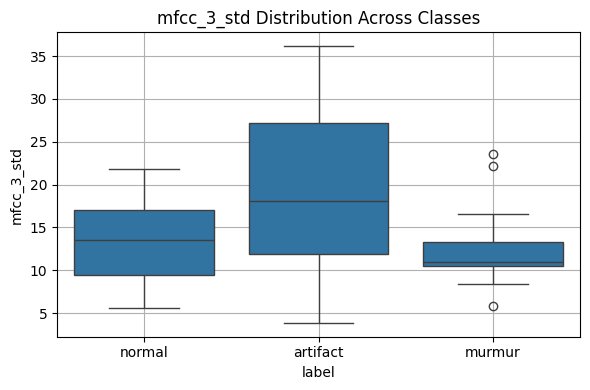

mfcc_3_std: p = 0.00093


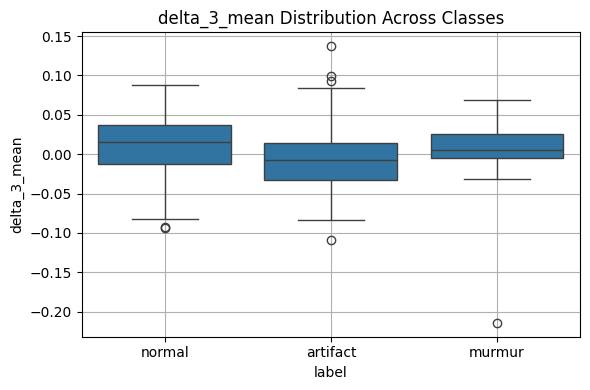

delta_3_mean: p = 0.05560


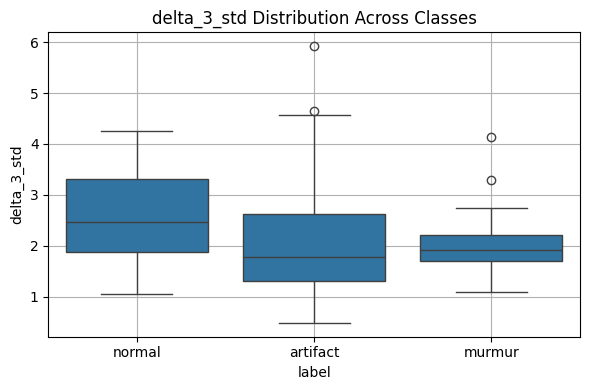

delta_3_std: p = 0.01307


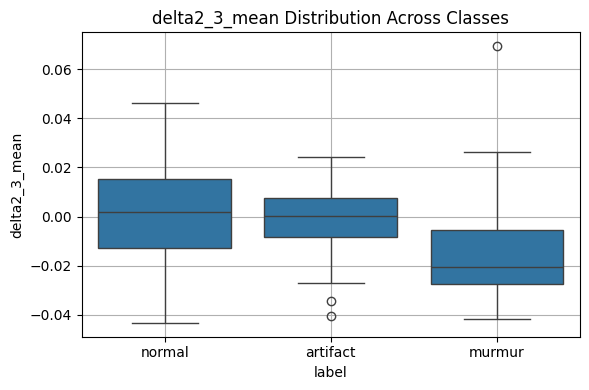

delta2_3_mean: p = 0.00081


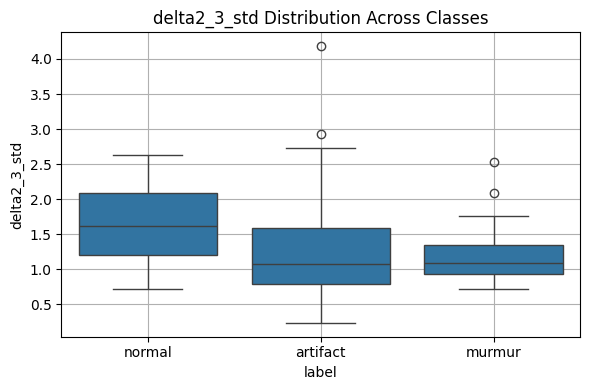

delta2_3_std: p = 0.00435


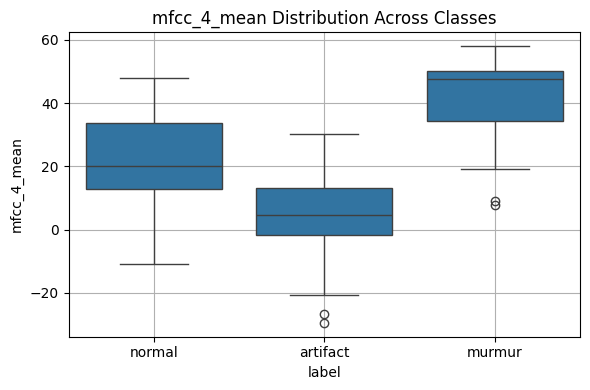

mfcc_4_mean: p = 0.00000


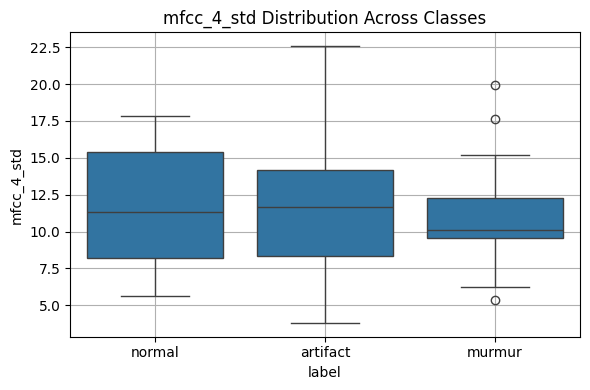

mfcc_4_std: p = 0.71257


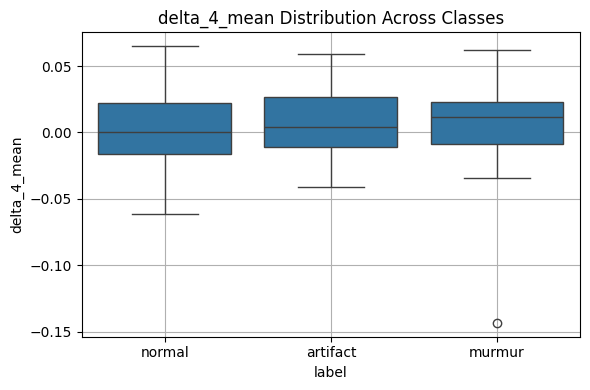

delta_4_mean: p = 0.74809


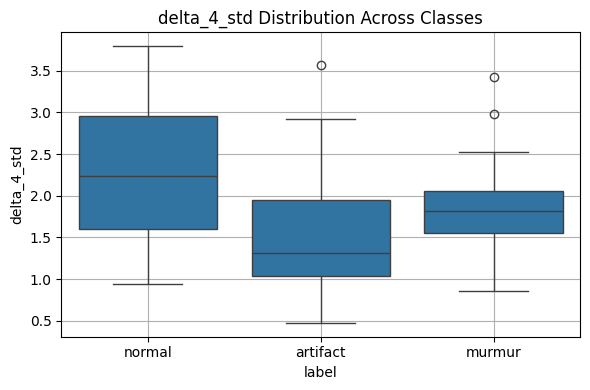

delta_4_std: p = 0.00007


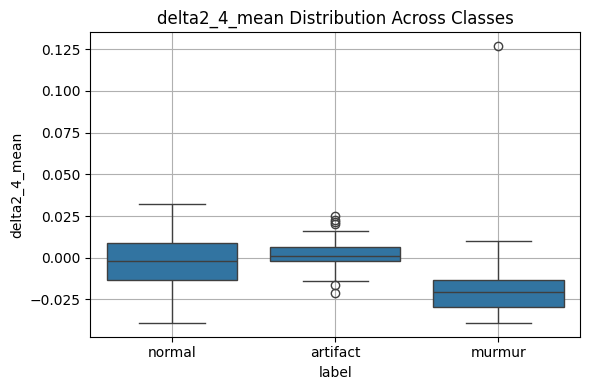

delta2_4_mean: p = 0.00000


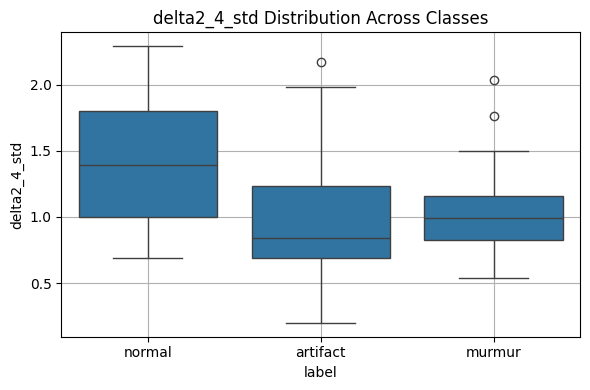

delta2_4_std: p = 0.00020


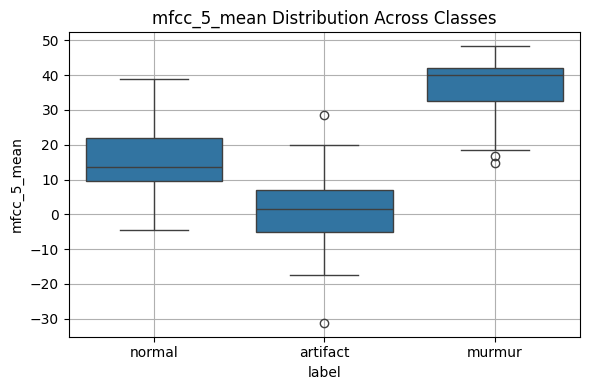

mfcc_5_mean: p = 0.00000


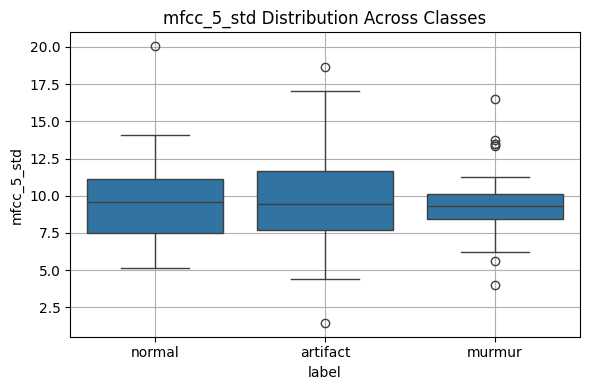

mfcc_5_std: p = 0.96850


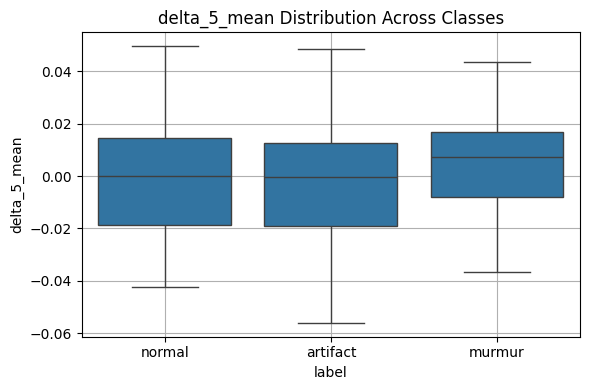

delta_5_mean: p = 0.29445


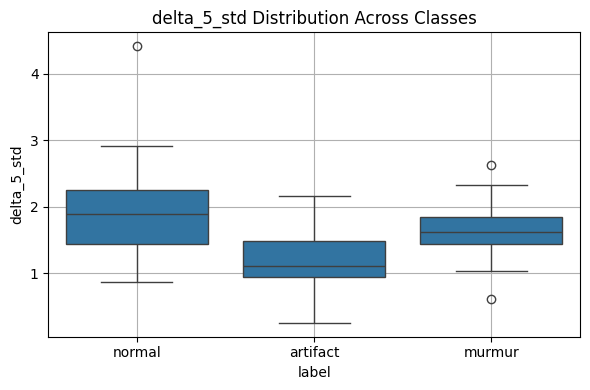

delta_5_std: p = 0.00001


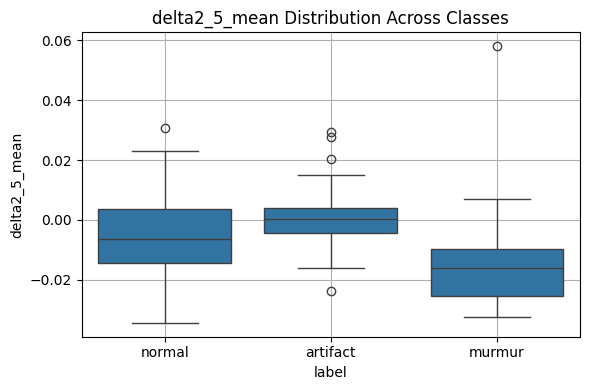

delta2_5_mean: p = 0.00000


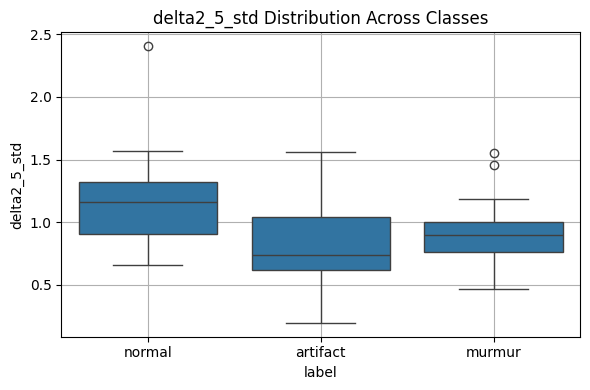

delta2_5_std: p = 0.00005


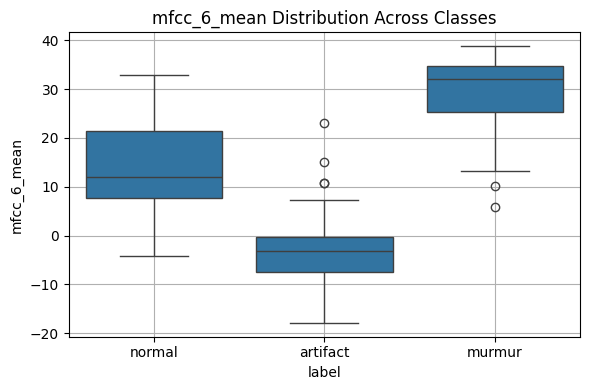

mfcc_6_mean: p = 0.00000


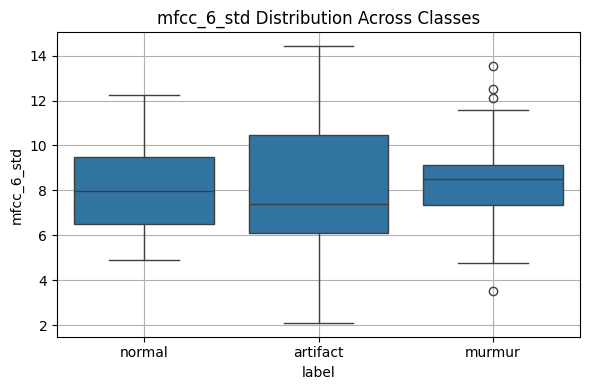

mfcc_6_std: p = 0.42057


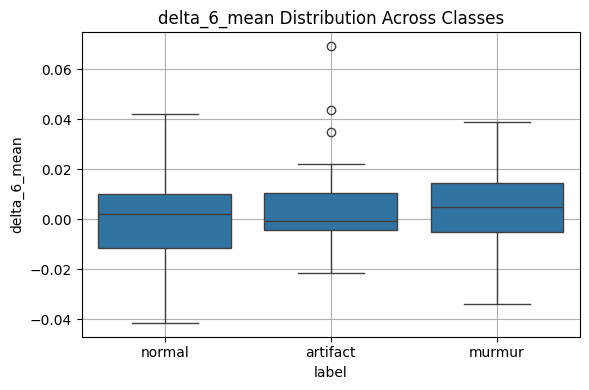

delta_6_mean: p = 0.48771


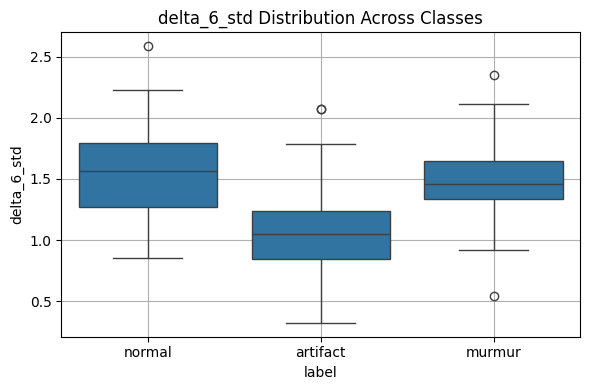

delta_6_std: p = 0.00000


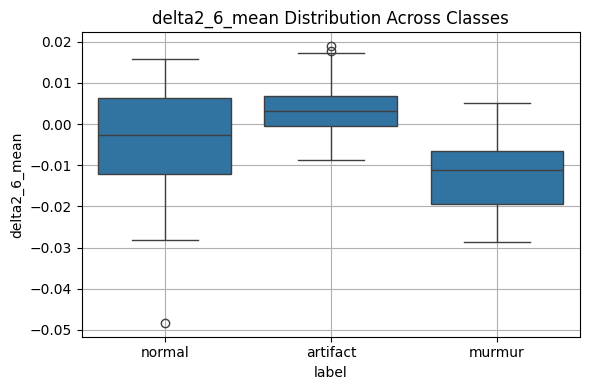

delta2_6_mean: p = 0.00000


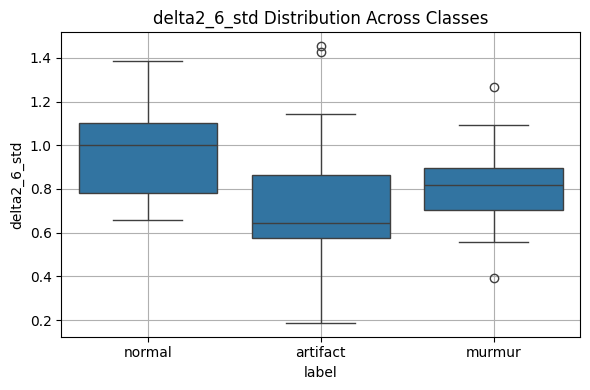

delta2_6_std: p = 0.00000


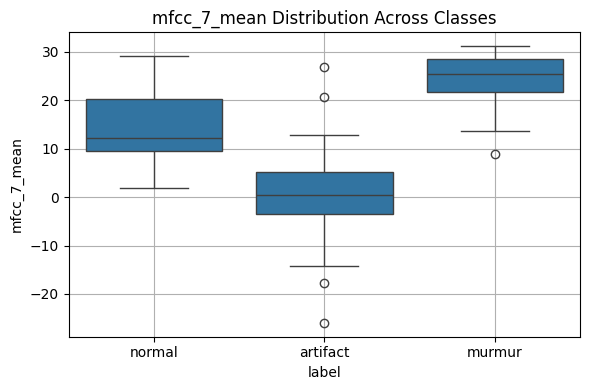

mfcc_7_mean: p = 0.00000


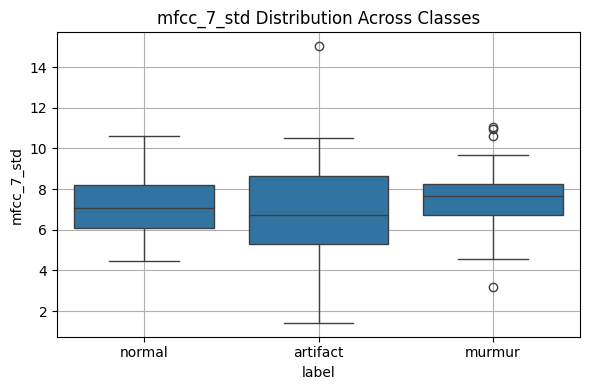

mfcc_7_std: p = 0.31160


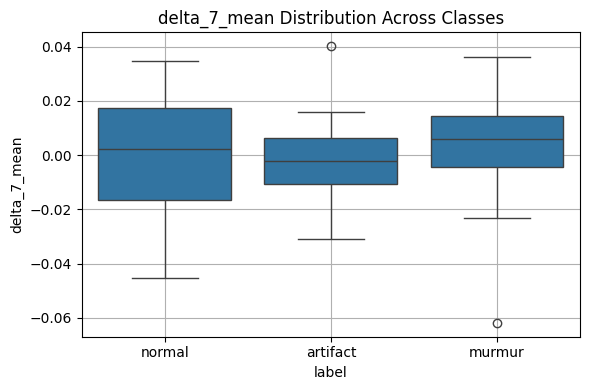

delta_7_mean: p = 0.12577


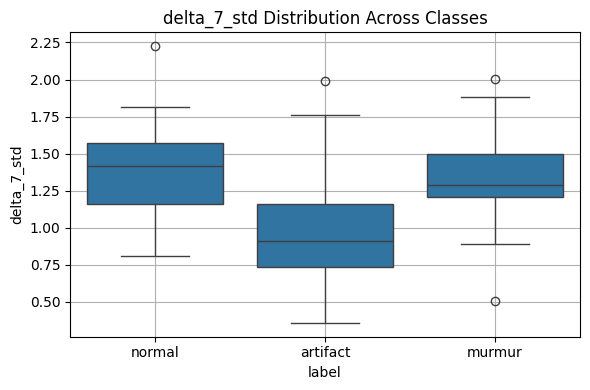

delta_7_std: p = 0.00000


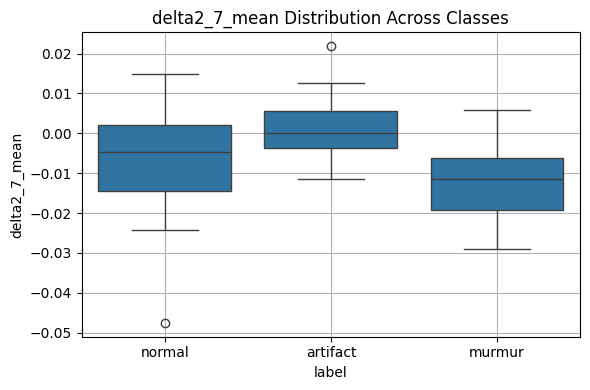

delta2_7_mean: p = 0.00000


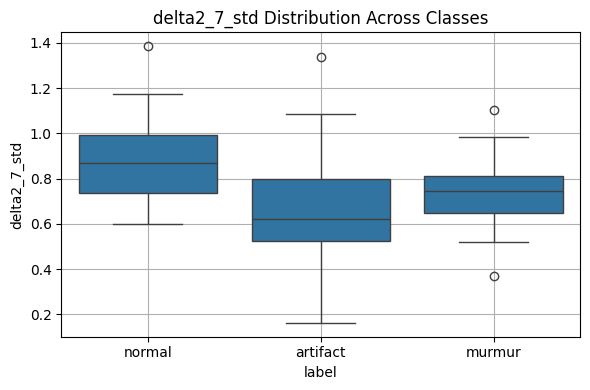

delta2_7_std: p = 0.00001


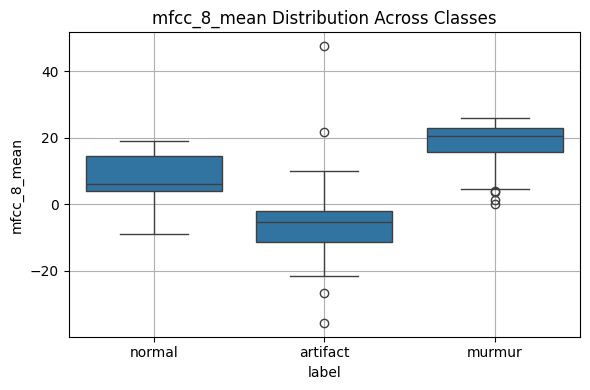

mfcc_8_mean: p = 0.00000


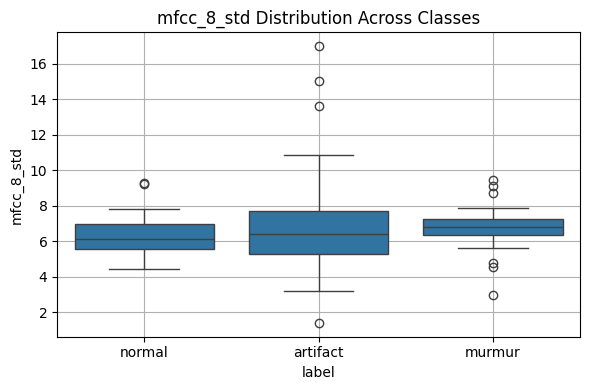

mfcc_8_std: p = 0.16363


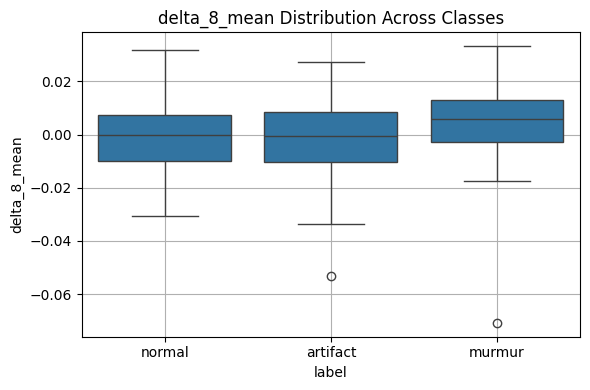

delta_8_mean: p = 0.19031


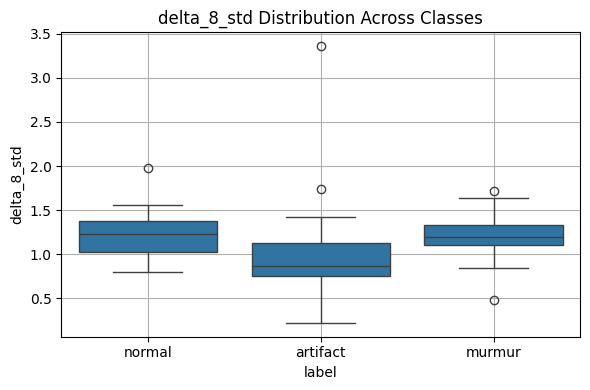

delta_8_std: p = 0.00003


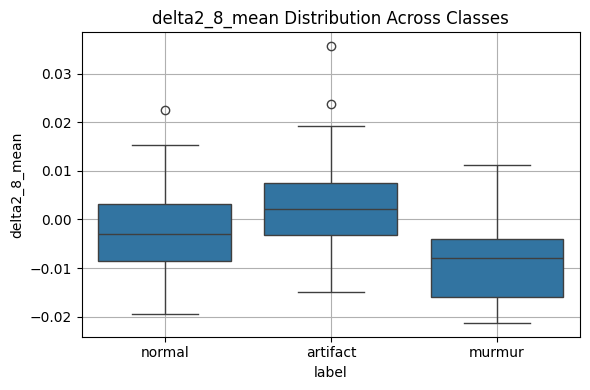

delta2_8_mean: p = 0.00001


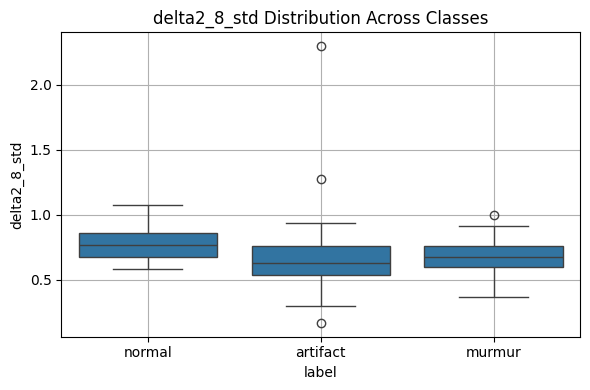

delta2_8_std: p = 0.00091


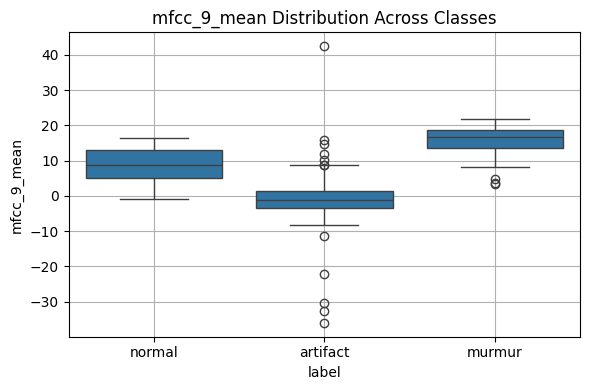

mfcc_9_mean: p = 0.00000


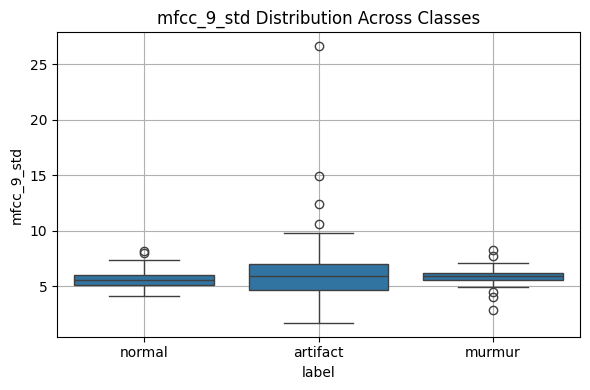

mfcc_9_std: p = 0.36830


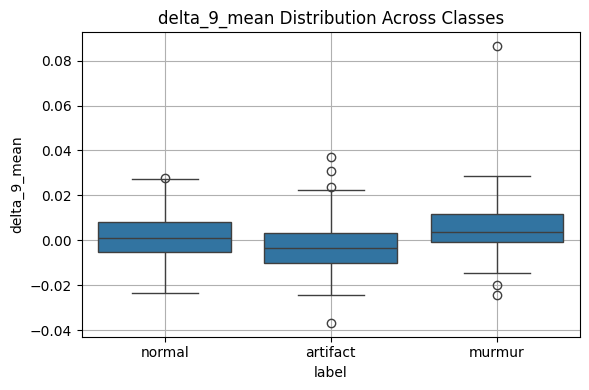

delta_9_mean: p = 0.02975


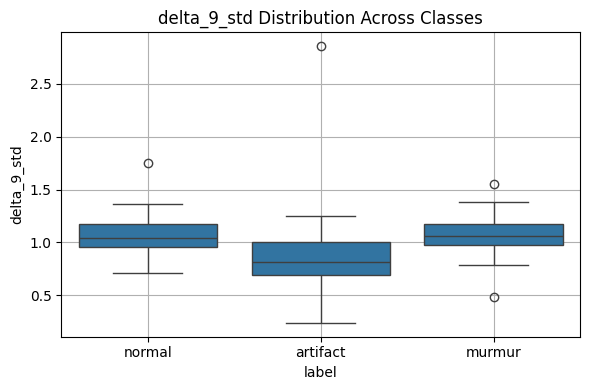

delta_9_std: p = 0.00006


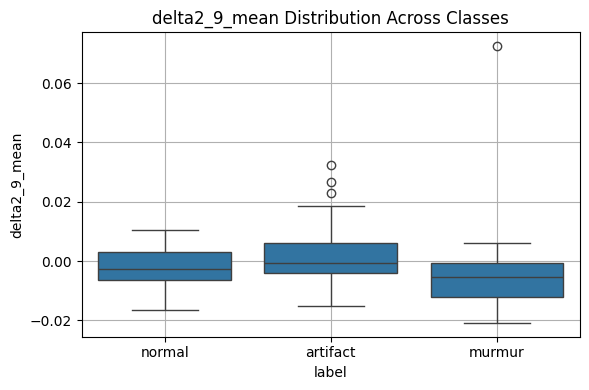

delta2_9_mean: p = 0.00212


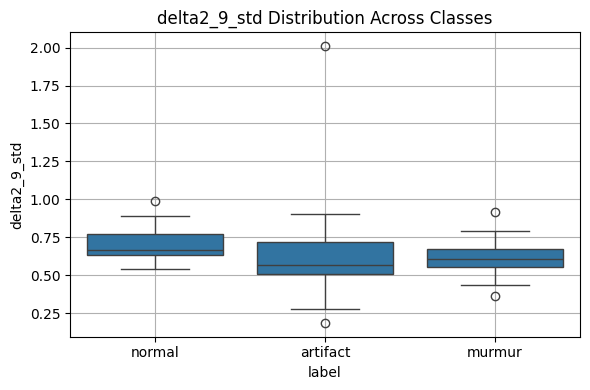

delta2_9_std: p = 0.00113


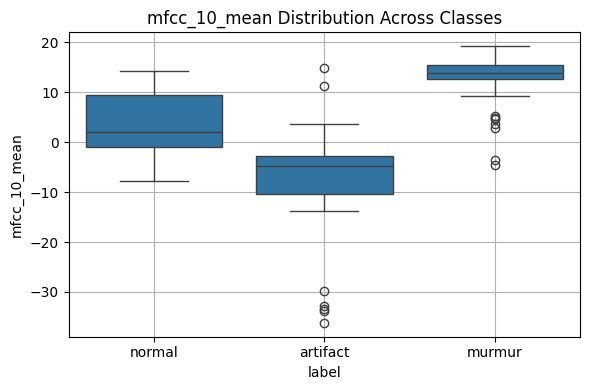

mfcc_10_mean: p = 0.00000


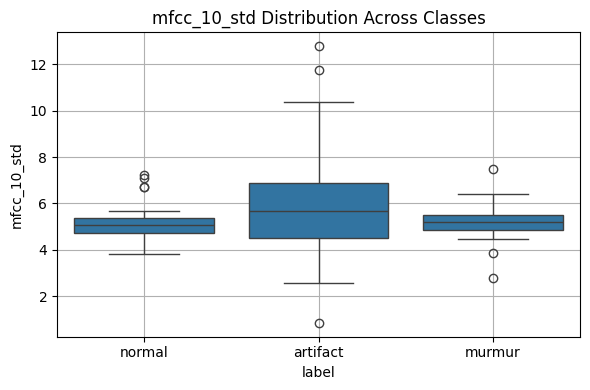

mfcc_10_std: p = 0.25479


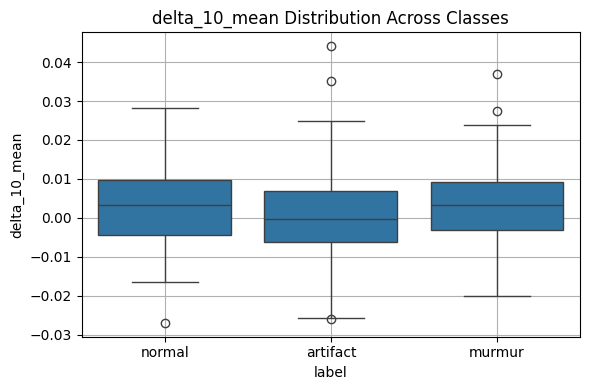

delta_10_mean: p = 0.50919


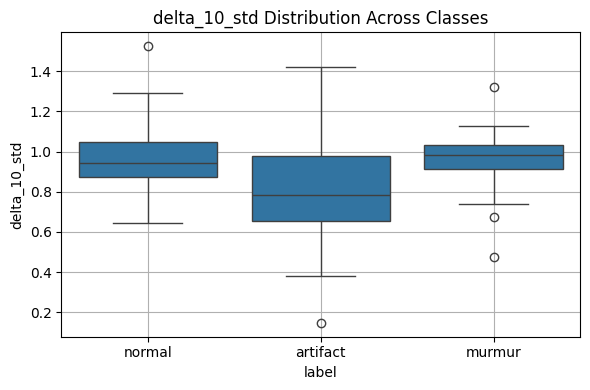

delta_10_std: p = 0.00380


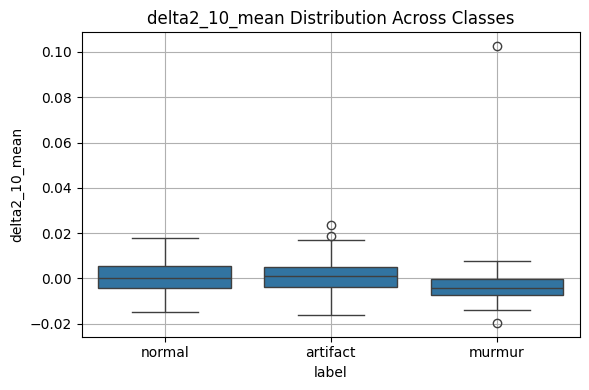

delta2_10_mean: p = 0.00448


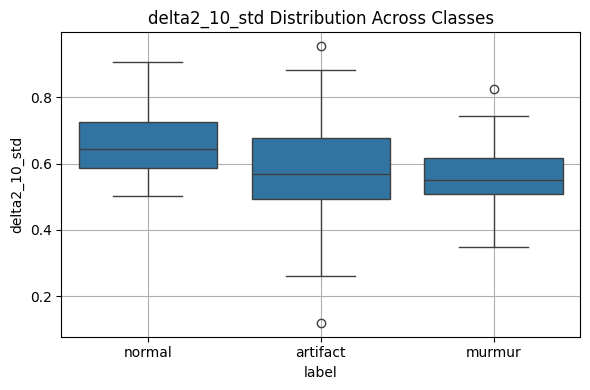

delta2_10_std: p = 0.00435


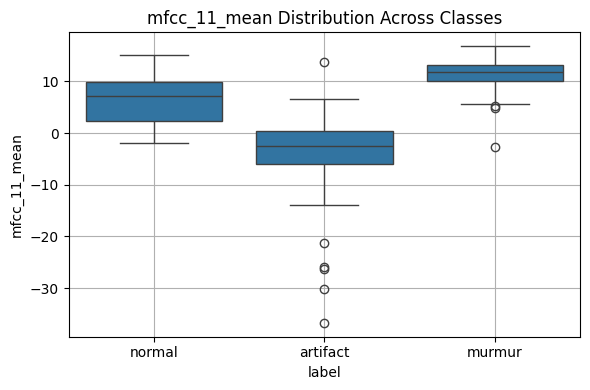

mfcc_11_mean: p = 0.00000


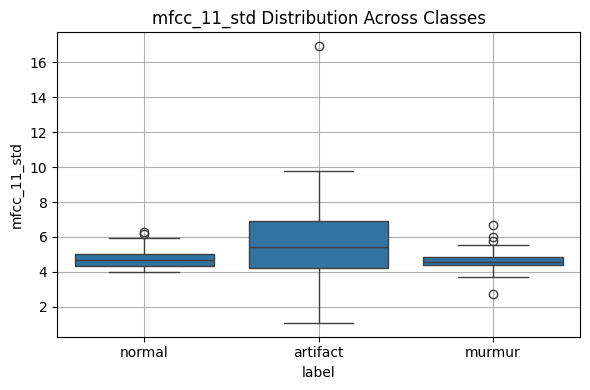

mfcc_11_std: p = 0.10158


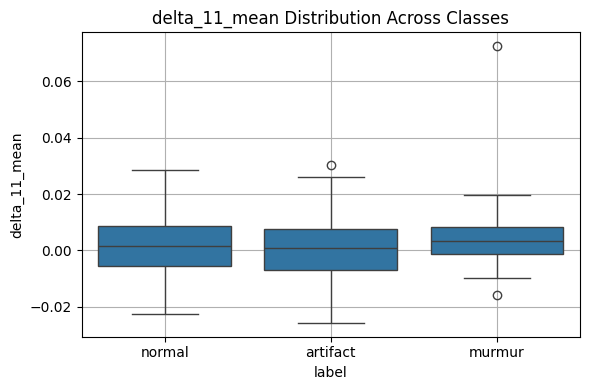

delta_11_mean: p = 0.48228


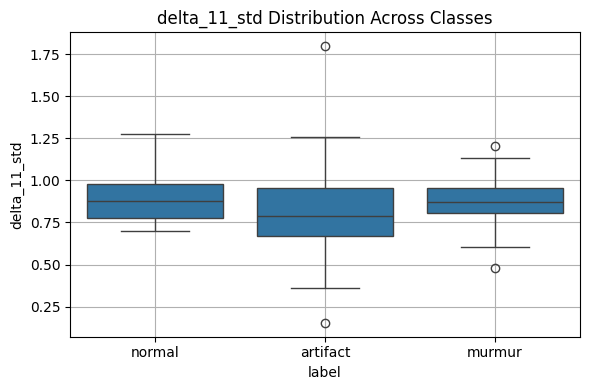

delta_11_std: p = 0.04995


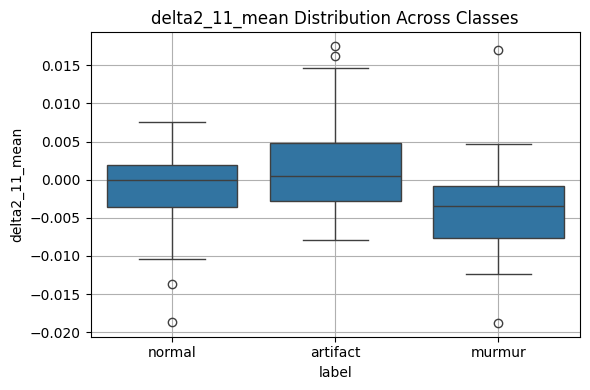

delta2_11_mean: p = 0.00123


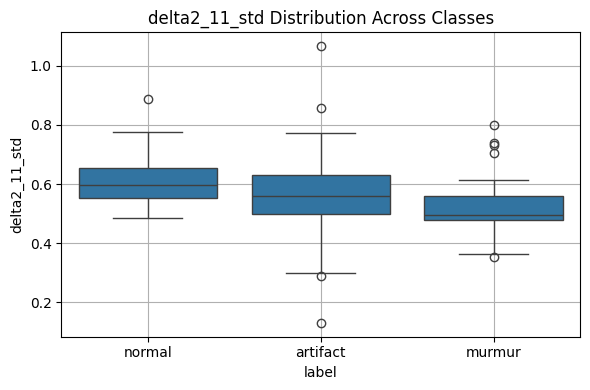

delta2_11_std: p = 0.00031


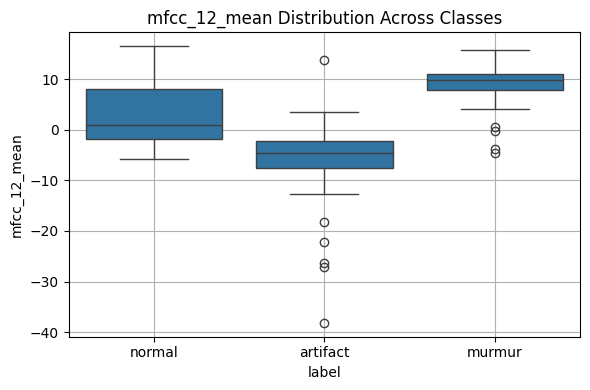

mfcc_12_mean: p = 0.00000


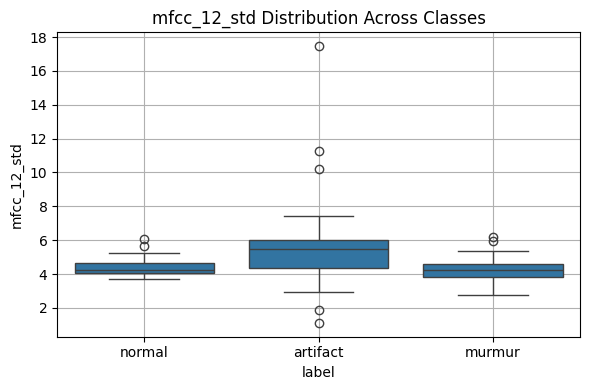

mfcc_12_std: p = 0.00020


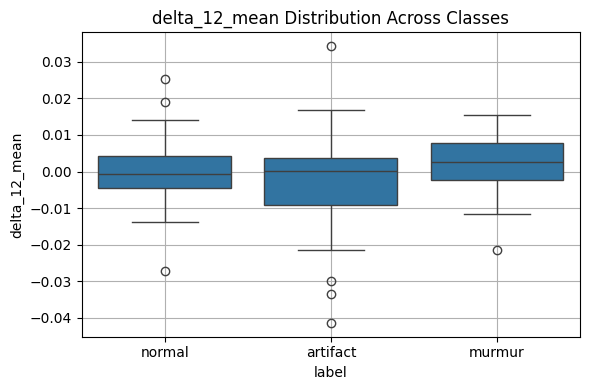

delta_12_mean: p = 0.23119


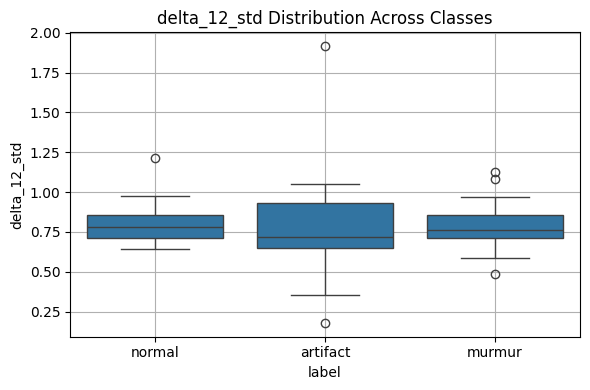

delta_12_std: p = 0.27710


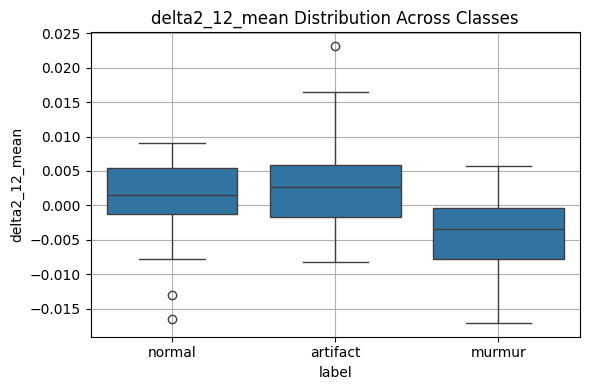

delta2_12_mean: p = 0.00001


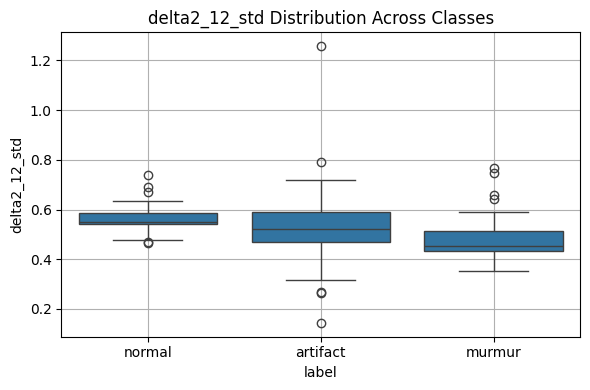

delta2_12_std: p = 0.00034


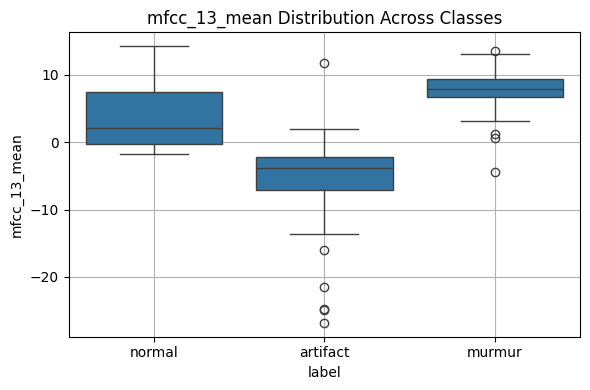

mfcc_13_mean: p = 0.00000


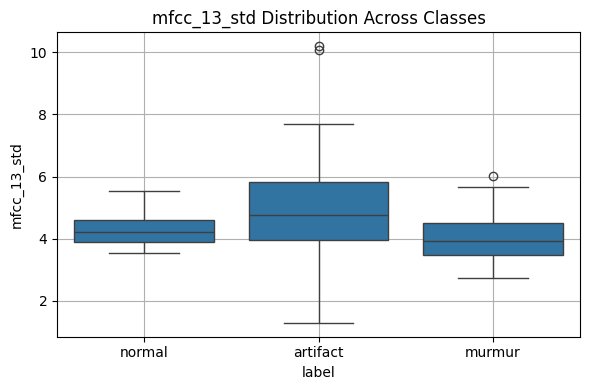

mfcc_13_std: p = 0.00656


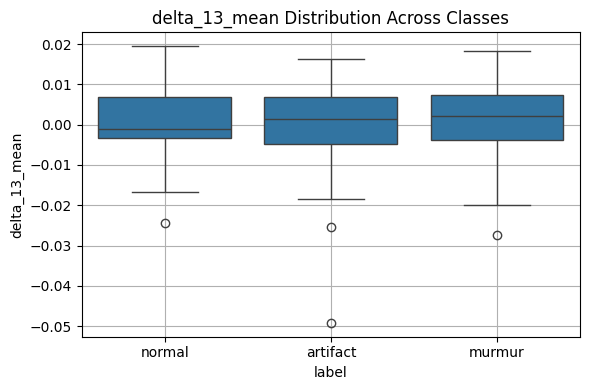

delta_13_mean: p = 0.91642


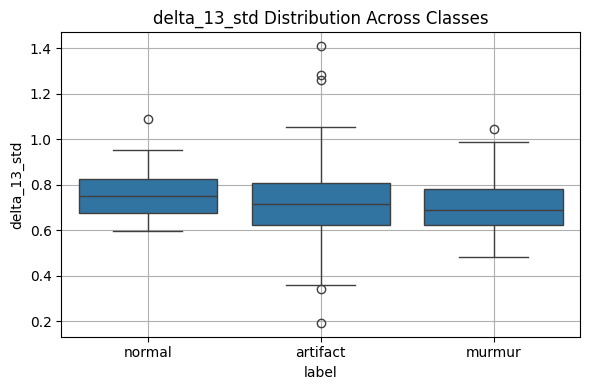

delta_13_std: p = 0.27756


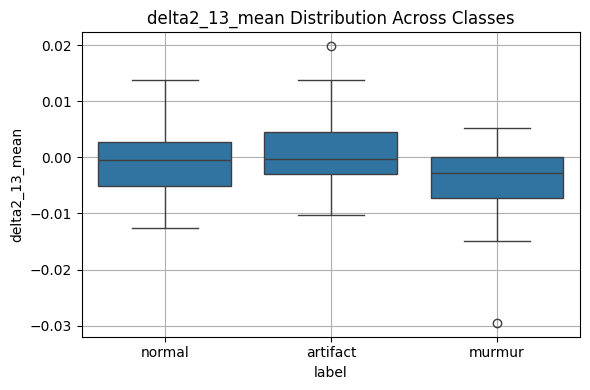

delta2_13_mean: p = 0.01794


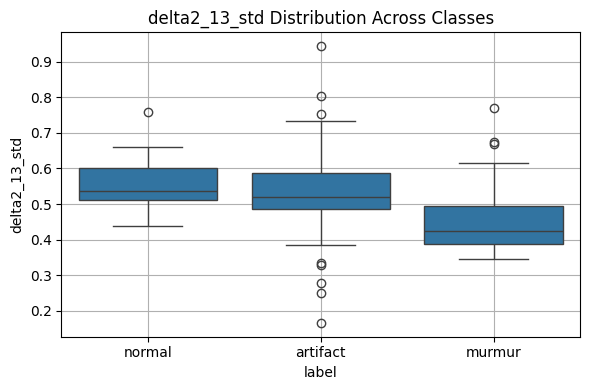

delta2_13_std: p = 0.00011


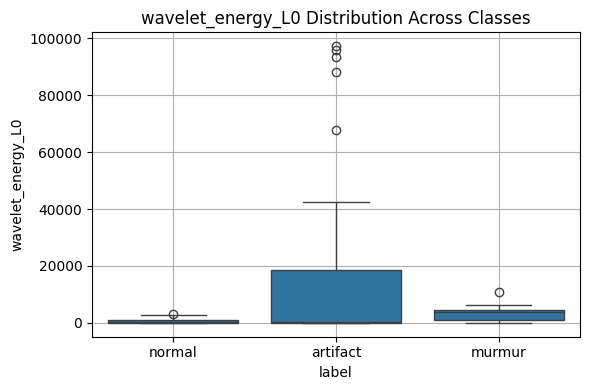

wavelet_energy_L0: p = 0.00121


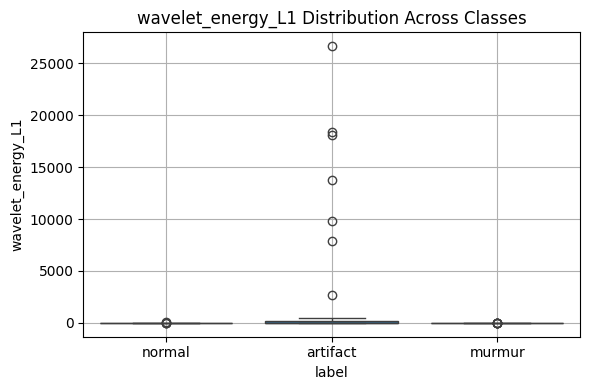

wavelet_energy_L1: p = 0.00000


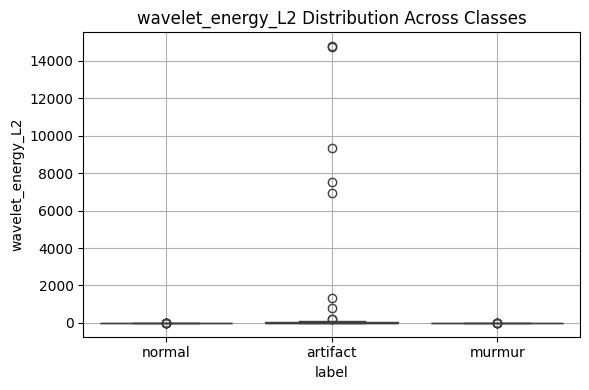

wavelet_energy_L2: p = 0.00000


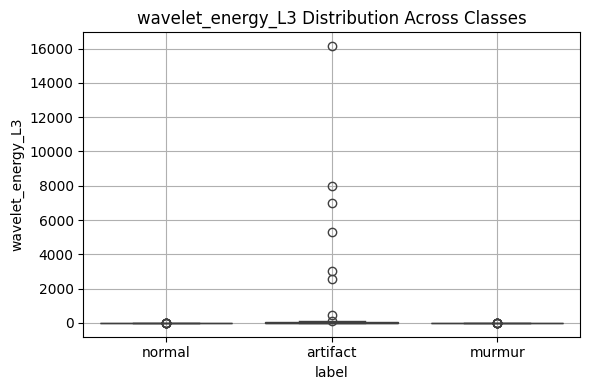

wavelet_energy_L3: p = 0.00000


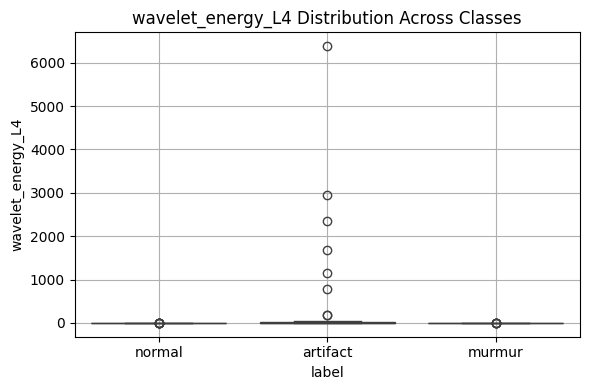

wavelet_energy_L4: p = 0.00000

🔍 Sorted Feature Significance (p-values):
mfcc_6_mean                    p = 1.91745e-16
mfcc_7_mean                    p = 1.11664e-15
mfcc_5_mean                    p = 1.69490e-15
mfcc_13_mean                   p = 5.37762e-15
mfcc_11_mean                   p = 2.13668e-14
mfcc_10_mean                   p = 2.29279e-14
mfcc_8_mean                    p = 3.53549e-14
mfcc_4_mean                    p = 5.36885e-14
mfcc_9_mean                    p = 1.79179e-13
mfcc_12_mean                   p = 4.09207e-13
wavelet_energy_L1              p = 1.93261e-11
mfcc_1_std                     p = 2.06078e-11
wavelet_energy_L2              p = 2.38795e-11
wavelet_energy_L3              p = 1.55274e-10
mean_width                     p = 2.46367e-10
zcr_mean                       p = 3.35524e-10
delta2_6_mean                  p = 9.02255e-09
mean_prominence                p = 1.65853e-08
mfcc_3_mean                    p = 1.81446e-08
wavelet_energy_L4              p 

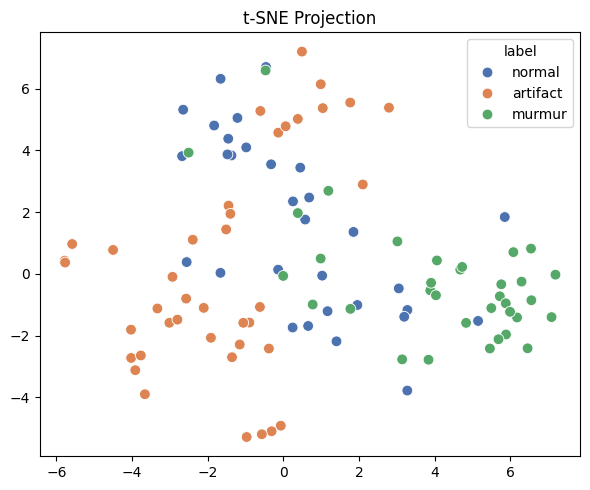

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


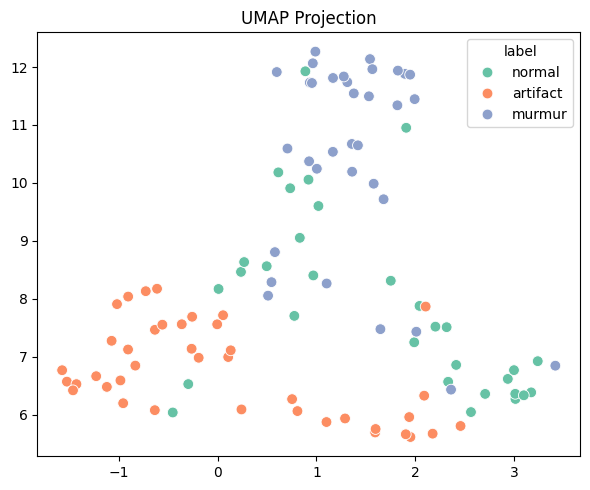

Adjusted Rand Index (KMeans vs True Labels): 0.385


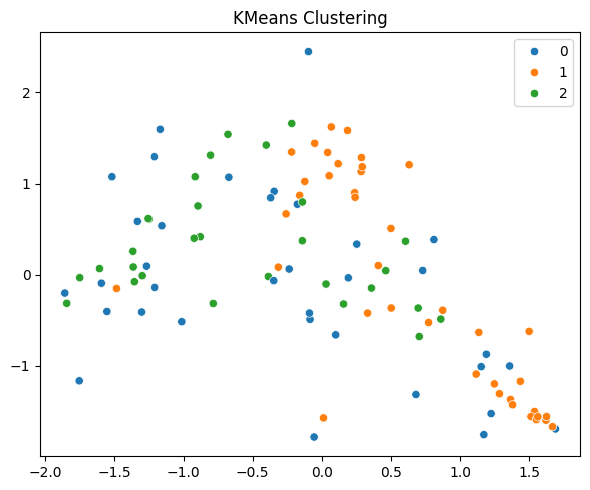

In [ ]:
import os
import numpy as np
np.complex = complex  # Compatibility fix for librosa
import pandas as pd
import librosa
import pywt
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from scipy.signal import find_peaks, hilbert
from scipy.stats import kruskal
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import StandardScaler
import umap
import scikit_posthocs as sp
from scipy.stats import kurtosis

#  Configuration
base_path = '/content/drive/MyDrive/Neurosonic/Data'
class_folders = ['normal', 'artifact', 'murmur']

#  Feature extraction
def get_features(y, sr=44100):
    features = {}

    # # Amplitude stats (from raw signal)
    # mean_amp = np.mean(np.abs(y))
    # std_amp = np.std(y)
    # peak_amp = np.max(np.abs(y))

    # # Add amplitude features to features dictionary for annotation
    # features['mean_amplitude'] = mean_amp
    # features['std_amplitude'] = std_amp
    # features['peak_amplitude'] = peak_amp

    #     # Kurtosis of raw signal or envelope
    # features['kurtosis_raw'] = kurtosis(y)
    # #

    # # Signal "momentum" (e.g., mean of first derivative — very rough idea)
    # features['mean_gradient'] = np.mean(np.diff(y))

    # Hilbert envelope
    hilbert_env = np.abs(hilbert(y))
    hilbert_env /= np.max(hilbert_env)
    threshold = np.mean(hilbert_env) + 0.6 * np.std(hilbert_env)
    min_distance = int(0.25 * sr)

    peaks, props = find_peaks(hilbert_env, height=threshold, distance=min_distance, prominence=0.02, width=10)

    if len(peaks) >= 1:
        features['mean_peak_height'] = np.mean(props['peak_heights'])
        features['std_peak_height'] = np.std(props['peak_heights'])
        features['mean_prominence'] = np.mean(props['prominences'])
        features['std_prominence'] = np.std(props['prominences'])
        features['mean_width'] = np.mean(props['widths'])
        features['std_width'] = np.std(props['widths'])
        if len(peaks) >= 2:
            ipi = np.diff(peaks) / sr
            features['ipi_mean'] = np.mean(ipi)
            features['ipi_std'] = np.std(ipi)
        else:
            features['ipi_mean'] = 0
            features['ipi_std'] = 0
    else:
        for k in ['mean_peak_height', 'std_peak_height', 'mean_prominence', 'std_prominence',
                  'mean_width', 'std_width', 'ipi_mean', 'ipi_std']:
            features[k] = 0

    # Shannon envelope
    energy = y ** 2
    energy[energy == 0] = 1e-10
    shannon = -energy * np.log(energy)
    envelope = np.convolve(shannon, np.ones(int(0.1 * sr)), mode='same')
    envelope /= np.max(envelope)
    features['shannon_mean'] = np.mean(envelope)
    features['shannon_std'] = np.std(envelope)
    features['shannon_peak'] = np.max(envelope)

    # ZCR
    zcr = librosa.feature.zero_crossing_rate(y)[0]
    features['zcr_mean'] = np.mean(zcr)
    features['zcr_std'] = np.std(zcr)

    # MFCCs
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    deltas = librosa.feature.delta(mfccs)
    delta_deltas = librosa.feature.delta(mfccs, order=2)

    for i in range(mfccs.shape[0]):
        features[f'mfcc_{i+1}_mean'] = np.mean(mfccs[i])
        features[f'mfcc_{i+1}_std'] = np.std(mfccs[i])
        features[f'delta_{i+1}_mean'] = np.mean(deltas[i])
        features[f'delta_{i+1}_std'] = np.std(deltas[i])
        features[f'delta2_{i+1}_mean'] = np.mean(delta_deltas[i])
        features[f'delta2_{i+1}_std'] = np.std(delta_deltas[i])

    # Wavelet energy
    coeffs = pywt.wavedec(y, 'db4', level=4)
    for i, c in enumerate(coeffs):
        features[f'wavelet_energy_L{i}'] = np.sum(np.square(c))

    return features

# Feature aggregation
def collect_all_features(base_path, class_folders):
    all_data = []
    for label in class_folders:
        folder = os.path.join(base_path, label)
        for fname in tqdm(os.listdir(folder), desc=label):
            if fname.endswith('.wav'):
                try:
                    fpath = os.path.join(folder, fname)
                    y, sr = librosa.load(fpath, sr=44100)
                    feats = get_features(y, sr)
                    feats['label'] = label
                    feats['file'] = fname
                    all_data.append(feats)
                except Exception as e:
                    print(f"Error: {fname} - {e}")
    return pd.DataFrame(all_data)


# Stats & Visualization

def analyze_features(df):
    results = []
    dunn_results = {}

    for col in [c for c in df.columns if c not in ['label', 'file']]:
        plt.figure(figsize=(6, 4))
        sns.boxplot(x='label', y=col, data=df)
        plt.title(f"{col} Distribution Across Classes")
        plt.grid(True)
        plt.tight_layout()
        plt.show()

        groups = [df[df['label'] == cls][col].dropna() for cls in df['label'].unique()]
        try:
            stat, p = kruskal(*groups)
            print(f"{col}: p = {p:.5f}")
            results.append((col, p))

            if p < 0.05:
                posthoc = sp.posthoc_dunn(df, val_col=col, group_col='label', p_adjust='bonferroni')
                dunn_results[col] = posthoc

        except ValueError as e:
            print(f"{col}: skipped ({e})")

    print("\n🔍 Sorted Feature Significance (p-values):")
    for feature, p_val in sorted(results, key=lambda x: x[1]):
        print(f"{feature:30} p = {p_val:.5e}")

    print("\n📋 Dunn's Post Hoc Test Results (for p < 0.05):")
    for feature, posthoc_df in dunn_results.items():
        print(f"\n▶ Feature: {feature}")
        print(posthoc_df)

    return pd.DataFrame(results, columns=["feature", "p_value"]).sort_values(by="p_value")




#  t-SNE & UMAP
def nonlinear_projection(df):
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    X_scaled = StandardScaler().fit_transform(X)

    # t-SNE
    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X_scaled)
    plt.figure(figsize=(6, 5))
    sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y, palette='deep', s=60)
    plt.title("t-SNE Projection")
    plt.tight_layout()
    plt.show()

    # UMAP
    reducer = umap.UMAP(n_components=2, random_state=42)
    X_umap = reducer.fit_transform(X_scaled)
    plt.figure(figsize=(6, 5))
    sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], hue=y, palette='Set2', s=60)
    plt.title("UMAP Projection")
    plt.tight_layout()
    plt.show()

#  Clustering
def run_kmeans(df):
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    X_scaled = StandardScaler().fit_transform(X)

    kmeans = KMeans(n_clusters=3, random_state=42)
    pred_labels = kmeans.fit_predict(X_scaled)

    ari = adjusted_rand_score(y, pred_labels)
    print(f"Adjusted Rand Index (KMeans vs True Labels): {ari:.3f}")

    plt.figure(figsize=(6, 5))
    sns.scatterplot(x=X_scaled[:, 0], y=X_scaled[:, 1], hue=pred_labels, palette='tab10')
    plt.title("KMeans Clustering")
    plt.tight_layout()
    plt.show()

#  Run Pipeline
df_features = collect_all_features(base_path, class_folders)
analyze_features(df_features)
nonlinear_projection(df_features)
run_kmeans(df_features)


#Key features mentioned in the doc were used to train the network, identified using feature engineering

murmur: 100%|██████████| 35/35 [00:21<00:00,  1.60it/s]



XGBoost Performance


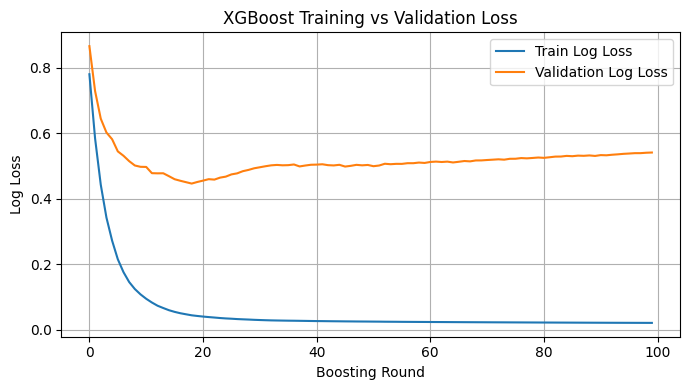

              precision    recall  f1-score   support

    artifact       0.80      1.00      0.89         8
      murmur       0.78      1.00      0.88         7
      normal       1.00      0.33      0.50         6

    accuracy                           0.81        21
   macro avg       0.86      0.78      0.75        21
weighted avg       0.85      0.81      0.77        21

Confusion Matrix:
[[8 0 0]
 [0 7 0]
 [2 2 2]]


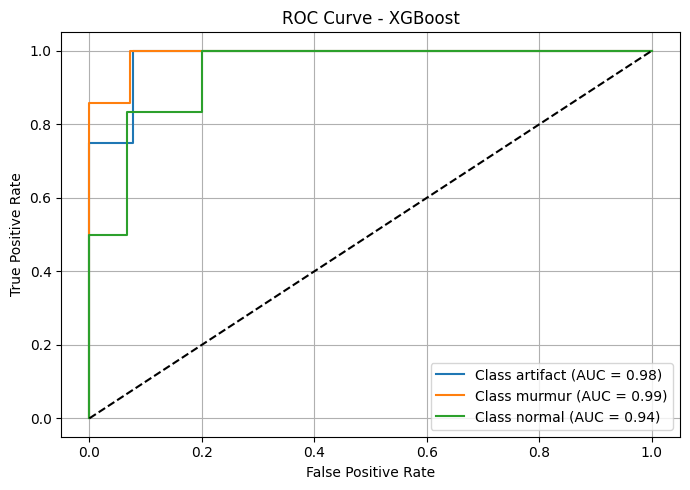

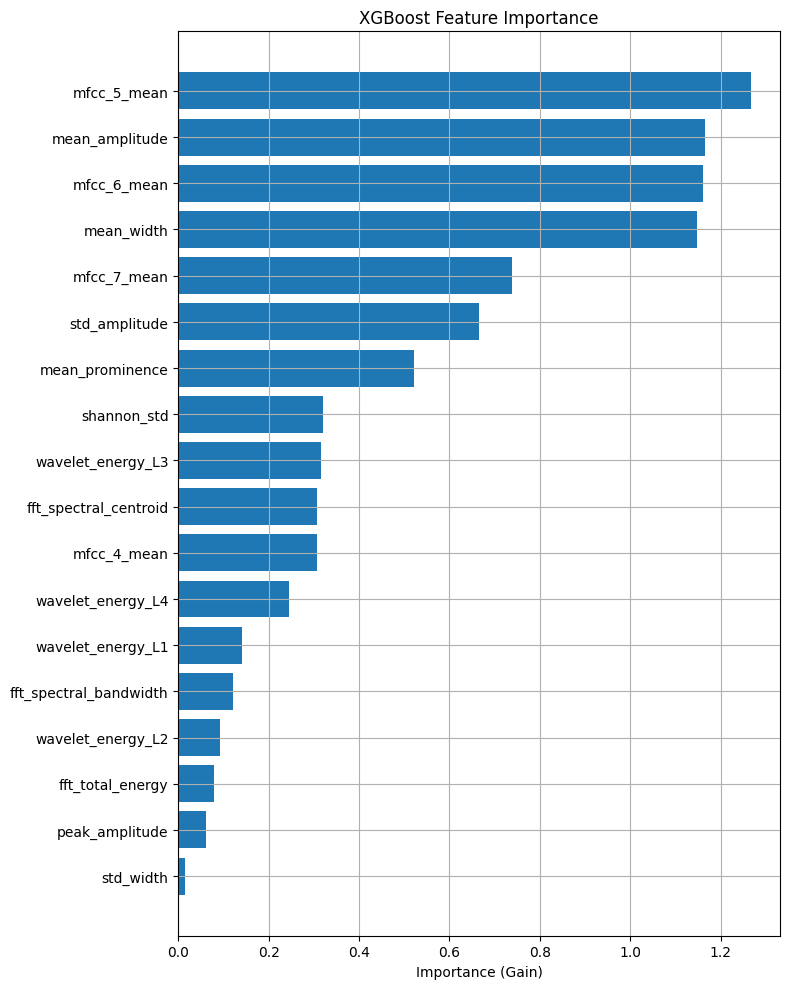

In [ ]:
import os
import numpy as np
import pandas as pd
import librosa
import pywt
from scipy.signal import find_peaks, hilbert
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
from tqdm import tqdm
import xgboost as xgb
import matplotlib.pyplot as plt

# Paths
base_dir = '/content/drive/MyDrive/Neurosonic/Data'
class_folders = ['normal', 'artifact', 'murmur']



# def extract_features(filepath, sr=44100):
#     y, _ = librosa.load(filepath, sr=sr)
#     features = {}

#     # Add amplitude features to features dictionary for annotation
#     # Amplitude stats (from raw signal)
#     mean_amp = np.mean(np.abs(y))
#     std_amp = np.std(y)
#     peak_amp = np.max(np.abs(y))

#     features['mean_amplitude'] = mean_amp
#     features['std_amplitude'] = std_amp
#     features['peak_amplitude'] = peak_amp

#     # Hilbert envelope]]
#     hilbert_env = np.abs(hilbert(y))
#     hilbert_env /= np.max(hilbert_env)
#     threshold = np.mean(hilbert_env) + 0.6 * np.std(hilbert_env)
#     min_distance = int(0.25 * sr)
#     peaks, props = find_peaks(hilbert_env, height=threshold, distance=min_distance, prominence=0.02, width=10)

#     if len(peaks) >= 1:
#         features['mean_prominence'] = np.mean(props['prominences'])
#         features['mean_width'] = np.mean(props['widths'])
#         features['std_width'] = np.std(props['widths'])
#     else:
#         features['mean_prominence'] = 0
#         features['mean_width'] = 0
#         features['std_width'] = 0

#     #  Shannon envelope
#     energy = y ** 2
#     energy[energy == 0] = 1e-10
#     shannon = -energy * np.log(energy)
#     envelope = np.convolve(shannon, np.ones(int(0.1 * sr)), mode='same')
#     envelope /= np.max(envelope)
#     features['shannon_std'] = np.std(envelope)

#     #  MFCCs: Mean of 4, 5, 6, 7
#     mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
#     for i in [3, 4, 5, 6]:
#         features[f'mfcc_{i+1}_mean'] = np.mean(mfccs[i])

#     #  Wavelet Energy: L1 to L4
#     coeffs = pywt.wavedec(y, 'db4', level=4)
#     for i in [1, 2, 3, 4]:
#         features[f'wavelet_energy_L{i}'] = np.sum(np.square(coeffs[i]))

#     return features



from sklearn.decomposition import FastICA

def extract_features(filepath, sr=44100):
    y, _ = librosa.load(filepath, sr=sr)
    features = {}

    # Amplitude stats
    features['mean_amplitude'] = np.mean(np.abs(y))
    features['std_amplitude'] = np.std(y)
    features['peak_amplitude'] = np.max(np.abs(y))

    # Hilbert envelope
    hilbert_env = np.abs(hilbert(y))
    hilbert_env /= np.max(hilbert_env)
    threshold = np.mean(hilbert_env) + 0.6 * np.std(hilbert_env)
    min_distance = int(0.25 * sr)
    peaks, props = find_peaks(hilbert_env, height=threshold, distance=min_distance,
                               prominence=0.02, width=10)

    if len(peaks) >= 1:
        features['mean_prominence'] = np.mean(props['prominences'])
        features['mean_width'] = np.mean(props['widths'])
        features['std_width'] = np.std(props['widths'])
    else:
        features['mean_prominence'] = 0
        features['mean_width'] = 0
        features['std_width'] = 0

    # Shannon envelope
    energy = y ** 2
    energy[energy == 0] = 1e-10
    shannon = -energy * np.log(energy)
    envelope = np.convolve(shannon, np.ones(int(0.1 * sr)), mode='same')
    envelope /= np.max(envelope)
    features['shannon_std'] = np.std(envelope)

    # MFCCs (coefficients 4–7)
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    for i in [3, 4, 5, 6]:
        features[f'mfcc_{i+1}_mean'] = np.mean(mfccs[i])

    # Wavelet Energy (levels 1 to 4)
    coeffs = pywt.wavedec(y, 'db4', level=4)
    for i in [1, 2, 3, 4]:
        features[f'wavelet_energy_L{i}'] = np.sum(np.square(coeffs[i]))

    # FFT-based features
    fft_vals = np.abs(np.fft.rfft(y))
    fft_freqs = np.fft.rfftfreq(len(y), 1/sr)

    total_energy = np.sum(fft_vals)
    spectral_centroid = np.sum(fft_freqs * fft_vals) / total_energy
    spectral_bandwidth = np.sqrt(np.sum(((fft_freqs - spectral_centroid) ** 2) * fft_vals) / total_energy)

    features['fft_spectral_centroid'] = spectral_centroid
    features['fft_spectral_bandwidth'] = spectral_bandwidth
    features['fft_total_energy'] = total_energy

    # ICA-based features
    try:
        Y = y.reshape(-1, 1)
        if len(Y) >= 20:  # Require enough samples
            ica = FastICA(n_components=1, random_state=42)
            S = ica.fit_transform(Y).flatten()
            features['ica_kurtosis'] = kurtosis(S)
            features['ica_std'] = np.std(S)
        else:
            features['ica_kurtosis'] = 0
            features['ica_std'] = 0
    except Exception as e:
        features['ica_kurtosis'] = 0
        features['ica_std'] = 0

    return features



# Build dataset
def build_dataset():
    all_data = []
    for label in class_folders:
        folder_path = os.path.join(base_dir, label)
        for fname in tqdm(os.listdir(folder_path), desc=label):
            if fname.endswith('.wav'):
                try:
                    fpath = os.path.join(folder_path, fname)
                    feats = extract_features(fpath)
                    feats['label'] = label
                    feats['file'] = fname
                    all_data.append(feats)
                except Exception as e:
                    print(f" Error with file {fname}: {e}")
    return pd.DataFrame(all_data)

# Train and evaluate
def train_and_evaluate(df):
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    y_bin = label_binarize(y_encoded, classes=np.unique(y_encoded))

    X_train, X_test, y_train, y_test = train_test_split(
        X, y_encoded, stratify=y_encoded, test_size=0.2, random_state=42
    )
    y_test_bin = label_binarize(y_test, classes=np.unique(y_encoded))


    # XGBoost using low-level API
    print("\nXGBoost Performance")
    dtrain = xgb.DMatrix(X_train, label=y_train)
    dtest = xgb.DMatrix(X_test, label=y_test)
    evals_result = {}

    params = {
        'objective': 'multi:softprob',
        'num_class': len(np.unique(y_train)),
        'eval_metric': 'mlogloss',
        'seed': 42
    }

    booster = xgb.train(
        params,
        dtrain,
        num_boost_round=100,
        evals=[(dtrain, 'train'), (dtest, 'validation')],
        evals_result=evals_result,
        verbose_eval=False
    )

    train_loss = evals_result['train']['mlogloss']
    val_loss = evals_result['validation']['mlogloss']

    plt.figure(figsize=(7, 4))
    plt.plot(train_loss, label='Train Log Loss')
    plt.plot(val_loss, label='Validation Log Loss')
    plt.xlabel("Boosting Round")
    plt.ylabel("Log Loss")
    plt.title("XGBoost Training vs Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    y_prob_xgb = booster.predict(dtest)
    y_pred_xgb = np.argmax(y_prob_xgb, axis=1)

    print(classification_report(le.inverse_transform(y_test), le.inverse_transform(y_pred_xgb)))
    print("Confusion Matrix:")
    print(confusion_matrix(le.inverse_transform(y_test), le.inverse_transform(y_pred_xgb)))

    plt.figure(figsize=(7, 5))
    for i in range(y_bin.shape[1]):
        fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_prob_xgb[:, i])
        auc_score = roc_auc_score(y_test_bin[:, i], y_prob_xgb[:, i])
        plt.plot(fpr, tpr, label=f"Class {le.inverse_transform([i])[0]} (AUC = {auc_score:.2f})")
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve - XGBoost")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

        # Feature importance plot
    importance = booster.get_score(importance_type='gain')
    importance = dict(sorted(importance.items(), key=lambda item: item[1], reverse=True))

    sorted_features = sorted(importance.items(), key=lambda x: x[1], reverse=True)

    plt.figure(figsize=(8, 10))
    plt.barh([k for k, _ in sorted_features], [v for _, v in sorted_features])
    plt.xlabel("Importance (Gain)")
    plt.title("XGBoost Feature Importance")
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.grid(True)
    plt.show()


# Run pipeline
df_features = build_dataset()
train_and_evaluate(df_features)


# Optuna to tune for maximizing weighted F1 score-, lowering log loss, by tuning max depth of the tree, subsample (% data seen by each tree), colsample (% of features seen by each tree), l1 and l2 regularization

In [ ]:
import optuna
import xgboost as xgb
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import f1_score

# Cached dataset to avoid reloading
cached_df = None

def objective(trial):
    global cached_df
    if cached_df is None:
        cached_df = build_dataset()

    df = cached_df.copy()
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)

    X_train, X_test, y_train, y_test = train_test_split(
        X, y_encoded, stratify=y_encoded, test_size=0.2, random_state=42
    )

    dtrain = xgb.DMatrix(X_train, label=y_train)
    dtest = xgb.DMatrix(X_test, label=y_test)

    params = {
        'objective': 'multi:softprob',
        'num_class': len(np.unique(y_encoded)),
        'eval_metric': 'mlogloss',
        'max_depth': trial.suggest_int('max_depth', 3, 20),
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.3, log=True),
        'subsample': trial.suggest_float('subsample', 0.6, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 10.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.1, 10.0),
        'seed': 42
    }

    model = xgb.train(
        params=params,
        dtrain=dtrain,
        num_boost_round=1000,
        evals=[(dtest, 'eval')],
        early_stopping_rounds=200,
        verbose_eval=False
    )

    y_prob = model.predict(dtest)
    y_pred = np.argmax(y_prob, axis=1)

    f1 = f1_score(y_test, y_pred, average='weighted')
    return f1  # Optuna will maximize this

# Run optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=2000)

# Best Params
print(" Best Parameters:")
print(study.best_params)
print(f"\n Best Weighted Avg F1 Score: {study.best_value:.4f}")


[I 2025-06-17 03:17:04,689] A new study created in memory with name: no-name-ccaf20ad-c0b5-4321-9c89-7501eefaa6db
murmur: 100%|██████████| 35/35 [00:18<00:00,  1.94it/s]
[I 2025-06-17 03:18:05,497] Trial 0 finished with value: 0.6947667956071317 and parameters: {'max_depth': 9, 'learning_rate': 0.019636414421395035, 'subsample': 0.853384313337429, 'colsample_bytree': 0.7158014120704645, 'reg_alpha': 7.857271568257545, 'reg_lambda': 3.6615785963612923}. Best is trial 0 with value: 0.6947667956071317.
[I 2025-06-17 03:18:05,593] Trial 1 finished with value: 0.6947667956071317 and parameters: {'max_depth': 5, 'learning_rate': 0.01934311712656602, 'subsample': 0.9403629234303597, 'colsample_bytree': 0.777106850116119, 'reg_alpha': 7.205152175010879, 'reg_lambda': 9.661572714131468}. Best is trial 0 with value: 0.6947667956071317.
[I 2025-06-17 03:18:05,700] Trial 2 finished with value: 0.66005291005291 and parameters: {'max_depth': 10, 'learning_rate': 0.0012718231329045258, 'subsample': 0

 Best Parameters:
{'max_depth': 7, 'learning_rate': 0.08317073929332496, 'subsample': 0.9829052468491255, 'colsample_bytree': 0.9881992353244955, 'reg_alpha': 1.5806240056351224, 'reg_lambda': 6.460726753741641}

 Best Weighted Avg F1 Score: 0.7731


# Objective 2: Use the tuned params to get the final results



murmur: 100%|██████████| 35/35 [00:21<00:00,  1.63it/s]



Evaluating at Boosting Round: 13
Train Loss: 0.0703, Validation Loss: 0.4273

XGBoost Classification Report:
              precision    recall  f1-score   support

    artifact       0.89      1.00      0.94         8
      murmur       0.70      1.00      0.82         7
      normal       1.00      0.33      0.50         6

    accuracy                           0.81        21
   macro avg       0.86      0.78      0.75        21
weighted avg       0.86      0.81      0.78        21

Confusion Matrix:
[[8 0 0]
 [0 7 0]
 [1 3 2]]


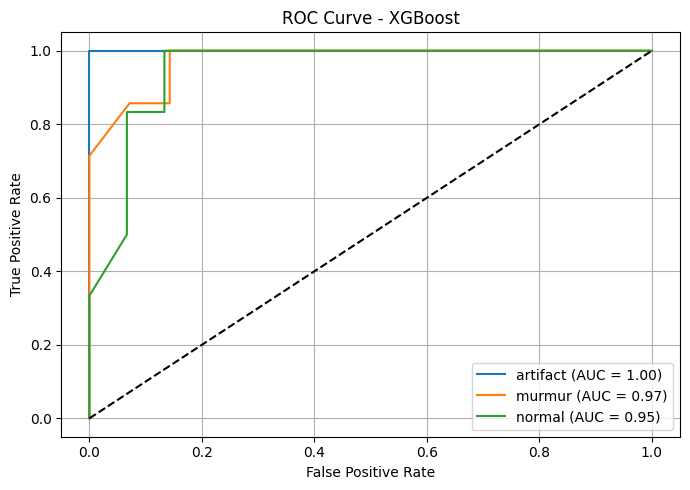

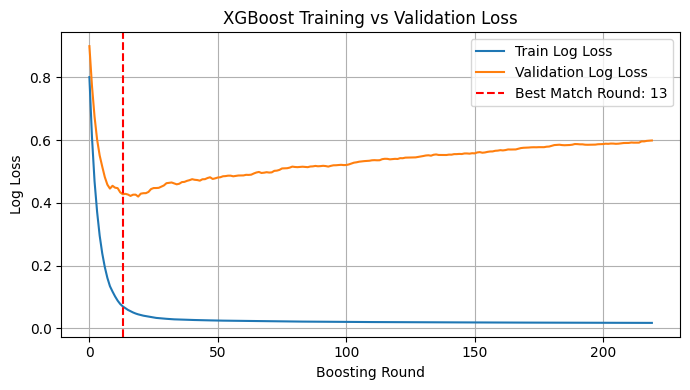

In [ ]:



# Train and evaluate using xgb.train
def train_and_evaluate(df):
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    y_bin = label_binarize(y_encoded, classes=np.unique(y_encoded))

    X_train, X_test, y_train, y_test = train_test_split(
        X, y_encoded, stratify=y_encoded, test_size=0.2, random_state=42
    )
    y_test_bin = label_binarize(y_test, classes=np.unique(y_encoded))

    dtrain = xgb.DMatrix(X_train, label=y_train)
    dtest = xgb.DMatrix(X_test, label=y_test)

    params = {
        'objective': 'multi:softprob',
        'num_class': len(np.unique(y_encoded)),
        'eval_metric': 'mlogloss',
        'max_depth': 16,
        'learning_rate': 0.277,
        'subsample': 0.941,
        'colsample_bytree': 0.74,
        'reg_alpha': 0.016,
        'reg_lambda': 0.59,
        'seed': 42
    }

    evals_result = {}
    model = xgb.train(
        params=params,
        dtrain=dtrain,
        num_boost_round=3000,
        evals=[(dtrain, 'train'), (dtest, 'validation')],
        early_stopping_rounds=200,
        evals_result=evals_result,
        verbose_eval=False
    )

    train_loss = evals_result['train']['mlogloss']
    val_loss = evals_result['validation']['mlogloss']
    loss_diff = [abs(tr - va) for tr, va in zip(train_loss, val_loss)]
    val_min = min(val_loss)
    candidates = [
        i for i in range(len(val_loss))
        if abs(val_loss[i] - val_min) < 0.01  # near best val loss
    ]
    if candidates:
        best_closeness_round = min(candidates, key=lambda i: abs(train_loss[i] - val_loss[i]))
    else:
        best_closeness_round = np.argmin(loss_diff)

    # Use best_closeness_round for prediction
    y_prob = model.predict(dtest, iteration_range=(best_closeness_round, best_closeness_round + 1))
    y_pred = np.argmax(y_prob, axis=1)

    print(f"\nEvaluating at Boosting Round: {best_closeness_round}")
    print(f"Train Loss: {train_loss[best_closeness_round]:.4f}, Validation Loss: {val_loss[best_closeness_round]:.4f}")
    print("\nXGBoost Classification Report:")
    print(classification_report(y_test, y_pred, target_names=le.classes_))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))

    # ROC Curve
    plt.figure(figsize=(7, 5))
    for i in range(y_bin.shape[1]):
        fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
        auc_score = roc_auc_score(y_test_bin[:, i], y_prob[:, i])
        plt.plot(fpr, tpr, label=f"{le.inverse_transform([i])[0]} (AUC = {auc_score:.2f})")
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve - XGBoost")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Loss curves
    plt.figure(figsize=(7, 4))
    plt.plot(train_loss, label='Train Log Loss')
    plt.plot(val_loss, label='Validation Log Loss')
    plt.axvline(best_closeness_round, color='red', linestyle='--', label=f'Best Match Round: {best_closeness_round}')
    plt.xlabel("Boosting Round")
    plt.ylabel("Log Loss")
    plt.title("XGBoost Training vs Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Run
df_features = build_dataset()
train_and_evaluate(df_features)


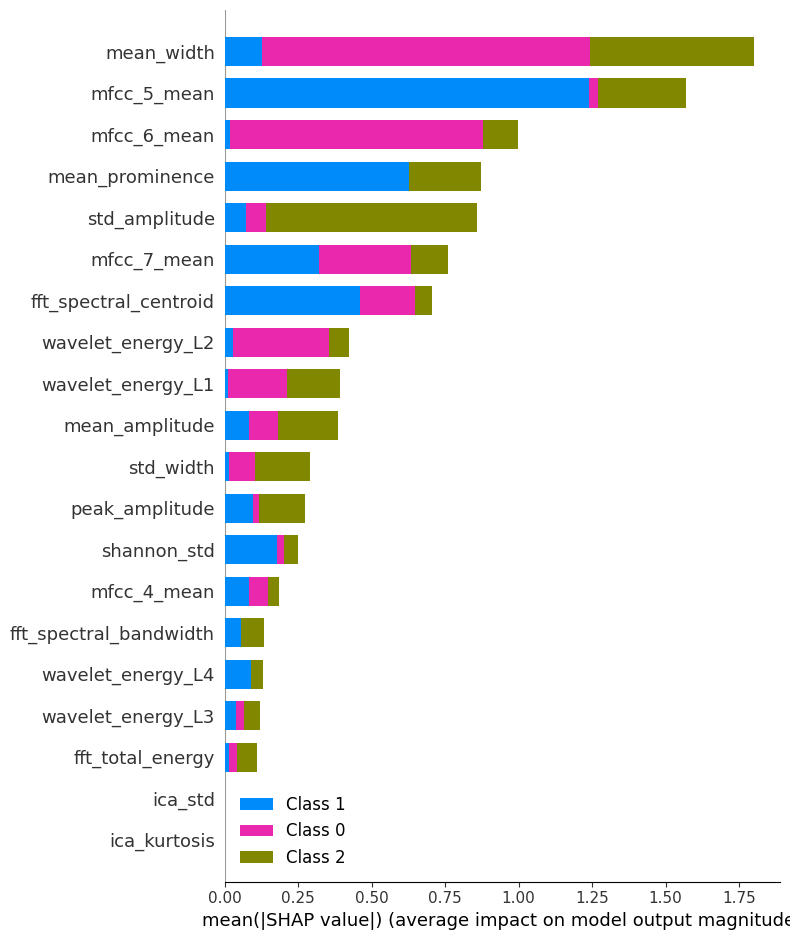

In [ ]:
import shap
import xgboost as xgb
import matplotlib.pyplot as plt

# Load data for SHAP interpretation
X = df_features.drop(columns=['label', 'file'])
y = df_features['label']
le = LabelEncoder()
y_encoded = le.fit_transform(y)

# Split and train the model for SHAP (reusing best_closeness_round)
X_train, X_test, y_train, y_test = train_test_split(
    X, y_encoded, stratify=y_encoded, test_size=0.2, random_state=42
)

dtrain = xgb.DMatrix(X_train, label=y_train)

# Train model briefly for SHAP illustration
params = {
    'objective': 'multi:softprob',
    'num_class': len(np.unique(y_encoded)),
    'eval_metric': 'mlogloss',
    'max_depth': 16,
    'learning_rate': 0.277,
    'subsample': 0.941,
    'colsample_bytree': 0.74,
    'reg_alpha': 0.016,
    'reg_lambda': 0.59,
    'seed': 42
}
model = xgb.train(params, dtrain, num_boost_round=50)

# SHAP explainer and summary plot
explainer = shap.Explainer(model)
shap_values = explainer(X_train)

# Plot summary
shap.summary_plot(shap_values, X_train, show=False)
plt.tight_layout()
plt.show()


murmur: 100%|██████████| 35/35 [00:19<00:00,  1.81it/s]


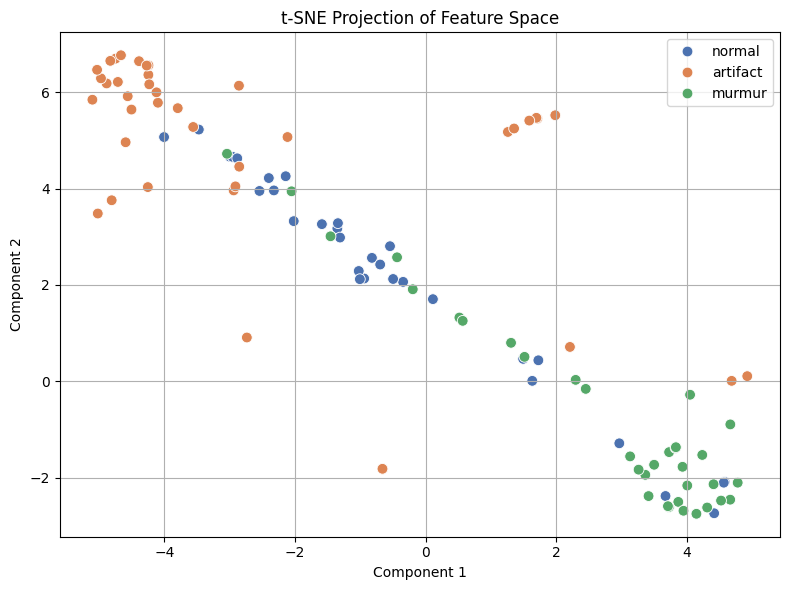


Evaluating at Boosting Round: 10
Train Loss: 0.1045, Validation Loss: 0.5190

XGBoost Classification Report:
              precision    recall  f1-score   support

    artifact       0.80      1.00      0.89         8
      murmur       0.86      0.86      0.86         7
      normal       0.75      0.50      0.60         6

    accuracy                           0.81        21
   macro avg       0.80      0.79      0.78        21
weighted avg       0.80      0.81      0.80        21

Confusion Matrix:
[[8 0 0]
 [0 6 1]
 [2 1 3]]


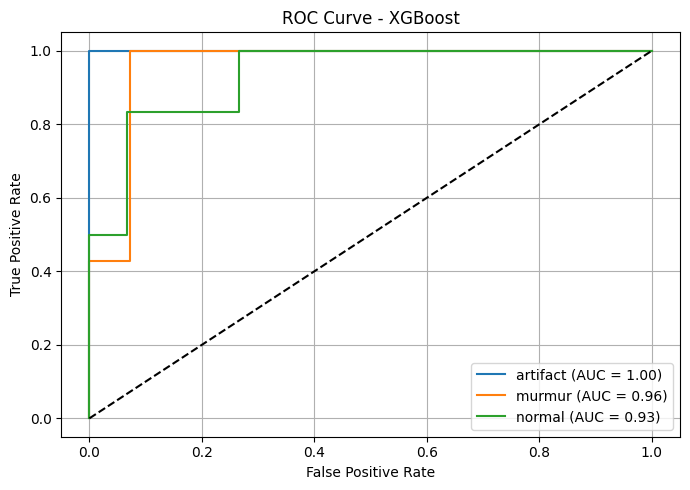

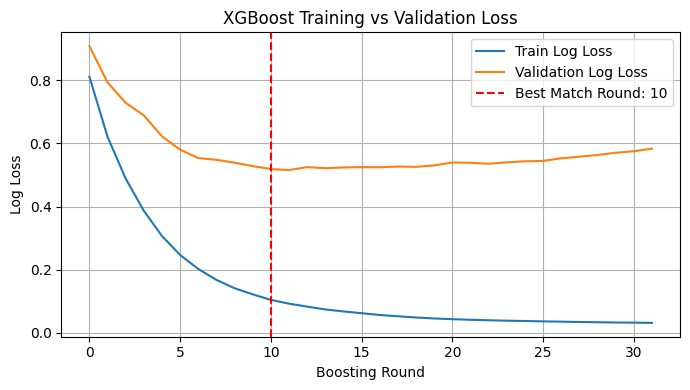

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import librosa
import pywt
from scipy.signal import hilbert, find_peaks
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, roc_auc_score
from sklearn.manifold import TSNE
import xgboost as xgb

# --- Feature Extraction ---
def extract_features(filepath, sr=44100):
    y, _ = librosa.load(filepath, sr=sr)
    features = {}

    # Amplitude stats
    features['mean_amplitude'] = np.mean(np.abs(y))
    features['std_amplitude'] = np.std(y)
    features['peak_amplitude'] = np.max(np.abs(y))

    # Hilbert envelope
    hilbert_env = np.abs(hilbert(y))
    hilbert_env /= np.max(hilbert_env)
    threshold = np.mean(hilbert_env) + 0.6 * np.std(hilbert_env)
    min_distance = int(0.25 * sr)
    peaks, props = find_peaks(hilbert_env, height=threshold, distance=min_distance, prominence=0.02, width=10)
    if len(peaks) >= 1:
        features['mean_prominence'] = np.mean(props['prominences'])
        features['mean_width'] = np.mean(props['widths'])
        features['std_width'] = np.std(props['widths'])
    else:
        features['mean_prominence'] = 0
        features['mean_width'] = 0
        features['std_width'] = 0

    # Shannon envelope
    energy = y ** 2
    energy[energy == 0] = 1e-10
    shannon = -energy * np.log(energy)
    envelope = np.convolve(shannon, np.ones(int(0.1 * sr)), mode='same')
    envelope /= np.max(envelope)
    features['shannon_std'] = np.std(envelope)

    # MFCCs: Mean of 4th to 7th coefficients (index 3–6)
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    for i in [3, 4, 5, 6]:
        features[f'mfcc_{i+1}_mean'] = np.mean(mfccs[i])

    # Wavelet Energy: L1 to L4
    coeffs = pywt.wavedec(y, 'db4', level=4)
    for i in [1, 2, 3, 4]:
        features[f'wavelet_energy_L{i}'] = np.sum(np.square(coeffs[i]))

    return features

# --- Build Dataset ---
base_dir = '/content/drive/MyDrive/Neurosonic/Data'
class_folders = ["normal", "artifact", "murmur"]

def build_dataset():
    all_data = []
    for label in class_folders:
        folder_path = os.path.join(base_dir, label)
        for fname in tqdm(os.listdir(folder_path), desc=label):
            if fname.endswith('.wav'):
                try:
                    fpath = os.path.join(folder_path, fname)
                    feats = extract_features(fpath)
                    feats['label'] = label
                    feats['file'] = fname
                    all_data.append(feats)
                except Exception as e:
                    print(f"Error with file {fname}: {e}")
    return pd.DataFrame(all_data)

# --- t-SNE Visualization ---
def plot_tsne(df):
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(X)
    tsne_df = pd.DataFrame({'tsne-1': X_tsne[:, 0], 'tsne-2': X_tsne[:, 1], 'label': y})
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=tsne_df, x='tsne-1', y='tsne-2', hue='label', palette='deep', s=60)
    plt.title("t-SNE Projection of Feature Space")
    plt.xlabel("Component 1")
    plt.ylabel("Component 2")
    plt.legend(loc='best')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# --- XGBoost Training + Evaluation ---
def train_and_evaluate(df):
    X = df.drop(columns=['label', 'file'])
    y = df['label']
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    y_bin = label_binarize(y_encoded, classes=np.unique(y_encoded))

    X_train, X_test, y_train, y_test = train_test_split(
        X, y_encoded, stratify=y_encoded, test_size=0.2, random_state=42
    )
    y_test_bin = label_binarize(y_test, classes=np.unique(y_encoded))

    dtrain = xgb.DMatrix(X_train, label=y_train)
    dtest = xgb.DMatrix(X_test, label=y_test)

    params = {
        'objective': 'multi:softprob',
        'num_class': len(np.unique(y_encoded)),
        'eval_metric': 'mlogloss',
        'max_depth': 16,
        'learning_rate': 0.277,
        'subsample': 0.941,
        'colsample_bytree': 0.74,
        'reg_alpha': 0.016,
        'reg_lambda': 0.59,
        'seed': 42
    }

    evals_result = {}
    model = xgb.train(
        params=params,
        dtrain=dtrain,
        num_boost_round=2000,
        evals=[(dtrain, 'train'), (dtest, 'validation')],
        early_stopping_rounds=20,
        evals_result=evals_result,
        verbose_eval=False
    )

    train_loss = evals_result['train']['mlogloss']
    val_loss = evals_result['validation']['mlogloss']
    loss_diff = [abs(tr - va) for tr, va in zip(train_loss, val_loss)]
    val_min = min(val_loss)
    candidates = [i for i in range(len(val_loss)) if abs(val_loss[i] - val_min) < 0.01]
    best_closeness_round = (
        min(candidates, key=lambda i: abs(train_loss[i] - val_loss[i]))
        if candidates else np.argmin(loss_diff)
    )

    y_prob = model.predict(dtest, iteration_range=(best_closeness_round, best_closeness_round + 1))
    y_pred = np.argmax(y_prob, axis=1)

    print(f"\nEvaluating at Boosting Round: {best_closeness_round}")
    print(f"Train Loss: {train_loss[best_closeness_round]:.4f}, Validation Loss: {val_loss[best_closeness_round]:.4f}")
    print("\nXGBoost Classification Report:")
    print(classification_report(y_test, y_pred, target_names=le.classes_))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))

    # ROC Curve
    plt.figure(figsize=(7, 5))
    for i in range(y_bin.shape[1]):
        fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
        auc_score = roc_auc_score(y_test_bin[:, i], y_prob[:, i])
        plt.plot(fpr, tpr, label=f"{le.inverse_transform([i])[0]} (AUC = {auc_score:.2f})")
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve - XGBoost")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Loss curves
    plt.figure(figsize=(7, 4))
    plt.plot(train_loss, label='Train Log Loss')
    plt.plot(val_loss, label='Validation Log Loss')
    plt.axvline(best_closeness_round, color='red', linestyle='--', label=f'Best Match Round: {best_closeness_round}')
    plt.xlabel("Boosting Round")
    plt.ylabel("Log Loss")
    plt.title("XGBoost Training vs Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# --- Main execution ---
df_features = build_dataset()
plot_tsne(df_features)
train_and_evaluate(df_features)
